# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:02, 69.2MB/s]                            
SVHN Training Set: 64.3MB [00:01, 54.8MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

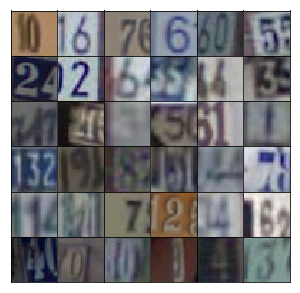

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), self.scaler(y)

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        
        """
        MW Notes:
        bias should be handled by batch_normalization offset variable, but left in based on the solution video
        truncated the network to start at 4, 4, 512, also per solution video
        """  
        
            leaky_relu = lambda x : tf.maximum(alpha * x, x)
            norm_and_leaky_relu = lambda x : leaky_relu(tf.layers.batch_normalization(x, training=training))        
       
        
        de_conv = lambda x, flt : tf.layers.conv2d_transpose(x, filters = flt, kernel_size= (5, 5), 
                                                               strides=(2, 2), padding = 'same', 
                                                               use_bias=True, activation=None) 
        


        #per the lesson used 
        fc = tf.layers.dense(z, 4 * 4* 512, activation=None, use_bias=True)
        fc = tf.reshape(fc, (-1, 4, 4, 512))
        fc = norm_and_leaky_relu(fc)
        #print(fc)

        c1 = norm_and_leaky_relu(de_conv(fc, 256))
        #print(c1)

        c2 = norm_and_leaky_relu(de_conv(c1, 128))
        #print(c2)

        # Output layer, 32x32x3
        logits = de_conv(c2, 3)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        """
        MW Notes:
        per the solution video, didnt use batch norm on the first layer
        per the solution video used a deeper model (64, 128, 256) and left kernel at size 5, 5
        does not take training variable, always left on
        """
        
        leaky_relu = lambda x : tf.maximum(alpha * x, x)
        norm_and_leaky_relu = lambda x : leaky_relu(tf.layers.batch_normalization(x, 
                                                                                  training=True))
        conv = lambda x, flt : tf.layers.conv2d(x, filters = flt, kernel_size= (5, 5), 
                                                                       strides=(2, 2), padding = 'same', 
                                                                       use_bias=True, activation=None) 
        
        conv1 = conv(x, 64)
        conv1 = leaky_relu(conv1)
        #print(conv1)

        conv2 = conv(conv1, 128)
        conv2 = norm_and_leaky_relu(conv2)
        #print(conv2)

        conv3 = conv(conv2, 256)
        conv3 = norm_and_leaky_relu(conv3)
        #print(conv3)

        conv3_flat = tf.reshape(conv3, (-1, 4 * 4 * 256))
        
        logits = tf.layers.dense(conv3_flat, units = 1, activation=None)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, 0.5)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an errror without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 15
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/15... Discriminator Loss: 1.5509... Generator Loss: 0.5271
Epoch 1/15... Discriminator Loss: 0.3464... Generator Loss: 2.0419
Epoch 1/15... Discriminator Loss: 0.1791... Generator Loss: 2.2757
Epoch 1/15... Discriminator Loss: 0.1093... Generator Loss: 3.1601
Epoch 1/15... Discriminator Loss: 0.1368... Generator Loss: 3.0621
Epoch 1/15... Discriminator Loss: 0.1398... Generator Loss: 2.2790
Epoch 1/15... Discriminator Loss: 0.0974... Generator Loss: 3.2649
Epoch 1/15... Discriminator Loss: 0.1455... Generator Loss: 3.0220
Epoch 1/15... Discriminator Loss: 0.0868... Generator Loss: 3.2563
Epoch 1/15... Discriminator Loss: 0.1893... Generator Loss: 2.5534


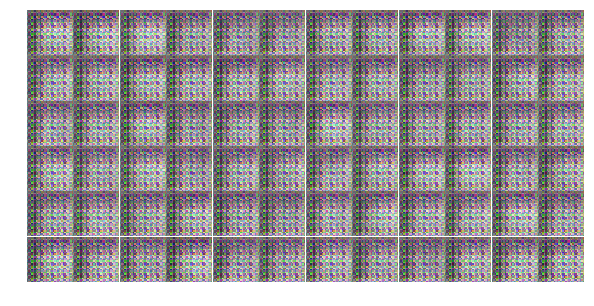

Epoch 1/15... Discriminator Loss: 0.3112... Generator Loss: 2.1967
Epoch 1/15... Discriminator Loss: 0.7907... Generator Loss: 1.8397
Epoch 1/15... Discriminator Loss: 0.5190... Generator Loss: 1.7840
Epoch 1/15... Discriminator Loss: 0.4893... Generator Loss: 1.4243
Epoch 1/15... Discriminator Loss: 0.5253... Generator Loss: 1.4820
Epoch 1/15... Discriminator Loss: 0.4256... Generator Loss: 2.0799
Epoch 1/15... Discriminator Loss: 0.1952... Generator Loss: 2.8234
Epoch 1/15... Discriminator Loss: 0.3701... Generator Loss: 2.8752
Epoch 1/15... Discriminator Loss: 0.8456... Generator Loss: 4.1143
Epoch 1/15... Discriminator Loss: 0.3344... Generator Loss: 2.4184


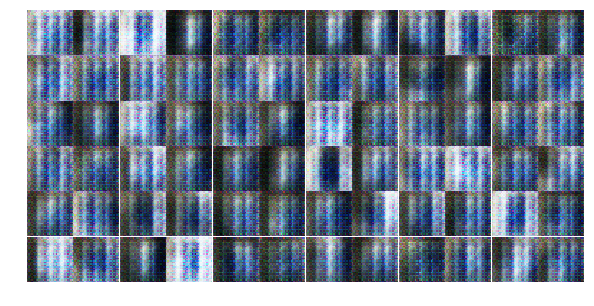

Epoch 1/15... Discriminator Loss: 0.5822... Generator Loss: 1.0872
Epoch 1/15... Discriminator Loss: 0.1555... Generator Loss: 3.5167
Epoch 1/15... Discriminator Loss: 0.5119... Generator Loss: 5.0140
Epoch 1/15... Discriminator Loss: 2.8600... Generator Loss: 0.1266
Epoch 1/15... Discriminator Loss: 0.5495... Generator Loss: 1.8500
Epoch 1/15... Discriminator Loss: 0.3895... Generator Loss: 1.6666
Epoch 1/15... Discriminator Loss: 1.2053... Generator Loss: 1.9918
Epoch 1/15... Discriminator Loss: 0.2932... Generator Loss: 3.8244
Epoch 1/15... Discriminator Loss: 0.3149... Generator Loss: 3.1580
Epoch 1/15... Discriminator Loss: 1.1760... Generator Loss: 5.2659


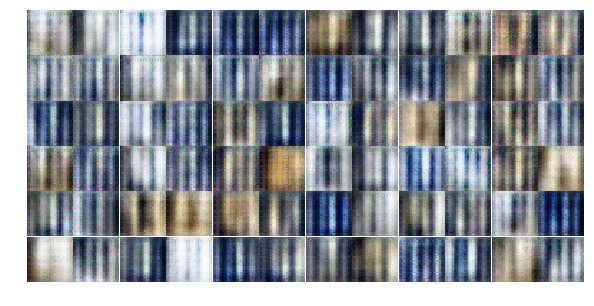

Epoch 1/15... Discriminator Loss: 0.8176... Generator Loss: 2.4487
Epoch 1/15... Discriminator Loss: 0.5210... Generator Loss: 3.1560
Epoch 1/15... Discriminator Loss: 0.4559... Generator Loss: 2.0096
Epoch 1/15... Discriminator Loss: 0.5306... Generator Loss: 1.5333
Epoch 1/15... Discriminator Loss: 0.4409... Generator Loss: 2.2306
Epoch 1/15... Discriminator Loss: 0.8727... Generator Loss: 0.8301
Epoch 1/15... Discriminator Loss: 0.3188... Generator Loss: 2.4868
Epoch 1/15... Discriminator Loss: 0.4215... Generator Loss: 3.8025
Epoch 1/15... Discriminator Loss: 0.1388... Generator Loss: 3.9228
Epoch 1/15... Discriminator Loss: 0.2311... Generator Loss: 3.1284


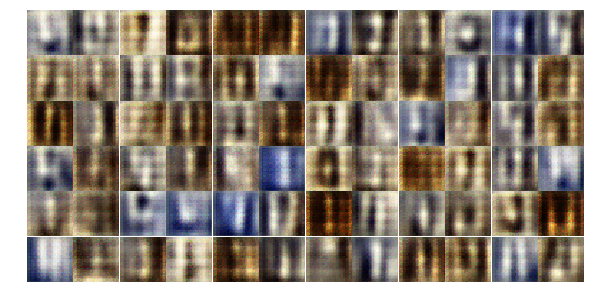

Epoch 1/15... Discriminator Loss: 0.2574... Generator Loss: 2.8621
Epoch 1/15... Discriminator Loss: 0.1405... Generator Loss: 3.4605
Epoch 1/15... Discriminator Loss: 0.2244... Generator Loss: 2.6459
Epoch 1/15... Discriminator Loss: 2.7051... Generator Loss: 5.9571
Epoch 1/15... Discriminator Loss: 0.9886... Generator Loss: 0.9146
Epoch 1/15... Discriminator Loss: 0.3039... Generator Loss: 2.4696
Epoch 1/15... Discriminator Loss: 0.4690... Generator Loss: 1.8571
Epoch 1/15... Discriminator Loss: 0.6646... Generator Loss: 1.5647
Epoch 1/15... Discriminator Loss: 0.4185... Generator Loss: 1.8421
Epoch 1/15... Discriminator Loss: 0.9449... Generator Loss: 1.5802


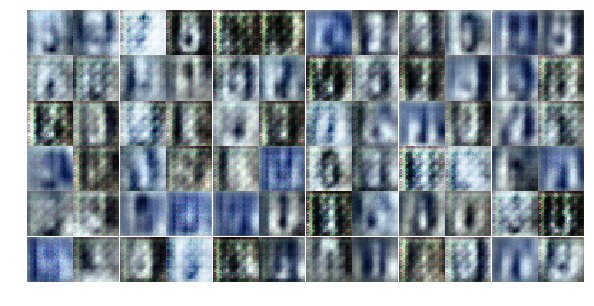

Epoch 1/15... Discriminator Loss: 0.6712... Generator Loss: 1.8539
Epoch 1/15... Discriminator Loss: 0.5189... Generator Loss: 1.4678
Epoch 1/15... Discriminator Loss: 0.4205... Generator Loss: 1.8738
Epoch 1/15... Discriminator Loss: 0.6749... Generator Loss: 1.0460
Epoch 1/15... Discriminator Loss: 1.5051... Generator Loss: 4.3844
Epoch 1/15... Discriminator Loss: 0.2522... Generator Loss: 2.9010
Epoch 1/15... Discriminator Loss: 0.7242... Generator Loss: 1.1878
Epoch 2/15... Discriminator Loss: 0.5523... Generator Loss: 1.4016
Epoch 2/15... Discriminator Loss: 0.3685... Generator Loss: 2.3403
Epoch 2/15... Discriminator Loss: 0.7550... Generator Loss: 1.0251


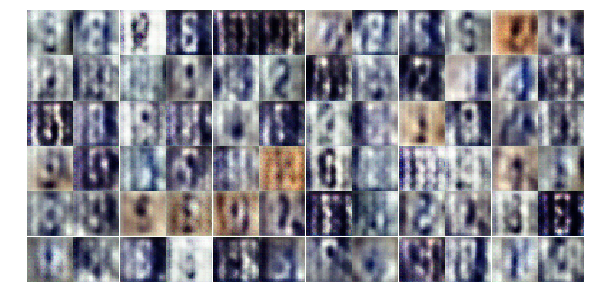

Epoch 2/15... Discriminator Loss: 0.6377... Generator Loss: 1.3599
Epoch 2/15... Discriminator Loss: 1.0076... Generator Loss: 1.2437
Epoch 2/15... Discriminator Loss: 0.5587... Generator Loss: 1.7262
Epoch 2/15... Discriminator Loss: 0.6275... Generator Loss: 1.6016
Epoch 2/15... Discriminator Loss: 0.5844... Generator Loss: 1.4013
Epoch 2/15... Discriminator Loss: 0.7685... Generator Loss: 1.9069
Epoch 2/15... Discriminator Loss: 0.9484... Generator Loss: 1.4203
Epoch 2/15... Discriminator Loss: 0.9424... Generator Loss: 1.4468
Epoch 2/15... Discriminator Loss: 0.5996... Generator Loss: 1.3496
Epoch 2/15... Discriminator Loss: 0.4274... Generator Loss: 1.7706


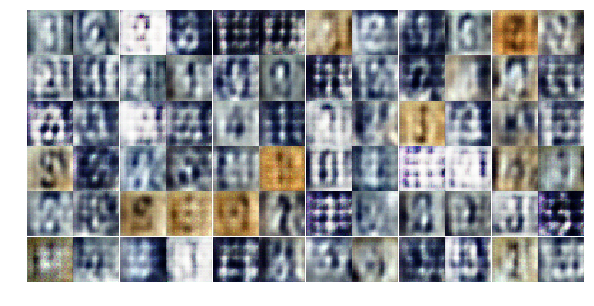

Epoch 2/15... Discriminator Loss: 0.8287... Generator Loss: 1.1408
Epoch 2/15... Discriminator Loss: 0.7418... Generator Loss: 1.3444
Epoch 2/15... Discriminator Loss: 0.6476... Generator Loss: 1.6090
Epoch 2/15... Discriminator Loss: 0.6320... Generator Loss: 1.5159
Epoch 2/15... Discriminator Loss: 0.6955... Generator Loss: 1.6124
Epoch 2/15... Discriminator Loss: 0.9346... Generator Loss: 1.3022
Epoch 2/15... Discriminator Loss: 1.1294... Generator Loss: 0.7480
Epoch 2/15... Discriminator Loss: 0.8875... Generator Loss: 1.1307
Epoch 2/15... Discriminator Loss: 0.7331... Generator Loss: 1.2525
Epoch 2/15... Discriminator Loss: 1.0041... Generator Loss: 0.7839


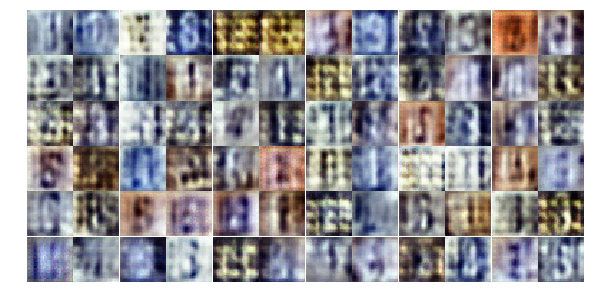

Epoch 2/15... Discriminator Loss: 1.0030... Generator Loss: 0.8345
Epoch 2/15... Discriminator Loss: 1.0593... Generator Loss: 0.7143
Epoch 2/15... Discriminator Loss: 0.8838... Generator Loss: 1.1010
Epoch 2/15... Discriminator Loss: 0.9398... Generator Loss: 1.8289
Epoch 2/15... Discriminator Loss: 1.1836... Generator Loss: 1.0378
Epoch 2/15... Discriminator Loss: 1.1366... Generator Loss: 0.7520
Epoch 2/15... Discriminator Loss: 1.4105... Generator Loss: 0.4060
Epoch 2/15... Discriminator Loss: 1.4080... Generator Loss: 0.5326
Epoch 2/15... Discriminator Loss: 1.1192... Generator Loss: 0.7752
Epoch 2/15... Discriminator Loss: 1.1621... Generator Loss: 0.7349


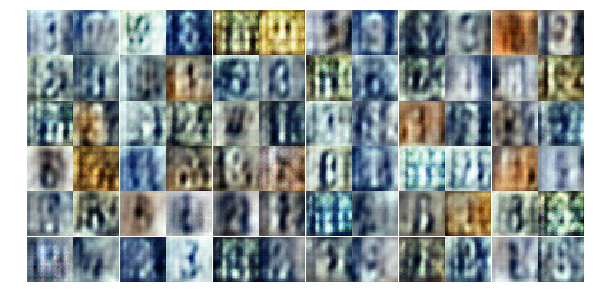

Epoch 2/15... Discriminator Loss: 0.9615... Generator Loss: 1.0770
Epoch 2/15... Discriminator Loss: 1.7478... Generator Loss: 0.8418
Epoch 2/15... Discriminator Loss: 1.1887... Generator Loss: 0.7946
Epoch 2/15... Discriminator Loss: 1.3109... Generator Loss: 0.6904
Epoch 2/15... Discriminator Loss: 1.1533... Generator Loss: 1.0613
Epoch 2/15... Discriminator Loss: 1.3395... Generator Loss: 0.7498
Epoch 2/15... Discriminator Loss: 0.9849... Generator Loss: 1.2439
Epoch 2/15... Discriminator Loss: 1.2234... Generator Loss: 1.0351
Epoch 2/15... Discriminator Loss: 1.0162... Generator Loss: 0.9815
Epoch 2/15... Discriminator Loss: 1.2721... Generator Loss: 0.8339


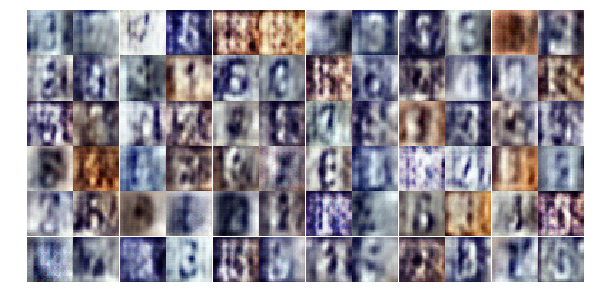

Epoch 2/15... Discriminator Loss: 0.9303... Generator Loss: 1.1852
Epoch 2/15... Discriminator Loss: 1.0511... Generator Loss: 1.1848
Epoch 2/15... Discriminator Loss: 1.0727... Generator Loss: 0.8333
Epoch 2/15... Discriminator Loss: 1.0184... Generator Loss: 0.9134
Epoch 2/15... Discriminator Loss: 1.1594... Generator Loss: 0.7915
Epoch 2/15... Discriminator Loss: 1.0829... Generator Loss: 0.7986
Epoch 2/15... Discriminator Loss: 1.0463... Generator Loss: 1.2133
Epoch 2/15... Discriminator Loss: 1.1354... Generator Loss: 1.3347
Epoch 2/15... Discriminator Loss: 1.0567... Generator Loss: 1.4625
Epoch 2/15... Discriminator Loss: 1.1377... Generator Loss: 1.3945


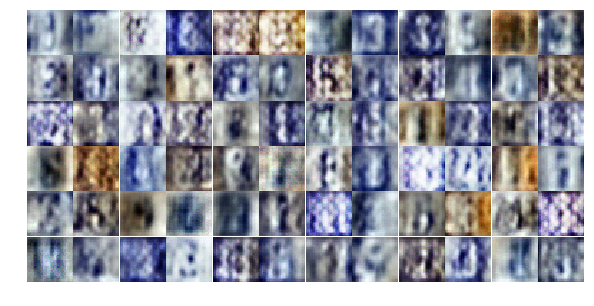

Epoch 2/15... Discriminator Loss: 1.0594... Generator Loss: 1.1693
Epoch 2/15... Discriminator Loss: 0.8856... Generator Loss: 1.2613
Epoch 2/15... Discriminator Loss: 1.4822... Generator Loss: 0.4409
Epoch 2/15... Discriminator Loss: 1.1854... Generator Loss: 0.7644
Epoch 3/15... Discriminator Loss: 0.9267... Generator Loss: 1.0873
Epoch 3/15... Discriminator Loss: 0.8411... Generator Loss: 1.1590
Epoch 3/15... Discriminator Loss: 0.7692... Generator Loss: 1.3211
Epoch 3/15... Discriminator Loss: 1.1689... Generator Loss: 0.8989
Epoch 3/15... Discriminator Loss: 0.6364... Generator Loss: 1.3935
Epoch 3/15... Discriminator Loss: 1.0337... Generator Loss: 1.0025


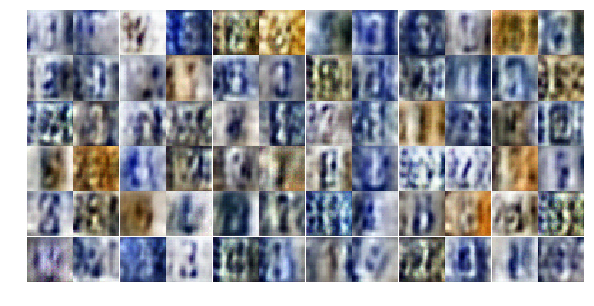

Epoch 3/15... Discriminator Loss: 0.8416... Generator Loss: 1.1946
Epoch 3/15... Discriminator Loss: 0.7702... Generator Loss: 1.2197
Epoch 3/15... Discriminator Loss: 0.8815... Generator Loss: 1.0469
Epoch 3/15... Discriminator Loss: 0.9300... Generator Loss: 1.1543
Epoch 3/15... Discriminator Loss: 0.9004... Generator Loss: 1.0987
Epoch 3/15... Discriminator Loss: 1.2700... Generator Loss: 0.5211
Epoch 3/15... Discriminator Loss: 0.6493... Generator Loss: 1.4118
Epoch 3/15... Discriminator Loss: 0.8361... Generator Loss: 1.2839
Epoch 3/15... Discriminator Loss: 0.7713... Generator Loss: 1.9450
Epoch 3/15... Discriminator Loss: 0.6782... Generator Loss: 1.3112


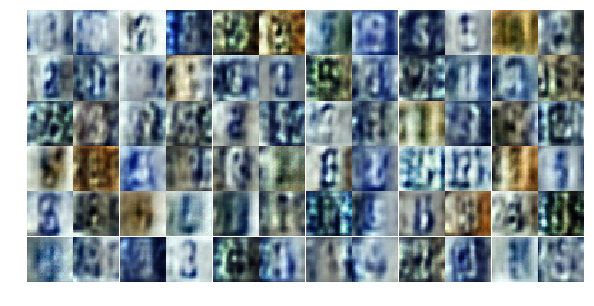

Epoch 3/15... Discriminator Loss: 0.8135... Generator Loss: 2.2257
Epoch 3/15... Discriminator Loss: 0.7486... Generator Loss: 1.2727
Epoch 3/15... Discriminator Loss: 0.7240... Generator Loss: 1.0185
Epoch 3/15... Discriminator Loss: 0.8069... Generator Loss: 1.5471
Epoch 3/15... Discriminator Loss: 0.9791... Generator Loss: 0.8461
Epoch 3/15... Discriminator Loss: 0.6752... Generator Loss: 1.4007
Epoch 3/15... Discriminator Loss: 1.5501... Generator Loss: 0.3475
Epoch 3/15... Discriminator Loss: 0.5642... Generator Loss: 1.6130
Epoch 3/15... Discriminator Loss: 0.9588... Generator Loss: 2.1947
Epoch 3/15... Discriminator Loss: 0.8704... Generator Loss: 0.9826


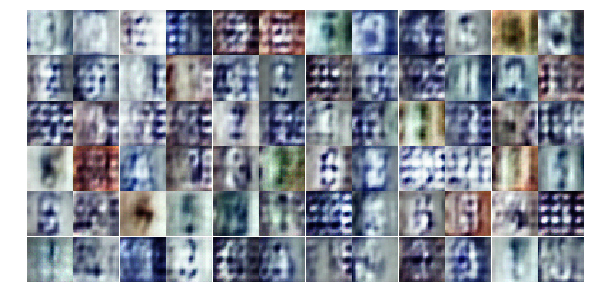

Epoch 3/15... Discriminator Loss: 0.4505... Generator Loss: 1.8618
Epoch 3/15... Discriminator Loss: 0.7427... Generator Loss: 1.2594
Epoch 3/15... Discriminator Loss: 0.6836... Generator Loss: 1.3501
Epoch 3/15... Discriminator Loss: 0.4376... Generator Loss: 1.5614
Epoch 3/15... Discriminator Loss: 0.7841... Generator Loss: 0.9873
Epoch 3/15... Discriminator Loss: 0.9619... Generator Loss: 0.6833
Epoch 3/15... Discriminator Loss: 1.0188... Generator Loss: 0.8461
Epoch 3/15... Discriminator Loss: 0.7556... Generator Loss: 2.2911
Epoch 3/15... Discriminator Loss: 0.2960... Generator Loss: 2.8315
Epoch 3/15... Discriminator Loss: 0.5237... Generator Loss: 1.9324


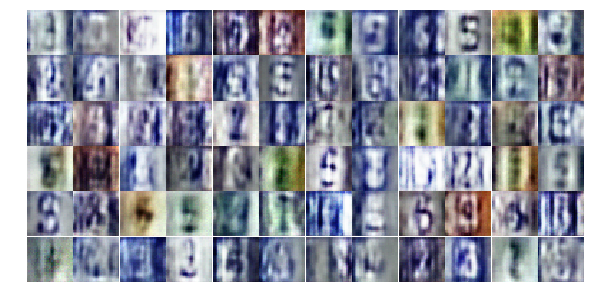

Epoch 3/15... Discriminator Loss: 0.3139... Generator Loss: 2.4843
Epoch 3/15... Discriminator Loss: 0.4884... Generator Loss: 2.3530
Epoch 3/15... Discriminator Loss: 0.7254... Generator Loss: 1.2028
Epoch 3/15... Discriminator Loss: 0.5017... Generator Loss: 2.4635
Epoch 3/15... Discriminator Loss: 0.4050... Generator Loss: 2.6439
Epoch 3/15... Discriminator Loss: 0.3108... Generator Loss: 2.0666
Epoch 3/15... Discriminator Loss: 0.5830... Generator Loss: 1.7027
Epoch 3/15... Discriminator Loss: 0.5464... Generator Loss: 1.4290
Epoch 3/15... Discriminator Loss: 0.9946... Generator Loss: 3.2060
Epoch 3/15... Discriminator Loss: 0.8495... Generator Loss: 0.9212


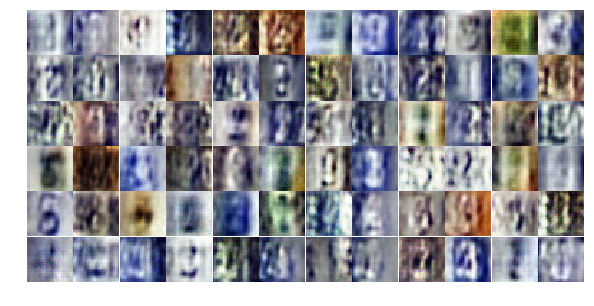

Epoch 3/15... Discriminator Loss: 0.8795... Generator Loss: 0.9474
Epoch 3/15... Discriminator Loss: 0.7785... Generator Loss: 1.5200
Epoch 3/15... Discriminator Loss: 0.6141... Generator Loss: 1.3075
Epoch 3/15... Discriminator Loss: 0.8370... Generator Loss: 0.9055
Epoch 3/15... Discriminator Loss: 0.6624... Generator Loss: 2.8232
Epoch 3/15... Discriminator Loss: 0.4685... Generator Loss: 2.0239
Epoch 3/15... Discriminator Loss: 0.4593... Generator Loss: 2.6162
Epoch 3/15... Discriminator Loss: 0.3940... Generator Loss: 1.5950
Epoch 3/15... Discriminator Loss: 0.5648... Generator Loss: 1.5228
Epoch 3/15... Discriminator Loss: 0.4769... Generator Loss: 1.7147


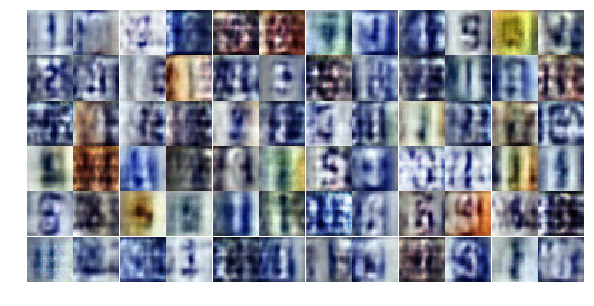

Epoch 3/15... Discriminator Loss: 0.6306... Generator Loss: 2.9235
Epoch 4/15... Discriminator Loss: 0.6163... Generator Loss: 1.1700
Epoch 4/15... Discriminator Loss: 1.7806... Generator Loss: 0.2821
Epoch 4/15... Discriminator Loss: 0.8618... Generator Loss: 0.8507
Epoch 4/15... Discriminator Loss: 0.6374... Generator Loss: 1.5087
Epoch 4/15... Discriminator Loss: 0.7618... Generator Loss: 1.0087
Epoch 4/15... Discriminator Loss: 0.6471... Generator Loss: 2.6729
Epoch 4/15... Discriminator Loss: 0.7675... Generator Loss: 1.1858
Epoch 4/15... Discriminator Loss: 0.3865... Generator Loss: 2.3823
Epoch 4/15... Discriminator Loss: 0.4861... Generator Loss: 1.7231


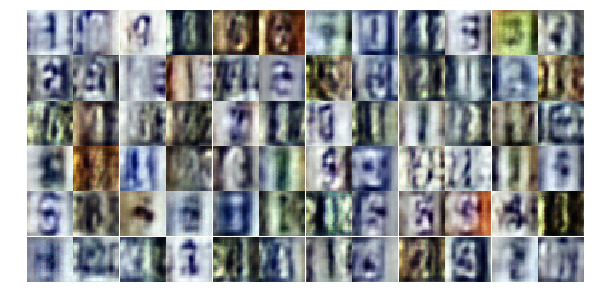

Epoch 4/15... Discriminator Loss: 0.4330... Generator Loss: 1.6995
Epoch 4/15... Discriminator Loss: 0.5192... Generator Loss: 2.8996
Epoch 4/15... Discriminator Loss: 0.9605... Generator Loss: 1.4782
Epoch 4/15... Discriminator Loss: 0.5329... Generator Loss: 1.3746
Epoch 4/15... Discriminator Loss: 1.0678... Generator Loss: 1.4858
Epoch 4/15... Discriminator Loss: 1.4845... Generator Loss: 0.3790
Epoch 4/15... Discriminator Loss: 0.5534... Generator Loss: 1.2482
Epoch 4/15... Discriminator Loss: 0.7902... Generator Loss: 1.0514
Epoch 4/15... Discriminator Loss: 0.8962... Generator Loss: 1.1130
Epoch 4/15... Discriminator Loss: 0.8679... Generator Loss: 1.9416


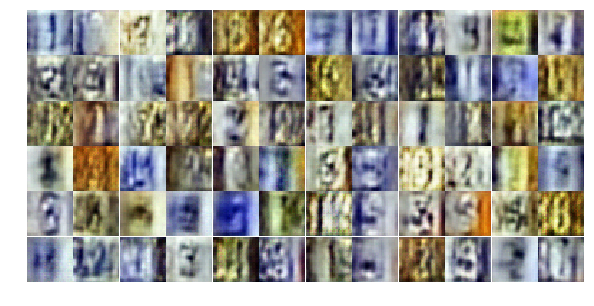

Epoch 4/15... Discriminator Loss: 0.6069... Generator Loss: 1.2538
Epoch 4/15... Discriminator Loss: 0.5343... Generator Loss: 1.9567
Epoch 4/15... Discriminator Loss: 1.2503... Generator Loss: 0.4479
Epoch 4/15... Discriminator Loss: 0.8839... Generator Loss: 0.8551
Epoch 4/15... Discriminator Loss: 0.2737... Generator Loss: 2.3588
Epoch 4/15... Discriminator Loss: 0.6091... Generator Loss: 2.7653
Epoch 4/15... Discriminator Loss: 0.3693... Generator Loss: 2.2103
Epoch 4/15... Discriminator Loss: 0.6262... Generator Loss: 1.3916
Epoch 4/15... Discriminator Loss: 0.8712... Generator Loss: 0.7626
Epoch 4/15... Discriminator Loss: 0.6328... Generator Loss: 2.0622


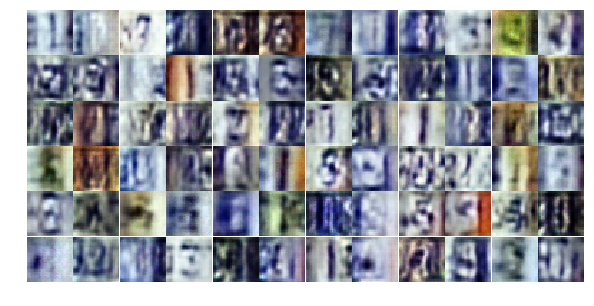

Epoch 4/15... Discriminator Loss: 0.4797... Generator Loss: 1.6069
Epoch 4/15... Discriminator Loss: 0.5877... Generator Loss: 1.5063
Epoch 4/15... Discriminator Loss: 0.4881... Generator Loss: 1.5756
Epoch 4/15... Discriminator Loss: 0.3158... Generator Loss: 2.7463
Epoch 4/15... Discriminator Loss: 0.3341... Generator Loss: 2.5100
Epoch 4/15... Discriminator Loss: 0.3561... Generator Loss: 1.9973
Epoch 4/15... Discriminator Loss: 0.6428... Generator Loss: 2.0650
Epoch 4/15... Discriminator Loss: 0.9018... Generator Loss: 1.0705
Epoch 4/15... Discriminator Loss: 0.4942... Generator Loss: 1.4087
Epoch 4/15... Discriminator Loss: 0.5113... Generator Loss: 1.8771


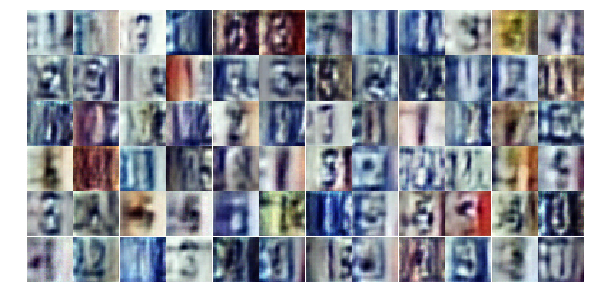

Epoch 4/15... Discriminator Loss: 0.5590... Generator Loss: 1.1946
Epoch 4/15... Discriminator Loss: 0.2893... Generator Loss: 2.1556
Epoch 4/15... Discriminator Loss: 0.7304... Generator Loss: 0.8857
Epoch 4/15... Discriminator Loss: 0.6324... Generator Loss: 3.3292
Epoch 4/15... Discriminator Loss: 0.3595... Generator Loss: 1.9794
Epoch 4/15... Discriminator Loss: 0.7945... Generator Loss: 1.0243
Epoch 4/15... Discriminator Loss: 0.5440... Generator Loss: 1.9113
Epoch 4/15... Discriminator Loss: 0.8532... Generator Loss: 3.2886
Epoch 4/15... Discriminator Loss: 0.7929... Generator Loss: 0.9407
Epoch 4/15... Discriminator Loss: 0.3974... Generator Loss: 1.9233


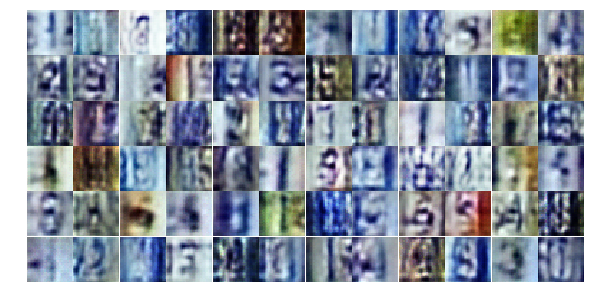

Epoch 4/15... Discriminator Loss: 0.6208... Generator Loss: 1.1393
Epoch 4/15... Discriminator Loss: 0.4475... Generator Loss: 1.4351
Epoch 4/15... Discriminator Loss: 0.3631... Generator Loss: 2.2603
Epoch 4/15... Discriminator Loss: 0.5004... Generator Loss: 1.8473
Epoch 4/15... Discriminator Loss: 0.7456... Generator Loss: 0.9413
Epoch 4/15... Discriminator Loss: 0.4952... Generator Loss: 2.3000
Epoch 4/15... Discriminator Loss: 0.2251... Generator Loss: 2.5815
Epoch 4/15... Discriminator Loss: 0.5340... Generator Loss: 1.2752
Epoch 4/15... Discriminator Loss: 0.4285... Generator Loss: 2.1580
Epoch 5/15... Discriminator Loss: 0.4143... Generator Loss: 1.6217


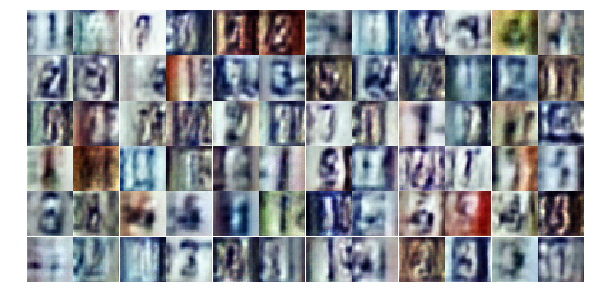

Epoch 5/15... Discriminator Loss: 0.3369... Generator Loss: 2.5751
Epoch 5/15... Discriminator Loss: 0.5559... Generator Loss: 1.5184
Epoch 5/15... Discriminator Loss: 0.5276... Generator Loss: 1.5831
Epoch 5/15... Discriminator Loss: 0.5417... Generator Loss: 1.1368
Epoch 5/15... Discriminator Loss: 0.3882... Generator Loss: 2.1349
Epoch 5/15... Discriminator Loss: 0.5490... Generator Loss: 1.1552
Epoch 5/15... Discriminator Loss: 0.4111... Generator Loss: 2.8844
Epoch 5/15... Discriminator Loss: 0.3817... Generator Loss: 1.7184
Epoch 5/15... Discriminator Loss: 0.5413... Generator Loss: 2.3876
Epoch 5/15... Discriminator Loss: 1.0780... Generator Loss: 0.6001


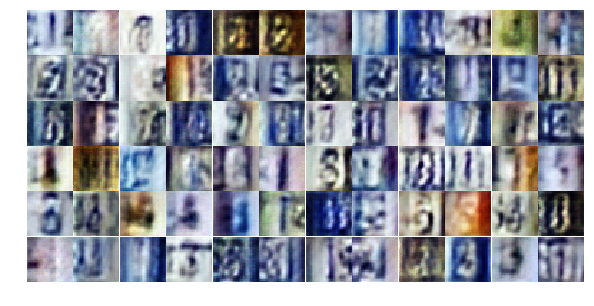

Epoch 5/15... Discriminator Loss: 0.7226... Generator Loss: 1.2147
Epoch 5/15... Discriminator Loss: 0.6126... Generator Loss: 1.0625
Epoch 5/15... Discriminator Loss: 0.4317... Generator Loss: 2.4947
Epoch 5/15... Discriminator Loss: 1.6349... Generator Loss: 0.3111
Epoch 5/15... Discriminator Loss: 0.9152... Generator Loss: 2.7309
Epoch 5/15... Discriminator Loss: 1.2416... Generator Loss: 3.4038
Epoch 5/15... Discriminator Loss: 0.5446... Generator Loss: 1.4190
Epoch 5/15... Discriminator Loss: 0.5166... Generator Loss: 1.5698
Epoch 5/15... Discriminator Loss: 0.3645... Generator Loss: 1.7507
Epoch 5/15... Discriminator Loss: 0.3145... Generator Loss: 2.0746


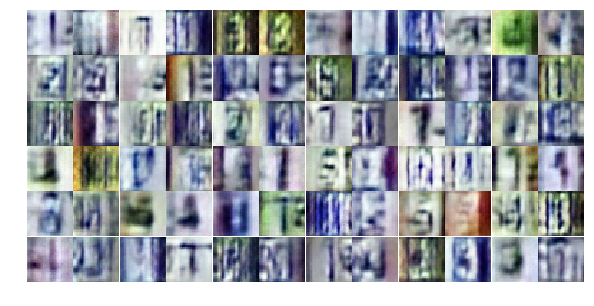

Epoch 5/15... Discriminator Loss: 0.4124... Generator Loss: 1.7816
Epoch 5/15... Discriminator Loss: 0.5609... Generator Loss: 1.3589
Epoch 5/15... Discriminator Loss: 0.5785... Generator Loss: 1.4101
Epoch 5/15... Discriminator Loss: 0.5798... Generator Loss: 1.8173
Epoch 5/15... Discriminator Loss: 0.5058... Generator Loss: 1.3180
Epoch 5/15... Discriminator Loss: 0.6118... Generator Loss: 1.3778
Epoch 5/15... Discriminator Loss: 0.5322... Generator Loss: 1.1621
Epoch 5/15... Discriminator Loss: 0.3673... Generator Loss: 2.2314
Epoch 5/15... Discriminator Loss: 0.5152... Generator Loss: 2.3321
Epoch 5/15... Discriminator Loss: 0.4612... Generator Loss: 2.0786


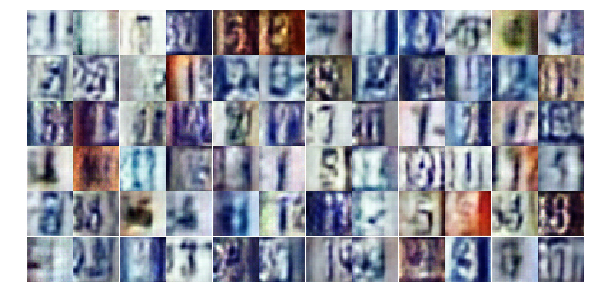

Epoch 5/15... Discriminator Loss: 0.8653... Generator Loss: 0.8900
Epoch 5/15... Discriminator Loss: 0.5012... Generator Loss: 1.4261
Epoch 5/15... Discriminator Loss: 0.4944... Generator Loss: 1.3997
Epoch 5/15... Discriminator Loss: 0.4193... Generator Loss: 1.8505
Epoch 5/15... Discriminator Loss: 0.8029... Generator Loss: 0.8860
Epoch 5/15... Discriminator Loss: 0.4161... Generator Loss: 2.0230
Epoch 5/15... Discriminator Loss: 0.5386... Generator Loss: 1.3316
Epoch 5/15... Discriminator Loss: 0.7966... Generator Loss: 0.8780
Epoch 5/15... Discriminator Loss: 0.5548... Generator Loss: 1.1705
Epoch 5/15... Discriminator Loss: 1.2883... Generator Loss: 0.4716


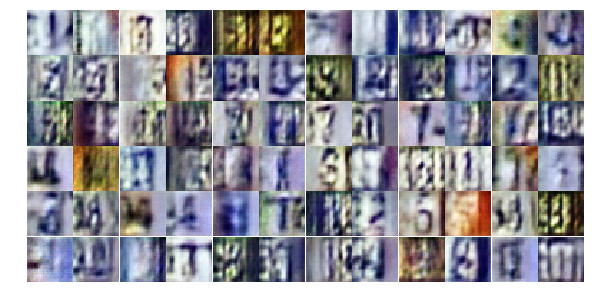

Epoch 5/15... Discriminator Loss: 0.4795... Generator Loss: 1.6702
Epoch 5/15... Discriminator Loss: 0.5726... Generator Loss: 1.8033
Epoch 5/15... Discriminator Loss: 1.0897... Generator Loss: 0.6240
Epoch 5/15... Discriminator Loss: 0.4497... Generator Loss: 1.9486
Epoch 5/15... Discriminator Loss: 1.0031... Generator Loss: 2.6174
Epoch 5/15... Discriminator Loss: 0.6627... Generator Loss: 1.2144
Epoch 5/15... Discriminator Loss: 0.5964... Generator Loss: 1.2172
Epoch 5/15... Discriminator Loss: 0.4250... Generator Loss: 1.6057
Epoch 5/15... Discriminator Loss: 0.5123... Generator Loss: 1.3630
Epoch 5/15... Discriminator Loss: 0.6124... Generator Loss: 3.6230


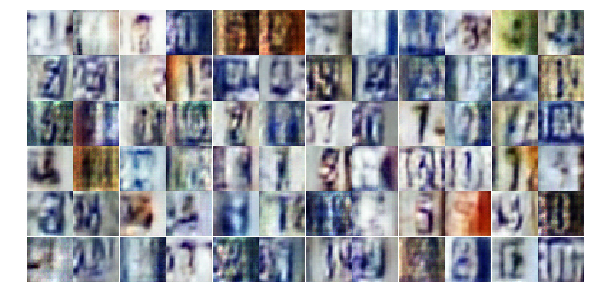

Epoch 5/15... Discriminator Loss: 0.9327... Generator Loss: 0.7051
Epoch 5/15... Discriminator Loss: 0.4096... Generator Loss: 1.7741
Epoch 5/15... Discriminator Loss: 0.6458... Generator Loss: 1.1101
Epoch 5/15... Discriminator Loss: 0.5544... Generator Loss: 1.1760
Epoch 5/15... Discriminator Loss: 0.3956... Generator Loss: 1.8495
Epoch 5/15... Discriminator Loss: 0.6102... Generator Loss: 1.3819
Epoch 6/15... Discriminator Loss: 0.4300... Generator Loss: 1.5169
Epoch 6/15... Discriminator Loss: 0.3628... Generator Loss: 1.6752
Epoch 6/15... Discriminator Loss: 3.6479... Generator Loss: 0.1359
Epoch 6/15... Discriminator Loss: 1.5617... Generator Loss: 3.5375


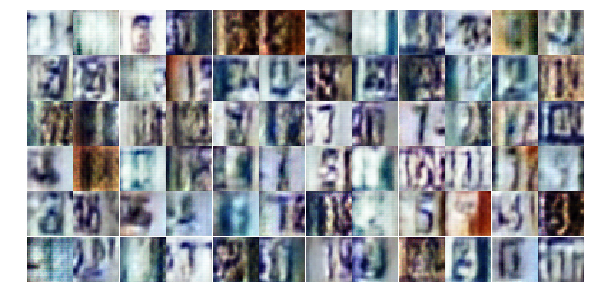

Epoch 6/15... Discriminator Loss: 0.6168... Generator Loss: 1.3080
Epoch 6/15... Discriminator Loss: 0.6414... Generator Loss: 2.3048
Epoch 6/15... Discriminator Loss: 0.5961... Generator Loss: 1.2195
Epoch 6/15... Discriminator Loss: 0.8076... Generator Loss: 0.9216
Epoch 6/15... Discriminator Loss: 0.8746... Generator Loss: 0.7334
Epoch 6/15... Discriminator Loss: 0.4545... Generator Loss: 1.3417
Epoch 6/15... Discriminator Loss: 0.5524... Generator Loss: 2.0259
Epoch 6/15... Discriminator Loss: 0.9244... Generator Loss: 0.7355
Epoch 6/15... Discriminator Loss: 0.5575... Generator Loss: 1.1444
Epoch 6/15... Discriminator Loss: 0.6062... Generator Loss: 1.1839


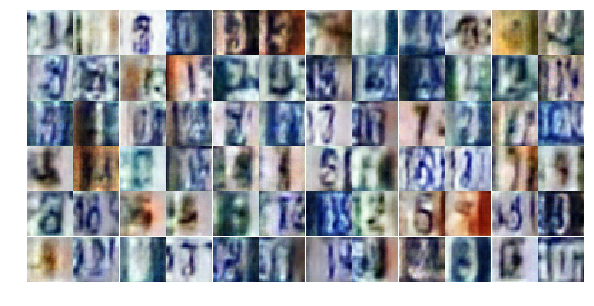

Epoch 6/15... Discriminator Loss: 0.4558... Generator Loss: 1.4375
Epoch 6/15... Discriminator Loss: 0.7536... Generator Loss: 1.1807
Epoch 6/15... Discriminator Loss: 0.6900... Generator Loss: 1.1524
Epoch 6/15... Discriminator Loss: 0.4207... Generator Loss: 1.4933
Epoch 6/15... Discriminator Loss: 0.8206... Generator Loss: 3.0009
Epoch 6/15... Discriminator Loss: 0.7912... Generator Loss: 2.0310
Epoch 6/15... Discriminator Loss: 0.6742... Generator Loss: 0.9620
Epoch 6/15... Discriminator Loss: 0.6916... Generator Loss: 0.9422
Epoch 6/15... Discriminator Loss: 0.8031... Generator Loss: 2.9252
Epoch 6/15... Discriminator Loss: 0.7051... Generator Loss: 0.9659


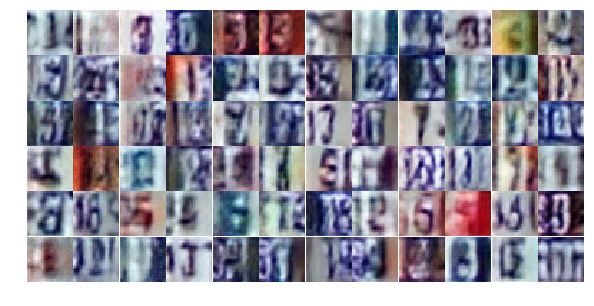

Epoch 6/15... Discriminator Loss: 0.9648... Generator Loss: 0.6950
Epoch 6/15... Discriminator Loss: 0.6514... Generator Loss: 1.1953
Epoch 6/15... Discriminator Loss: 1.8643... Generator Loss: 0.2375
Epoch 6/15... Discriminator Loss: 0.5675... Generator Loss: 1.2719
Epoch 6/15... Discriminator Loss: 0.3683... Generator Loss: 1.8587
Epoch 6/15... Discriminator Loss: 0.9412... Generator Loss: 0.9135
Epoch 6/15... Discriminator Loss: 1.0400... Generator Loss: 0.5807
Epoch 6/15... Discriminator Loss: 0.4266... Generator Loss: 1.5235
Epoch 6/15... Discriminator Loss: 0.4985... Generator Loss: 1.6865
Epoch 6/15... Discriminator Loss: 0.4925... Generator Loss: 1.2900


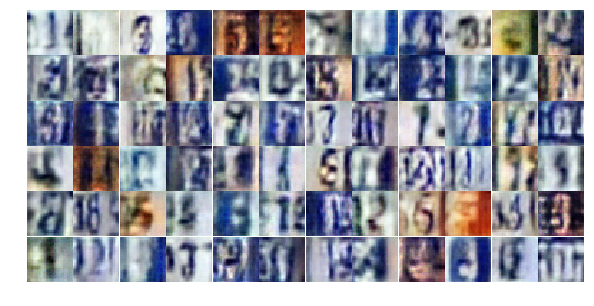

Epoch 6/15... Discriminator Loss: 1.0192... Generator Loss: 0.6086
Epoch 6/15... Discriminator Loss: 2.0201... Generator Loss: 3.8753
Epoch 6/15... Discriminator Loss: 0.9452... Generator Loss: 0.7582
Epoch 6/15... Discriminator Loss: 0.5470... Generator Loss: 1.2845
Epoch 6/15... Discriminator Loss: 0.6931... Generator Loss: 1.1166
Epoch 6/15... Discriminator Loss: 0.5958... Generator Loss: 1.3093
Epoch 6/15... Discriminator Loss: 0.4796... Generator Loss: 1.2853
Epoch 6/15... Discriminator Loss: 0.5740... Generator Loss: 1.3597
Epoch 6/15... Discriminator Loss: 0.6391... Generator Loss: 1.2577
Epoch 6/15... Discriminator Loss: 0.5247... Generator Loss: 1.2382


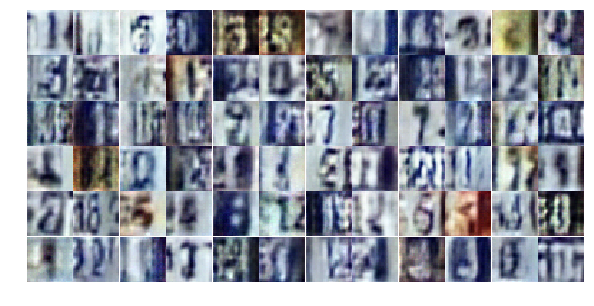

Epoch 6/15... Discriminator Loss: 1.2144... Generator Loss: 3.2922
Epoch 6/15... Discriminator Loss: 1.4256... Generator Loss: 0.3879
Epoch 6/15... Discriminator Loss: 1.0520... Generator Loss: 0.5784
Epoch 6/15... Discriminator Loss: 0.5939... Generator Loss: 1.6448
Epoch 6/15... Discriminator Loss: 0.5066... Generator Loss: 1.5693
Epoch 6/15... Discriminator Loss: 0.6132... Generator Loss: 1.1001
Epoch 6/15... Discriminator Loss: 0.7171... Generator Loss: 0.9532
Epoch 6/15... Discriminator Loss: 1.1382... Generator Loss: 0.5995
Epoch 6/15... Discriminator Loss: 0.5156... Generator Loss: 1.3585
Epoch 6/15... Discriminator Loss: 1.1769... Generator Loss: 0.5108


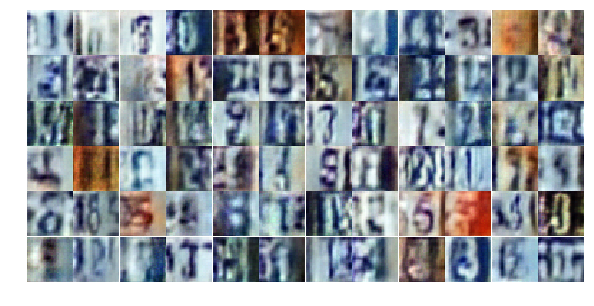

Epoch 6/15... Discriminator Loss: 0.5953... Generator Loss: 1.1562
Epoch 6/15... Discriminator Loss: 0.5881... Generator Loss: 1.1002
Epoch 6/15... Discriminator Loss: 0.5871... Generator Loss: 1.1963
Epoch 7/15... Discriminator Loss: 0.4927... Generator Loss: 1.3323
Epoch 7/15... Discriminator Loss: 0.5715... Generator Loss: 1.4088
Epoch 7/15... Discriminator Loss: 0.9173... Generator Loss: 1.4794
Epoch 7/15... Discriminator Loss: 0.7260... Generator Loss: 0.9366
Epoch 7/15... Discriminator Loss: 0.5391... Generator Loss: 1.3686
Epoch 7/15... Discriminator Loss: 0.5310... Generator Loss: 1.5588
Epoch 7/15... Discriminator Loss: 1.0191... Generator Loss: 0.5733


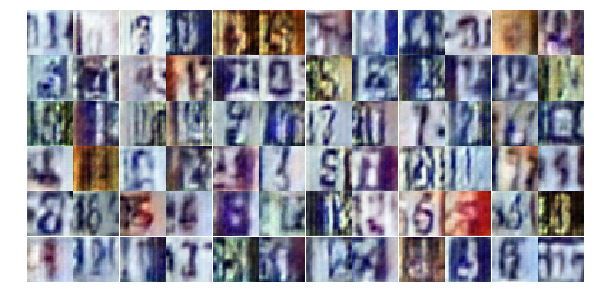

Epoch 7/15... Discriminator Loss: 0.4993... Generator Loss: 1.9186
Epoch 7/15... Discriminator Loss: 0.6035... Generator Loss: 1.1230
Epoch 7/15... Discriminator Loss: 0.5092... Generator Loss: 1.3555
Epoch 7/15... Discriminator Loss: 0.4783... Generator Loss: 1.6873
Epoch 7/15... Discriminator Loss: 0.5324... Generator Loss: 1.4643
Epoch 7/15... Discriminator Loss: 0.6589... Generator Loss: 1.0661
Epoch 7/15... Discriminator Loss: 1.6154... Generator Loss: 3.4931
Epoch 7/15... Discriminator Loss: 0.9803... Generator Loss: 2.3797
Epoch 7/15... Discriminator Loss: 0.6235... Generator Loss: 1.6506
Epoch 7/15... Discriminator Loss: 0.5231... Generator Loss: 1.3301


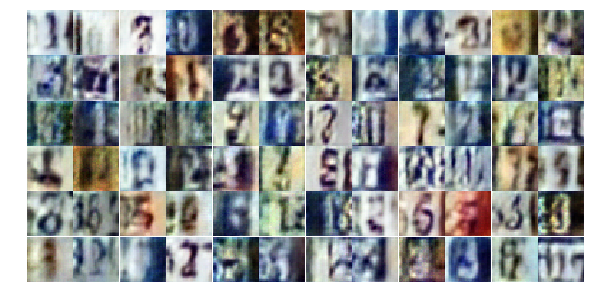

Epoch 7/15... Discriminator Loss: 0.6344... Generator Loss: 1.3813
Epoch 7/15... Discriminator Loss: 0.3517... Generator Loss: 1.8444
Epoch 7/15... Discriminator Loss: 0.7914... Generator Loss: 0.8313
Epoch 7/15... Discriminator Loss: 0.5511... Generator Loss: 1.4950
Epoch 7/15... Discriminator Loss: 0.4441... Generator Loss: 1.4549
Epoch 7/15... Discriminator Loss: 0.4666... Generator Loss: 1.5200
Epoch 7/15... Discriminator Loss: 0.5044... Generator Loss: 1.2907
Epoch 7/15... Discriminator Loss: 1.0517... Generator Loss: 0.5796
Epoch 7/15... Discriminator Loss: 0.3982... Generator Loss: 2.0270
Epoch 7/15... Discriminator Loss: 0.4893... Generator Loss: 1.7835


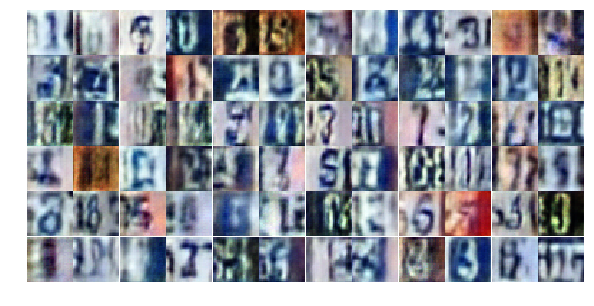

Epoch 7/15... Discriminator Loss: 0.2930... Generator Loss: 2.0765
Epoch 7/15... Discriminator Loss: 1.6630... Generator Loss: 0.3196
Epoch 7/15... Discriminator Loss: 1.0293... Generator Loss: 0.5908
Epoch 7/15... Discriminator Loss: 0.5570... Generator Loss: 1.2461
Epoch 7/15... Discriminator Loss: 0.6433... Generator Loss: 1.1686
Epoch 7/15... Discriminator Loss: 0.9020... Generator Loss: 0.6873
Epoch 7/15... Discriminator Loss: 1.0795... Generator Loss: 0.5741
Epoch 7/15... Discriminator Loss: 0.6582... Generator Loss: 1.1442
Epoch 7/15... Discriminator Loss: 0.9704... Generator Loss: 0.6280
Epoch 7/15... Discriminator Loss: 0.5469... Generator Loss: 2.3013


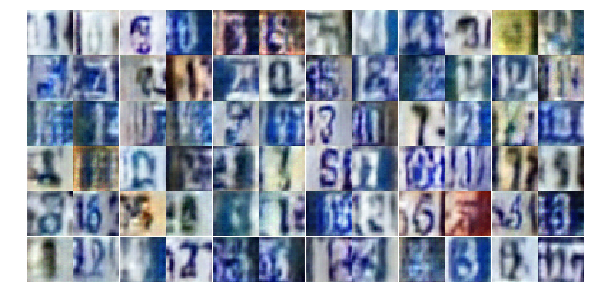

Epoch 7/15... Discriminator Loss: 0.8921... Generator Loss: 0.6956
Epoch 7/15... Discriminator Loss: 1.0804... Generator Loss: 0.6914
Epoch 7/15... Discriminator Loss: 0.5760... Generator Loss: 2.8096
Epoch 7/15... Discriminator Loss: 0.5600... Generator Loss: 1.4727
Epoch 7/15... Discriminator Loss: 0.6673... Generator Loss: 1.2757
Epoch 7/15... Discriminator Loss: 0.4498... Generator Loss: 1.4728
Epoch 7/15... Discriminator Loss: 0.3986... Generator Loss: 1.6887
Epoch 7/15... Discriminator Loss: 0.9865... Generator Loss: 0.8116
Epoch 7/15... Discriminator Loss: 0.3756... Generator Loss: 2.0901
Epoch 7/15... Discriminator Loss: 1.3906... Generator Loss: 0.4578


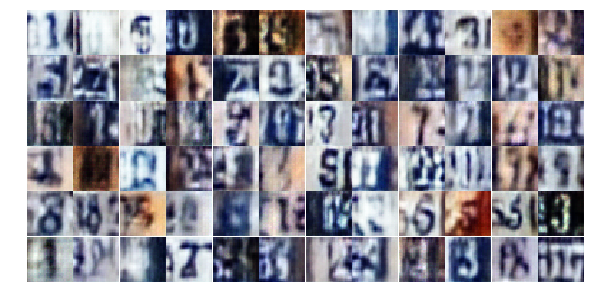

Epoch 7/15... Discriminator Loss: 0.4420... Generator Loss: 1.5787
Epoch 7/15... Discriminator Loss: 0.4063... Generator Loss: 1.5439
Epoch 7/15... Discriminator Loss: 0.7240... Generator Loss: 0.9951
Epoch 7/15... Discriminator Loss: 0.8026... Generator Loss: 0.7962
Epoch 7/15... Discriminator Loss: 0.7414... Generator Loss: 0.8330
Epoch 7/15... Discriminator Loss: 1.7725... Generator Loss: 0.3137
Epoch 7/15... Discriminator Loss: 1.1660... Generator Loss: 0.6577
Epoch 7/15... Discriminator Loss: 0.6838... Generator Loss: 1.6449
Epoch 7/15... Discriminator Loss: 0.9143... Generator Loss: 0.7369
Epoch 7/15... Discriminator Loss: 0.8158... Generator Loss: 0.8256


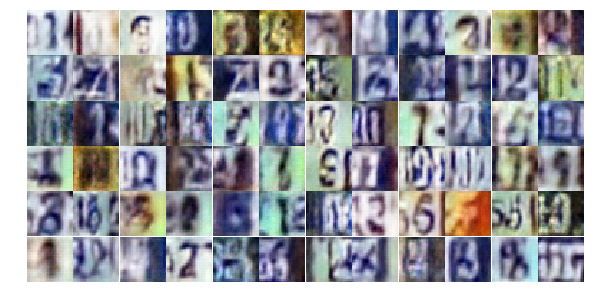

Epoch 7/15... Discriminator Loss: 0.6299... Generator Loss: 1.6739
Epoch 8/15... Discriminator Loss: 0.6859... Generator Loss: 1.0212
Epoch 8/15... Discriminator Loss: 0.8309... Generator Loss: 0.7899
Epoch 8/15... Discriminator Loss: 0.6885... Generator Loss: 1.0377
Epoch 8/15... Discriminator Loss: 0.6997... Generator Loss: 0.9222
Epoch 8/15... Discriminator Loss: 1.0692... Generator Loss: 2.2813
Epoch 8/15... Discriminator Loss: 1.1458... Generator Loss: 0.5326
Epoch 8/15... Discriminator Loss: 0.4352... Generator Loss: 2.1981
Epoch 8/15... Discriminator Loss: 0.6990... Generator Loss: 1.0885
Epoch 8/15... Discriminator Loss: 0.7656... Generator Loss: 0.8746


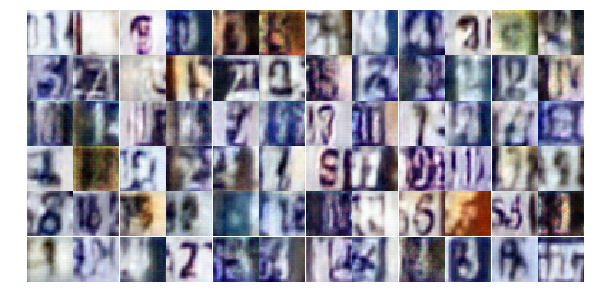

Epoch 8/15... Discriminator Loss: 0.3978... Generator Loss: 1.9866
Epoch 8/15... Discriminator Loss: 0.4512... Generator Loss: 1.7624
Epoch 8/15... Discriminator Loss: 0.6092... Generator Loss: 1.0926
Epoch 8/15... Discriminator Loss: 0.4764... Generator Loss: 1.6279
Epoch 8/15... Discriminator Loss: 1.2340... Generator Loss: 0.5007
Epoch 8/15... Discriminator Loss: 0.7205... Generator Loss: 2.1941
Epoch 8/15... Discriminator Loss: 0.5348... Generator Loss: 1.5178
Epoch 8/15... Discriminator Loss: 0.6238... Generator Loss: 1.5796
Epoch 8/15... Discriminator Loss: 0.4455... Generator Loss: 1.7579
Epoch 8/15... Discriminator Loss: 0.7779... Generator Loss: 0.9503


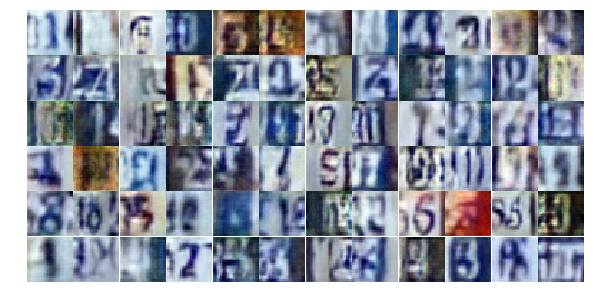

Epoch 8/15... Discriminator Loss: 0.5397... Generator Loss: 1.7127
Epoch 8/15... Discriminator Loss: 0.5258... Generator Loss: 1.3662
Epoch 8/15... Discriminator Loss: 0.7029... Generator Loss: 1.1407
Epoch 8/15... Discriminator Loss: 0.6609... Generator Loss: 2.1034
Epoch 8/15... Discriminator Loss: 0.3813... Generator Loss: 1.6427
Epoch 8/15... Discriminator Loss: 0.6534... Generator Loss: 1.0698
Epoch 8/15... Discriminator Loss: 0.6340... Generator Loss: 1.4791
Epoch 8/15... Discriminator Loss: 0.5883... Generator Loss: 1.0740
Epoch 8/15... Discriminator Loss: 0.8856... Generator Loss: 2.6166
Epoch 8/15... Discriminator Loss: 0.7998... Generator Loss: 0.9401


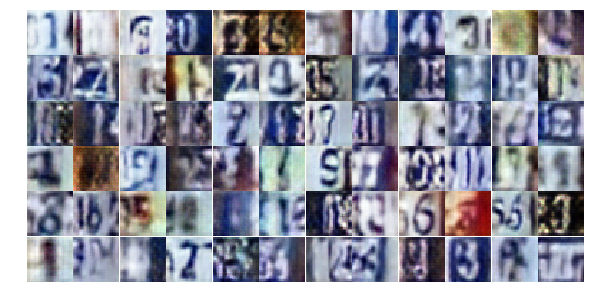

Epoch 8/15... Discriminator Loss: 0.7103... Generator Loss: 1.1619
Epoch 8/15... Discriminator Loss: 1.0423... Generator Loss: 0.6568
Epoch 8/15... Discriminator Loss: 0.4460... Generator Loss: 1.4648
Epoch 8/15... Discriminator Loss: 0.8639... Generator Loss: 0.7800
Epoch 8/15... Discriminator Loss: 0.7492... Generator Loss: 0.8318
Epoch 8/15... Discriminator Loss: 0.6816... Generator Loss: 1.0614
Epoch 8/15... Discriminator Loss: 1.0309... Generator Loss: 0.7297
Epoch 8/15... Discriminator Loss: 0.5922... Generator Loss: 1.3590
Epoch 8/15... Discriminator Loss: 0.3489... Generator Loss: 1.6728
Epoch 8/15... Discriminator Loss: 0.5858... Generator Loss: 1.5925


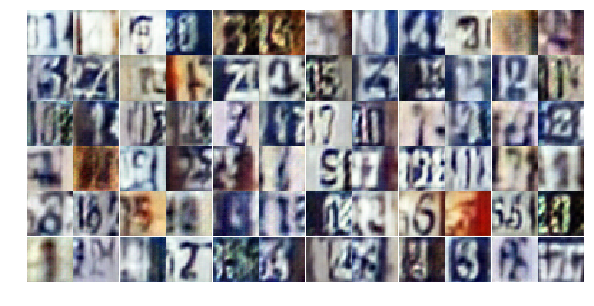

Epoch 8/15... Discriminator Loss: 0.7217... Generator Loss: 2.6310
Epoch 8/15... Discriminator Loss: 0.7983... Generator Loss: 0.8858
Epoch 8/15... Discriminator Loss: 0.7995... Generator Loss: 0.8241
Epoch 8/15... Discriminator Loss: 0.5409... Generator Loss: 1.2034
Epoch 8/15... Discriminator Loss: 1.1792... Generator Loss: 2.3542
Epoch 8/15... Discriminator Loss: 1.3266... Generator Loss: 0.4187
Epoch 8/15... Discriminator Loss: 0.4348... Generator Loss: 1.7694
Epoch 8/15... Discriminator Loss: 0.5384... Generator Loss: 1.2141
Epoch 8/15... Discriminator Loss: 0.6726... Generator Loss: 0.9762
Epoch 8/15... Discriminator Loss: 0.5442... Generator Loss: 1.4058


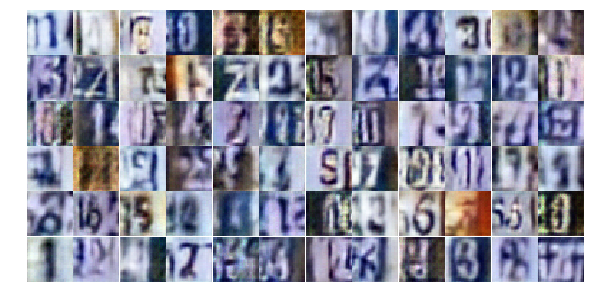

Epoch 8/15... Discriminator Loss: 0.5455... Generator Loss: 2.0925
Epoch 8/15... Discriminator Loss: 0.5145... Generator Loss: 1.4222
Epoch 8/15... Discriminator Loss: 0.3735... Generator Loss: 2.0748
Epoch 8/15... Discriminator Loss: 1.7191... Generator Loss: 0.2859
Epoch 8/15... Discriminator Loss: 1.0256... Generator Loss: 0.6947
Epoch 8/15... Discriminator Loss: 1.1595... Generator Loss: 0.7641
Epoch 8/15... Discriminator Loss: 0.6653... Generator Loss: 1.2047
Epoch 8/15... Discriminator Loss: 0.7235... Generator Loss: 1.0355
Epoch 9/15... Discriminator Loss: 1.1220... Generator Loss: 0.5405
Epoch 9/15... Discriminator Loss: 0.7430... Generator Loss: 1.0403


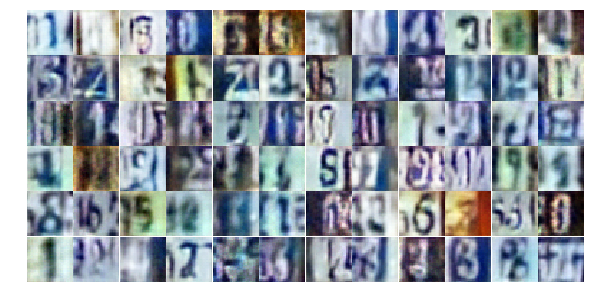

Epoch 9/15... Discriminator Loss: 0.7708... Generator Loss: 0.8900
Epoch 9/15... Discriminator Loss: 0.6760... Generator Loss: 1.2178
Epoch 9/15... Discriminator Loss: 0.9629... Generator Loss: 0.7266
Epoch 9/15... Discriminator Loss: 0.5245... Generator Loss: 1.7489
Epoch 9/15... Discriminator Loss: 1.0405... Generator Loss: 0.5985
Epoch 9/15... Discriminator Loss: 0.6441... Generator Loss: 2.1277
Epoch 9/15... Discriminator Loss: 0.8559... Generator Loss: 0.7516
Epoch 9/15... Discriminator Loss: 0.6419... Generator Loss: 1.0176
Epoch 9/15... Discriminator Loss: 0.6578... Generator Loss: 1.1106
Epoch 9/15... Discriminator Loss: 1.3291... Generator Loss: 0.4340


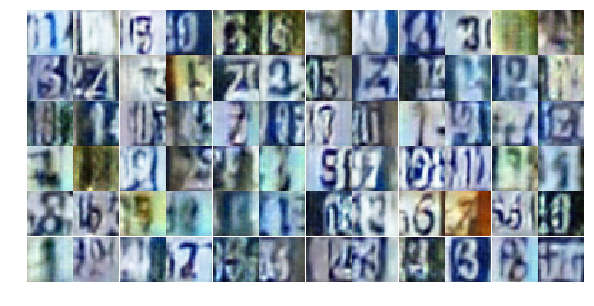

Epoch 9/15... Discriminator Loss: 0.7036... Generator Loss: 1.8990
Epoch 9/15... Discriminator Loss: 1.1116... Generator Loss: 0.5720
Epoch 9/15... Discriminator Loss: 0.7409... Generator Loss: 1.0146
Epoch 9/15... Discriminator Loss: 1.1590... Generator Loss: 0.5300
Epoch 9/15... Discriminator Loss: 0.6602... Generator Loss: 1.1477
Epoch 9/15... Discriminator Loss: 0.8244... Generator Loss: 1.0543
Epoch 9/15... Discriminator Loss: 1.2149... Generator Loss: 0.5163
Epoch 9/15... Discriminator Loss: 0.5331... Generator Loss: 1.4288
Epoch 9/15... Discriminator Loss: 0.8874... Generator Loss: 0.7972
Epoch 9/15... Discriminator Loss: 1.1885... Generator Loss: 0.5105


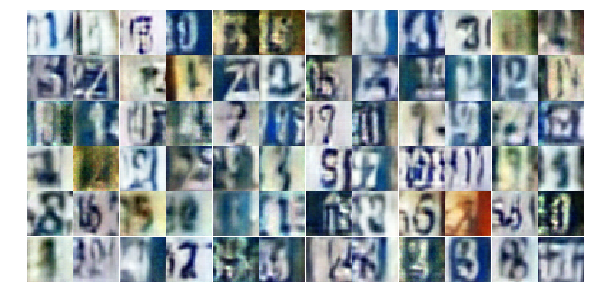

Epoch 9/15... Discriminator Loss: 1.0122... Generator Loss: 0.7041
Epoch 9/15... Discriminator Loss: 0.6260... Generator Loss: 1.1328
Epoch 9/15... Discriminator Loss: 0.6445... Generator Loss: 1.4649
Epoch 9/15... Discriminator Loss: 0.5668... Generator Loss: 1.2734
Epoch 9/15... Discriminator Loss: 0.4626... Generator Loss: 1.6541
Epoch 9/15... Discriminator Loss: 0.5569... Generator Loss: 1.1554
Epoch 9/15... Discriminator Loss: 0.7137... Generator Loss: 0.9453
Epoch 9/15... Discriminator Loss: 0.5647... Generator Loss: 1.3597
Epoch 9/15... Discriminator Loss: 0.5121... Generator Loss: 1.3344
Epoch 9/15... Discriminator Loss: 0.4292... Generator Loss: 1.6687


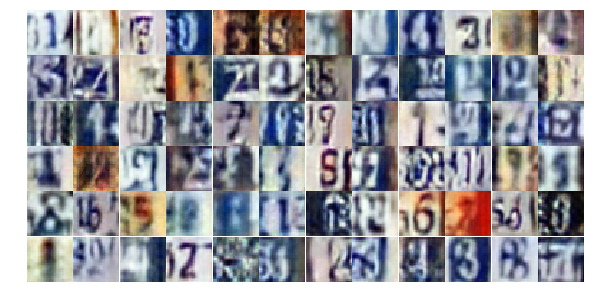

Epoch 9/15... Discriminator Loss: 0.6334... Generator Loss: 1.1056
Epoch 9/15... Discriminator Loss: 0.6212... Generator Loss: 1.1227
Epoch 9/15... Discriminator Loss: 2.1937... Generator Loss: 0.2516
Epoch 9/15... Discriminator Loss: 0.5642... Generator Loss: 1.4296
Epoch 9/15... Discriminator Loss: 0.6804... Generator Loss: 1.2200
Epoch 9/15... Discriminator Loss: 0.6472... Generator Loss: 1.5902
Epoch 9/15... Discriminator Loss: 0.7180... Generator Loss: 1.3256
Epoch 9/15... Discriminator Loss: 0.4204... Generator Loss: 1.5076
Epoch 9/15... Discriminator Loss: 0.8084... Generator Loss: 0.8623
Epoch 9/15... Discriminator Loss: 0.9420... Generator Loss: 0.7196


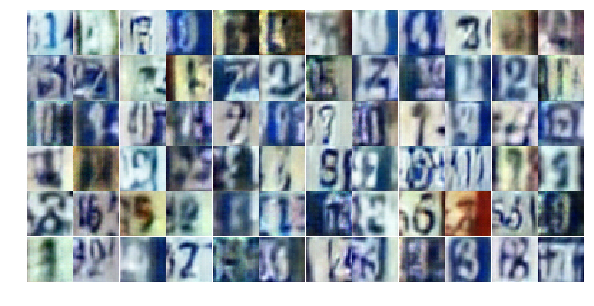

Epoch 9/15... Discriminator Loss: 0.5391... Generator Loss: 1.4419
Epoch 9/15... Discriminator Loss: 0.6343... Generator Loss: 1.0423
Epoch 9/15... Discriminator Loss: 0.4724... Generator Loss: 1.3600
Epoch 9/15... Discriminator Loss: 0.6885... Generator Loss: 1.1976
Epoch 9/15... Discriminator Loss: 0.4865... Generator Loss: 2.0344
Epoch 9/15... Discriminator Loss: 0.6839... Generator Loss: 1.0549
Epoch 9/15... Discriminator Loss: 0.7092... Generator Loss: 2.1412
Epoch 9/15... Discriminator Loss: 0.9519... Generator Loss: 0.6666
Epoch 9/15... Discriminator Loss: 0.4730... Generator Loss: 1.5490
Epoch 9/15... Discriminator Loss: 0.5376... Generator Loss: 2.6720


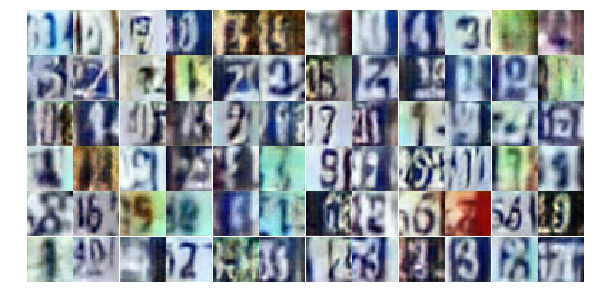

Epoch 9/15... Discriminator Loss: 1.3697... Generator Loss: 1.0325
Epoch 9/15... Discriminator Loss: 0.7594... Generator Loss: 1.2384
Epoch 9/15... Discriminator Loss: 0.7411... Generator Loss: 1.0848
Epoch 9/15... Discriminator Loss: 1.0933... Generator Loss: 0.6058
Epoch 9/15... Discriminator Loss: 0.5924... Generator Loss: 1.6068
Epoch 10/15... Discriminator Loss: 0.6222... Generator Loss: 0.9699
Epoch 10/15... Discriminator Loss: 0.5109... Generator Loss: 1.4336
Epoch 10/15... Discriminator Loss: 0.6286... Generator Loss: 1.1722
Epoch 10/15... Discriminator Loss: 0.9279... Generator Loss: 0.6829
Epoch 10/15... Discriminator Loss: 1.6845... Generator Loss: 0.2927


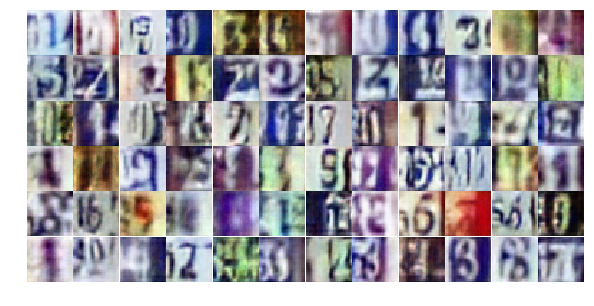

Epoch 10/15... Discriminator Loss: 0.9921... Generator Loss: 0.7263
Epoch 10/15... Discriminator Loss: 0.6062... Generator Loss: 1.0632
Epoch 10/15... Discriminator Loss: 0.6972... Generator Loss: 1.0540
Epoch 10/15... Discriminator Loss: 0.5899... Generator Loss: 1.4194
Epoch 10/15... Discriminator Loss: 0.5540... Generator Loss: 1.3336
Epoch 10/15... Discriminator Loss: 0.6701... Generator Loss: 1.4741
Epoch 10/15... Discriminator Loss: 0.4858... Generator Loss: 1.5123
Epoch 10/15... Discriminator Loss: 1.3484... Generator Loss: 0.4713
Epoch 10/15... Discriminator Loss: 0.8630... Generator Loss: 1.3638
Epoch 10/15... Discriminator Loss: 0.5143... Generator Loss: 1.5891


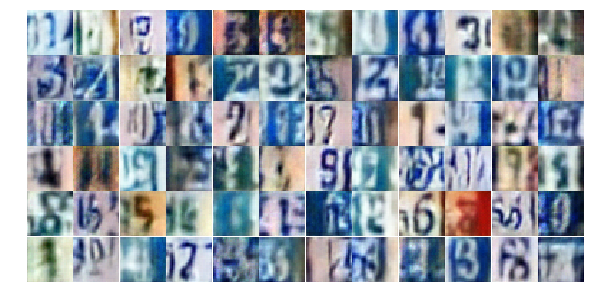

Epoch 10/15... Discriminator Loss: 1.5260... Generator Loss: 1.5507
Epoch 10/15... Discriminator Loss: 0.8851... Generator Loss: 0.8180
Epoch 10/15... Discriminator Loss: 0.6645... Generator Loss: 1.0454
Epoch 10/15... Discriminator Loss: 1.2453... Generator Loss: 0.4786
Epoch 10/15... Discriminator Loss: 0.5804... Generator Loss: 1.1522
Epoch 10/15... Discriminator Loss: 0.4782... Generator Loss: 1.4404
Epoch 10/15... Discriminator Loss: 0.7791... Generator Loss: 0.8123
Epoch 10/15... Discriminator Loss: 0.5646... Generator Loss: 1.2682
Epoch 10/15... Discriminator Loss: 0.7803... Generator Loss: 0.9656
Epoch 10/15... Discriminator Loss: 0.4273... Generator Loss: 3.0008


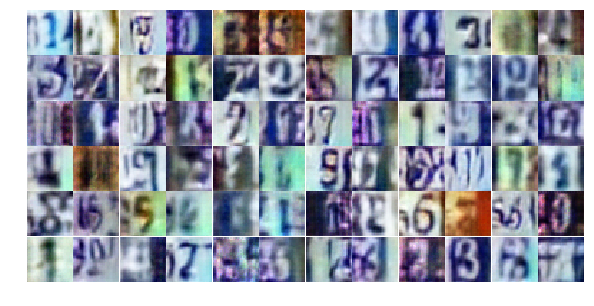

Epoch 10/15... Discriminator Loss: 1.0082... Generator Loss: 0.6072
Epoch 10/15... Discriminator Loss: 0.7659... Generator Loss: 0.9437
Epoch 10/15... Discriminator Loss: 0.5995... Generator Loss: 1.1420
Epoch 10/15... Discriminator Loss: 0.4167... Generator Loss: 1.5042
Epoch 10/15... Discriminator Loss: 1.4314... Generator Loss: 0.3540
Epoch 10/15... Discriminator Loss: 0.7208... Generator Loss: 1.2286
Epoch 10/15... Discriminator Loss: 0.3660... Generator Loss: 1.6532
Epoch 10/15... Discriminator Loss: 0.6110... Generator Loss: 1.2227
Epoch 10/15... Discriminator Loss: 0.7171... Generator Loss: 1.1344
Epoch 10/15... Discriminator Loss: 1.0704... Generator Loss: 0.5582


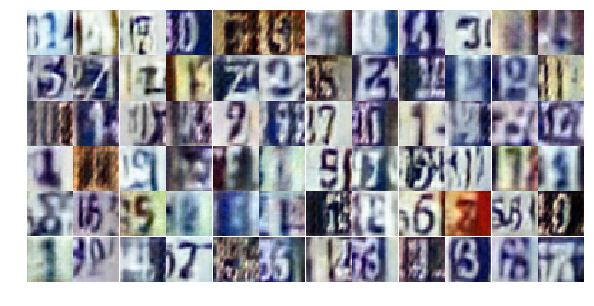

Epoch 10/15... Discriminator Loss: 0.6381... Generator Loss: 1.4987
Epoch 10/15... Discriminator Loss: 0.7030... Generator Loss: 0.9807
Epoch 10/15... Discriminator Loss: 0.5028... Generator Loss: 1.2816
Epoch 10/15... Discriminator Loss: 0.8139... Generator Loss: 0.9110
Epoch 10/15... Discriminator Loss: 0.7325... Generator Loss: 0.9264
Epoch 10/15... Discriminator Loss: 1.0111... Generator Loss: 0.5924
Epoch 10/15... Discriminator Loss: 0.8720... Generator Loss: 0.7610
Epoch 10/15... Discriminator Loss: 0.8746... Generator Loss: 0.7533
Epoch 10/15... Discriminator Loss: 0.5211... Generator Loss: 1.3235
Epoch 10/15... Discriminator Loss: 0.5614... Generator Loss: 2.1889


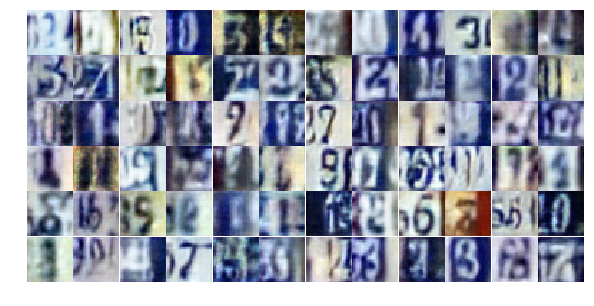

Epoch 10/15... Discriminator Loss: 0.8434... Generator Loss: 0.7376
Epoch 10/15... Discriminator Loss: 0.8449... Generator Loss: 1.0888
Epoch 10/15... Discriminator Loss: 0.7677... Generator Loss: 0.8388
Epoch 10/15... Discriminator Loss: 0.7819... Generator Loss: 1.2263
Epoch 10/15... Discriminator Loss: 0.7567... Generator Loss: 1.6258
Epoch 10/15... Discriminator Loss: 0.5640... Generator Loss: 1.4839
Epoch 10/15... Discriminator Loss: 0.8237... Generator Loss: 0.7941
Epoch 10/15... Discriminator Loss: 1.9931... Generator Loss: 5.0577
Epoch 10/15... Discriminator Loss: 0.4495... Generator Loss: 3.0859
Epoch 10/15... Discriminator Loss: 0.9937... Generator Loss: 0.7016


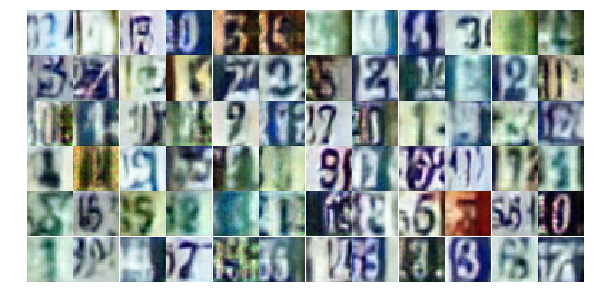

Epoch 10/15... Discriminator Loss: 0.8651... Generator Loss: 0.9507
Epoch 10/15... Discriminator Loss: 0.6756... Generator Loss: 1.0197
Epoch 10/15... Discriminator Loss: 0.6642... Generator Loss: 1.0032
Epoch 11/15... Discriminator Loss: 0.8102... Generator Loss: 1.1633
Epoch 11/15... Discriminator Loss: 0.6842... Generator Loss: 1.3235
Epoch 11/15... Discriminator Loss: 1.1481... Generator Loss: 0.5013
Epoch 11/15... Discriminator Loss: 0.7564... Generator Loss: 1.2751
Epoch 11/15... Discriminator Loss: 0.6819... Generator Loss: 1.3830
Epoch 11/15... Discriminator Loss: 1.5891... Generator Loss: 0.3438
Epoch 11/15... Discriminator Loss: 0.4667... Generator Loss: 1.6057


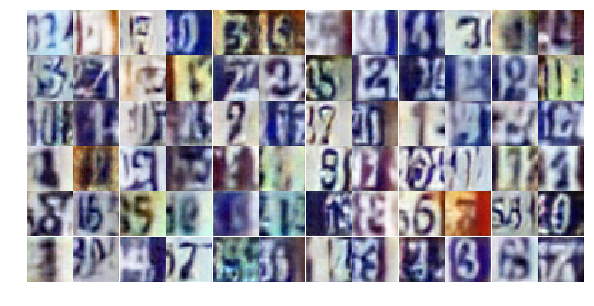

Epoch 11/15... Discriminator Loss: 0.5477... Generator Loss: 1.3465
Epoch 11/15... Discriminator Loss: 0.7137... Generator Loss: 0.9993
Epoch 11/15... Discriminator Loss: 0.5393... Generator Loss: 1.2073
Epoch 11/15... Discriminator Loss: 0.7160... Generator Loss: 0.9265
Epoch 11/15... Discriminator Loss: 0.6808... Generator Loss: 1.0486
Epoch 11/15... Discriminator Loss: 0.4641... Generator Loss: 1.5999
Epoch 11/15... Discriminator Loss: 0.6848... Generator Loss: 1.9814
Epoch 11/15... Discriminator Loss: 0.3250... Generator Loss: 2.0945
Epoch 11/15... Discriminator Loss: 0.5016... Generator Loss: 1.3731
Epoch 11/15... Discriminator Loss: 1.3772... Generator Loss: 0.4741


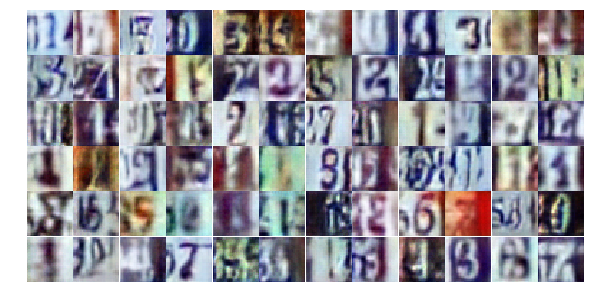

Epoch 11/15... Discriminator Loss: 0.5902... Generator Loss: 1.1370
Epoch 11/15... Discriminator Loss: 0.5966... Generator Loss: 2.0785
Epoch 11/15... Discriminator Loss: 0.9227... Generator Loss: 0.7012
Epoch 11/15... Discriminator Loss: 0.6590... Generator Loss: 1.2317
Epoch 11/15... Discriminator Loss: 0.3361... Generator Loss: 2.2373
Epoch 11/15... Discriminator Loss: 0.3964... Generator Loss: 1.7973
Epoch 11/15... Discriminator Loss: 0.5541... Generator Loss: 1.3056
Epoch 11/15... Discriminator Loss: 0.9187... Generator Loss: 0.7808
Epoch 11/15... Discriminator Loss: 0.5578... Generator Loss: 1.5399
Epoch 11/15... Discriminator Loss: 1.4163... Generator Loss: 0.3971


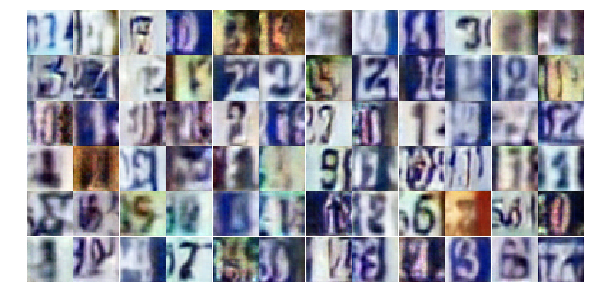

Epoch 11/15... Discriminator Loss: 0.7788... Generator Loss: 0.9087
Epoch 11/15... Discriminator Loss: 0.6638... Generator Loss: 1.8411
Epoch 11/15... Discriminator Loss: 0.7485... Generator Loss: 1.1164
Epoch 11/15... Discriminator Loss: 0.5098... Generator Loss: 2.2708
Epoch 11/15... Discriminator Loss: 1.0100... Generator Loss: 0.6447
Epoch 11/15... Discriminator Loss: 0.8263... Generator Loss: 0.7733
Epoch 11/15... Discriminator Loss: 1.0782... Generator Loss: 0.7795
Epoch 11/15... Discriminator Loss: 1.1076... Generator Loss: 0.5707
Epoch 11/15... Discriminator Loss: 0.5641... Generator Loss: 1.2586
Epoch 11/15... Discriminator Loss: 1.1586... Generator Loss: 0.4989


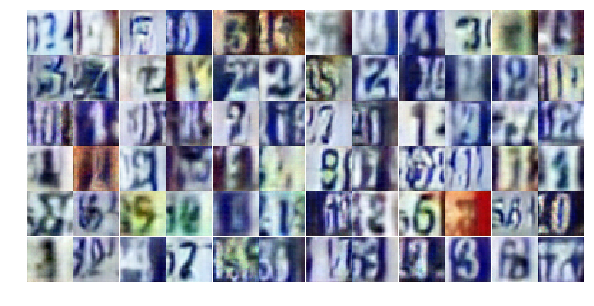

Epoch 11/15... Discriminator Loss: 0.4299... Generator Loss: 1.5645
Epoch 11/15... Discriminator Loss: 0.4303... Generator Loss: 1.4706
Epoch 11/15... Discriminator Loss: 0.5356... Generator Loss: 1.2491
Epoch 11/15... Discriminator Loss: 0.5828... Generator Loss: 1.2556
Epoch 11/15... Discriminator Loss: 0.8037... Generator Loss: 0.8090
Epoch 11/15... Discriminator Loss: 0.8373... Generator Loss: 0.7482
Epoch 11/15... Discriminator Loss: 1.5723... Generator Loss: 0.4848
Epoch 11/15... Discriminator Loss: 1.0061... Generator Loss: 0.7163
Epoch 11/15... Discriminator Loss: 1.6122... Generator Loss: 0.3497
Epoch 11/15... Discriminator Loss: 0.5057... Generator Loss: 1.2656


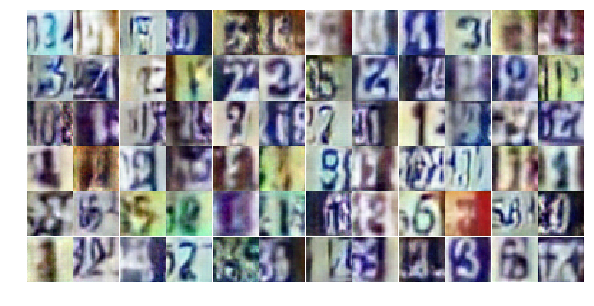

Epoch 11/15... Discriminator Loss: 0.8145... Generator Loss: 0.9150
Epoch 11/15... Discriminator Loss: 0.4886... Generator Loss: 1.8212
Epoch 11/15... Discriminator Loss: 0.5715... Generator Loss: 1.5188
Epoch 11/15... Discriminator Loss: 0.6063... Generator Loss: 1.1002
Epoch 11/15... Discriminator Loss: 1.0996... Generator Loss: 0.6513
Epoch 11/15... Discriminator Loss: 0.5408... Generator Loss: 1.3199
Epoch 11/15... Discriminator Loss: 1.5261... Generator Loss: 0.4205
Epoch 11/15... Discriminator Loss: 0.5955... Generator Loss: 1.8317
Epoch 11/15... Discriminator Loss: 1.0117... Generator Loss: 0.6258
Epoch 11/15... Discriminator Loss: 0.7730... Generator Loss: 1.0343


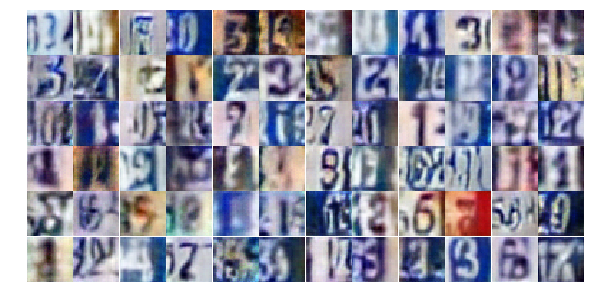

Epoch 12/15... Discriminator Loss: 0.5758... Generator Loss: 1.4811
Epoch 12/15... Discriminator Loss: 0.7940... Generator Loss: 0.9950
Epoch 12/15... Discriminator Loss: 0.9218... Generator Loss: 0.8334
Epoch 12/15... Discriminator Loss: 0.5645... Generator Loss: 1.2521
Epoch 12/15... Discriminator Loss: 0.4770... Generator Loss: 1.3428
Epoch 12/15... Discriminator Loss: 0.9329... Generator Loss: 0.6587
Epoch 12/15... Discriminator Loss: 0.6959... Generator Loss: 1.1748
Epoch 12/15... Discriminator Loss: 0.4841... Generator Loss: 1.6059
Epoch 12/15... Discriminator Loss: 1.0763... Generator Loss: 2.2987
Epoch 12/15... Discriminator Loss: 1.3021... Generator Loss: 0.4652


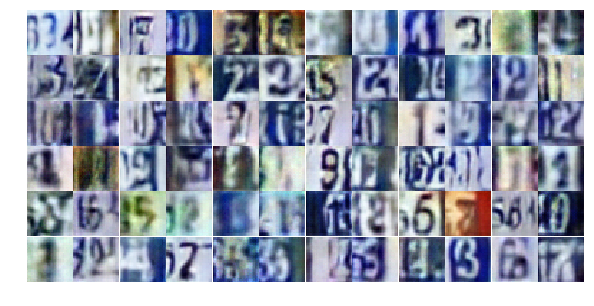

Epoch 12/15... Discriminator Loss: 0.4269... Generator Loss: 2.2957
Epoch 12/15... Discriminator Loss: 0.6565... Generator Loss: 1.0350
Epoch 12/15... Discriminator Loss: 0.6441... Generator Loss: 1.0282
Epoch 12/15... Discriminator Loss: 0.7005... Generator Loss: 1.7986
Epoch 12/15... Discriminator Loss: 0.6300... Generator Loss: 1.7641
Epoch 12/15... Discriminator Loss: 1.0624... Generator Loss: 0.6404
Epoch 12/15... Discriminator Loss: 1.6555... Generator Loss: 0.3168
Epoch 12/15... Discriminator Loss: 0.4779... Generator Loss: 2.0369
Epoch 12/15... Discriminator Loss: 0.5007... Generator Loss: 1.2613
Epoch 12/15... Discriminator Loss: 1.0138... Generator Loss: 0.6367


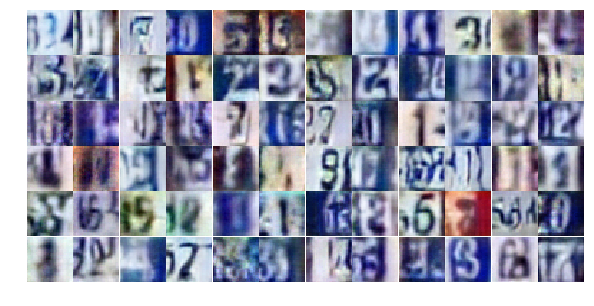

Epoch 12/15... Discriminator Loss: 0.4603... Generator Loss: 1.5073
Epoch 12/15... Discriminator Loss: 0.4844... Generator Loss: 1.3155
Epoch 12/15... Discriminator Loss: 0.5637... Generator Loss: 1.2780
Epoch 12/15... Discriminator Loss: 0.5007... Generator Loss: 1.4709
Epoch 12/15... Discriminator Loss: 0.4909... Generator Loss: 1.4762
Epoch 12/15... Discriminator Loss: 0.5558... Generator Loss: 1.1908
Epoch 12/15... Discriminator Loss: 0.7434... Generator Loss: 0.8994
Epoch 12/15... Discriminator Loss: 0.4217... Generator Loss: 1.5893
Epoch 12/15... Discriminator Loss: 0.6697... Generator Loss: 1.0467
Epoch 12/15... Discriminator Loss: 0.6844... Generator Loss: 0.9854


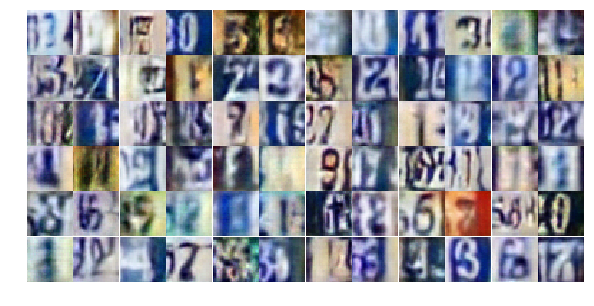

Epoch 12/15... Discriminator Loss: 0.8035... Generator Loss: 0.8625
Epoch 12/15... Discriminator Loss: 0.9598... Generator Loss: 0.6686
Epoch 12/15... Discriminator Loss: 0.7632... Generator Loss: 0.8711
Epoch 12/15... Discriminator Loss: 2.2312... Generator Loss: 0.1811
Epoch 12/15... Discriminator Loss: 0.6198... Generator Loss: 1.9938
Epoch 12/15... Discriminator Loss: 1.0054... Generator Loss: 0.7289
Epoch 12/15... Discriminator Loss: 1.1505... Generator Loss: 0.5536
Epoch 12/15... Discriminator Loss: 0.8247... Generator Loss: 0.8705
Epoch 12/15... Discriminator Loss: 0.5044... Generator Loss: 1.6494
Epoch 12/15... Discriminator Loss: 0.3909... Generator Loss: 1.5801


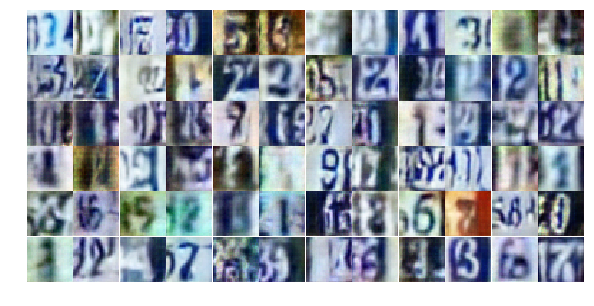

Epoch 12/15... Discriminator Loss: 0.5508... Generator Loss: 1.1648
Epoch 12/15... Discriminator Loss: 0.3748... Generator Loss: 1.5665
Epoch 12/15... Discriminator Loss: 0.4594... Generator Loss: 1.4417
Epoch 12/15... Discriminator Loss: 0.8869... Generator Loss: 0.7823
Epoch 12/15... Discriminator Loss: 0.9569... Generator Loss: 0.6901
Epoch 12/15... Discriminator Loss: 1.1792... Generator Loss: 0.4919
Epoch 12/15... Discriminator Loss: 0.9224... Generator Loss: 0.6835
Epoch 12/15... Discriminator Loss: 0.8491... Generator Loss: 0.8705
Epoch 12/15... Discriminator Loss: 0.6696... Generator Loss: 0.9824
Epoch 12/15... Discriminator Loss: 0.6670... Generator Loss: 1.1426


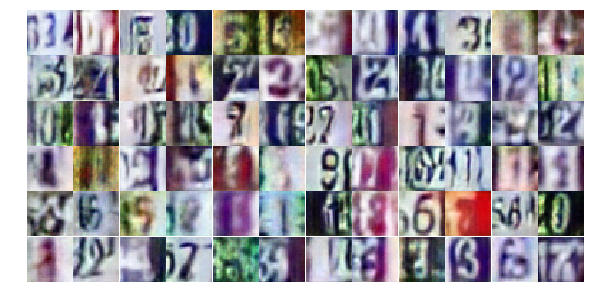

Epoch 12/15... Discriminator Loss: 0.9971... Generator Loss: 0.7068
Epoch 12/15... Discriminator Loss: 0.5967... Generator Loss: 1.2971
Epoch 12/15... Discriminator Loss: 1.0473... Generator Loss: 0.7253
Epoch 12/15... Discriminator Loss: 1.0805... Generator Loss: 0.7065
Epoch 12/15... Discriminator Loss: 0.6601... Generator Loss: 1.0292
Epoch 12/15... Discriminator Loss: 0.6350... Generator Loss: 1.3131
Epoch 12/15... Discriminator Loss: 0.9761... Generator Loss: 0.6536
Epoch 13/15... Discriminator Loss: 0.5869... Generator Loss: 1.2236
Epoch 13/15... Discriminator Loss: 0.5048... Generator Loss: 1.3644
Epoch 13/15... Discriminator Loss: 0.8178... Generator Loss: 0.8565


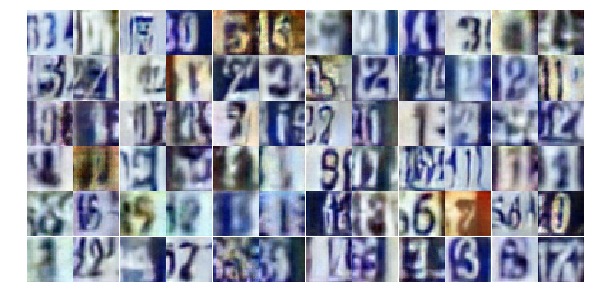

Epoch 13/15... Discriminator Loss: 0.4714... Generator Loss: 1.5286
Epoch 13/15... Discriminator Loss: 0.7205... Generator Loss: 1.1285
Epoch 13/15... Discriminator Loss: 1.1363... Generator Loss: 0.5198
Epoch 13/15... Discriminator Loss: 1.4356... Generator Loss: 0.4103
Epoch 13/15... Discriminator Loss: 0.8360... Generator Loss: 0.8277
Epoch 13/15... Discriminator Loss: 0.5042... Generator Loss: 1.4366
Epoch 13/15... Discriminator Loss: 0.4636... Generator Loss: 1.7726
Epoch 13/15... Discriminator Loss: 0.7581... Generator Loss: 0.8089
Epoch 13/15... Discriminator Loss: 0.6057... Generator Loss: 1.1207
Epoch 13/15... Discriminator Loss: 0.5543... Generator Loss: 1.5623


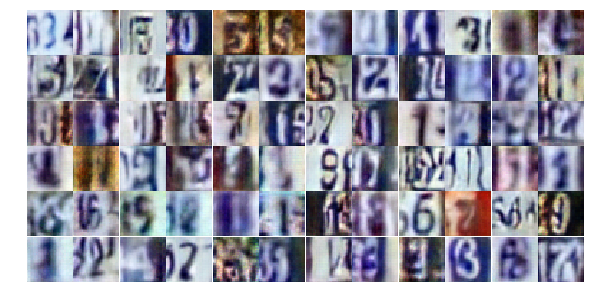

Epoch 13/15... Discriminator Loss: 0.8686... Generator Loss: 0.8712
Epoch 13/15... Discriminator Loss: 0.7032... Generator Loss: 0.9901
Epoch 13/15... Discriminator Loss: 1.2089... Generator Loss: 0.5237
Epoch 13/15... Discriminator Loss: 0.6679... Generator Loss: 1.3572
Epoch 13/15... Discriminator Loss: 0.6658... Generator Loss: 1.3085
Epoch 13/15... Discriminator Loss: 0.6954... Generator Loss: 1.1963
Epoch 13/15... Discriminator Loss: 0.7204... Generator Loss: 0.9484
Epoch 13/15... Discriminator Loss: 0.9831... Generator Loss: 0.6799
Epoch 13/15... Discriminator Loss: 0.5863... Generator Loss: 1.2779
Epoch 13/15... Discriminator Loss: 0.8563... Generator Loss: 0.8374


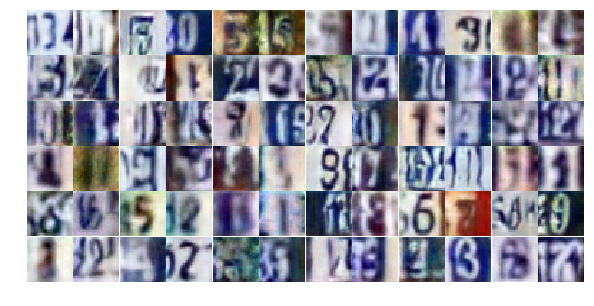

Epoch 13/15... Discriminator Loss: 0.8074... Generator Loss: 0.8297
Epoch 13/15... Discriminator Loss: 0.5587... Generator Loss: 1.4111
Epoch 13/15... Discriminator Loss: 0.6047... Generator Loss: 1.3722
Epoch 13/15... Discriminator Loss: 0.7653... Generator Loss: 0.9005
Epoch 13/15... Discriminator Loss: 0.6443... Generator Loss: 1.2933
Epoch 13/15... Discriminator Loss: 0.6291... Generator Loss: 1.1506
Epoch 13/15... Discriminator Loss: 1.2229... Generator Loss: 1.7335
Epoch 13/15... Discriminator Loss: 0.5562... Generator Loss: 1.3536
Epoch 13/15... Discriminator Loss: 0.4302... Generator Loss: 1.6737
Epoch 13/15... Discriminator Loss: 0.6130... Generator Loss: 1.3723


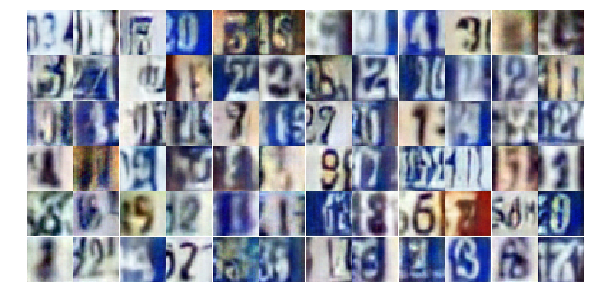

Epoch 13/15... Discriminator Loss: 1.1949... Generator Loss: 0.5092
Epoch 13/15... Discriminator Loss: 0.6848... Generator Loss: 1.2462
Epoch 13/15... Discriminator Loss: 1.0470... Generator Loss: 0.6215
Epoch 13/15... Discriminator Loss: 1.0790... Generator Loss: 0.5957
Epoch 13/15... Discriminator Loss: 0.6044... Generator Loss: 1.1542
Epoch 13/15... Discriminator Loss: 0.5589... Generator Loss: 1.1560
Epoch 13/15... Discriminator Loss: 0.6574... Generator Loss: 1.0361
Epoch 13/15... Discriminator Loss: 0.7461... Generator Loss: 1.4473
Epoch 13/15... Discriminator Loss: 0.5055... Generator Loss: 1.3665
Epoch 13/15... Discriminator Loss: 0.8070... Generator Loss: 0.7897


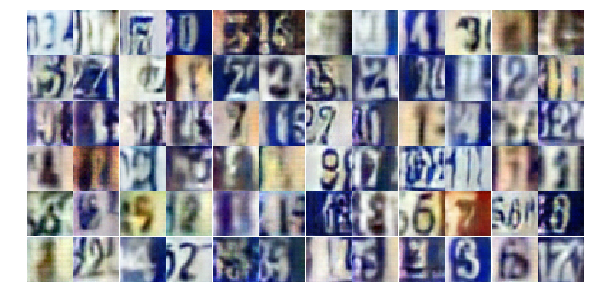

Epoch 13/15... Discriminator Loss: 0.4690... Generator Loss: 1.5930
Epoch 13/15... Discriminator Loss: 1.2942... Generator Loss: 0.4529
Epoch 13/15... Discriminator Loss: 0.8133... Generator Loss: 0.8914
Epoch 13/15... Discriminator Loss: 0.4167... Generator Loss: 1.6346
Epoch 13/15... Discriminator Loss: 1.1014... Generator Loss: 0.6314
Epoch 13/15... Discriminator Loss: 0.6406... Generator Loss: 1.0839
Epoch 13/15... Discriminator Loss: 0.8192... Generator Loss: 0.8945
Epoch 13/15... Discriminator Loss: 0.6048... Generator Loss: 1.3533
Epoch 13/15... Discriminator Loss: 1.0326... Generator Loss: 0.5887
Epoch 13/15... Discriminator Loss: 0.8246... Generator Loss: 0.7678


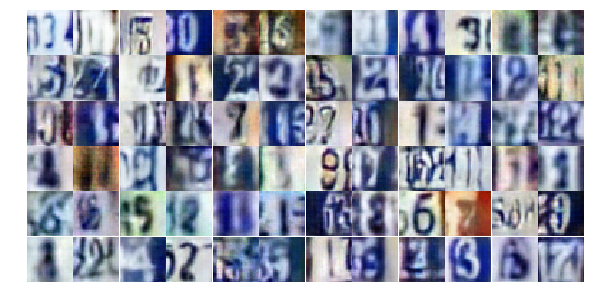

Epoch 13/15... Discriminator Loss: 0.4266... Generator Loss: 1.8623
Epoch 13/15... Discriminator Loss: 2.9117... Generator Loss: 0.2452
Epoch 13/15... Discriminator Loss: 2.0858... Generator Loss: 0.5644
Epoch 13/15... Discriminator Loss: 1.6718... Generator Loss: 1.4941
Epoch 14/15... Discriminator Loss: 0.9831... Generator Loss: 1.8689
Epoch 14/15... Discriminator Loss: 0.9345... Generator Loss: 0.9366
Epoch 14/15... Discriminator Loss: 0.7688... Generator Loss: 1.2083
Epoch 14/15... Discriminator Loss: 0.7902... Generator Loss: 1.2530
Epoch 14/15... Discriminator Loss: 0.6789... Generator Loss: 1.0742
Epoch 14/15... Discriminator Loss: 0.6352... Generator Loss: 1.1031


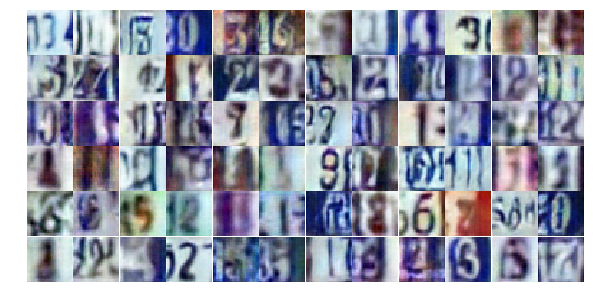

Epoch 14/15... Discriminator Loss: 0.9268... Generator Loss: 1.6209
Epoch 14/15... Discriminator Loss: 0.9984... Generator Loss: 0.5788
Epoch 14/15... Discriminator Loss: 0.7084... Generator Loss: 1.2930
Epoch 14/15... Discriminator Loss: 0.7332... Generator Loss: 0.9848
Epoch 14/15... Discriminator Loss: 1.0263... Generator Loss: 0.6152
Epoch 14/15... Discriminator Loss: 0.3732... Generator Loss: 1.7608
Epoch 14/15... Discriminator Loss: 0.5559... Generator Loss: 1.3790
Epoch 14/15... Discriminator Loss: 1.2873... Generator Loss: 0.4168
Epoch 14/15... Discriminator Loss: 0.9819... Generator Loss: 0.6347
Epoch 14/15... Discriminator Loss: 1.3653... Generator Loss: 0.3833


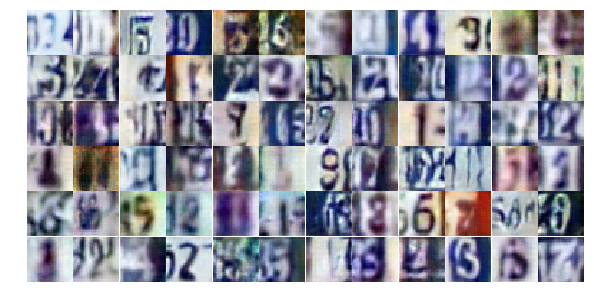

Epoch 14/15... Discriminator Loss: 0.5707... Generator Loss: 1.0611
Epoch 14/15... Discriminator Loss: 0.4470... Generator Loss: 1.9053
Epoch 14/15... Discriminator Loss: 0.9147... Generator Loss: 0.7953
Epoch 14/15... Discriminator Loss: 0.4292... Generator Loss: 1.6294
Epoch 14/15... Discriminator Loss: 0.9468... Generator Loss: 0.7166
Epoch 14/15... Discriminator Loss: 0.8347... Generator Loss: 0.9029
Epoch 14/15... Discriminator Loss: 0.9932... Generator Loss: 0.6298
Epoch 14/15... Discriminator Loss: 0.4949... Generator Loss: 1.3551
Epoch 14/15... Discriminator Loss: 0.6695... Generator Loss: 1.0802
Epoch 14/15... Discriminator Loss: 0.5246... Generator Loss: 1.5706


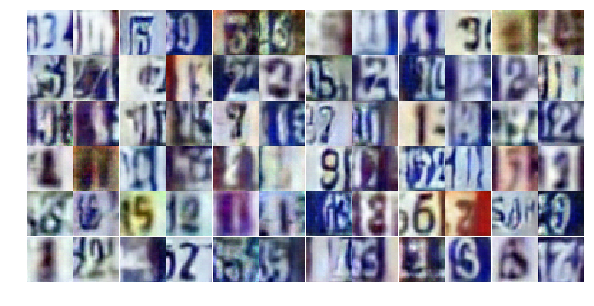

Epoch 14/15... Discriminator Loss: 1.2332... Generator Loss: 0.5179
Epoch 14/15... Discriminator Loss: 0.4448... Generator Loss: 1.4882
Epoch 14/15... Discriminator Loss: 0.7275... Generator Loss: 2.2215
Epoch 14/15... Discriminator Loss: 0.3914... Generator Loss: 1.7639
Epoch 14/15... Discriminator Loss: 0.6685... Generator Loss: 1.0546
Epoch 14/15... Discriminator Loss: 0.6697... Generator Loss: 1.1648
Epoch 14/15... Discriminator Loss: 0.9144... Generator Loss: 0.7563
Epoch 14/15... Discriminator Loss: 0.3943... Generator Loss: 1.9990
Epoch 14/15... Discriminator Loss: 0.3893... Generator Loss: 2.0474
Epoch 14/15... Discriminator Loss: 0.7075... Generator Loss: 1.0404


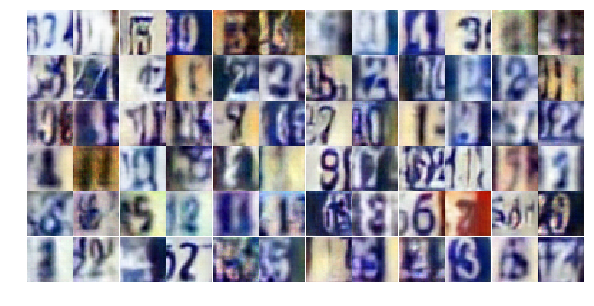

Epoch 14/15... Discriminator Loss: 1.2669... Generator Loss: 0.4949
Epoch 14/15... Discriminator Loss: 0.8052... Generator Loss: 0.9494
Epoch 14/15... Discriminator Loss: 0.8796... Generator Loss: 0.7674
Epoch 14/15... Discriminator Loss: 1.0170... Generator Loss: 0.6253
Epoch 14/15... Discriminator Loss: 1.2193... Generator Loss: 0.4820
Epoch 14/15... Discriminator Loss: 0.6490... Generator Loss: 1.3429
Epoch 14/15... Discriminator Loss: 0.8465... Generator Loss: 0.8006
Epoch 14/15... Discriminator Loss: 0.5594... Generator Loss: 1.5228
Epoch 14/15... Discriminator Loss: 1.7447... Generator Loss: 0.2638
Epoch 14/15... Discriminator Loss: 1.1500... Generator Loss: 0.6850


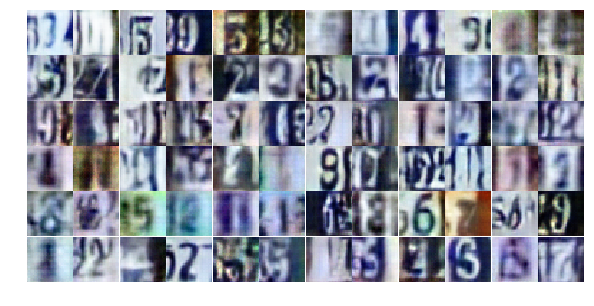

Epoch 14/15... Discriminator Loss: 0.8863... Generator Loss: 1.5104
Epoch 14/15... Discriminator Loss: 1.0072... Generator Loss: 0.6036
Epoch 14/15... Discriminator Loss: 0.5166... Generator Loss: 1.6058
Epoch 14/15... Discriminator Loss: 1.0140... Generator Loss: 0.5980
Epoch 14/15... Discriminator Loss: 0.5110... Generator Loss: 1.4789
Epoch 14/15... Discriminator Loss: 0.6817... Generator Loss: 1.0434
Epoch 14/15... Discriminator Loss: 1.7059... Generator Loss: 4.0042
Epoch 14/15... Discriminator Loss: 1.0195... Generator Loss: 1.0250
Epoch 14/15... Discriminator Loss: 1.1751... Generator Loss: 0.5688
Epoch 14/15... Discriminator Loss: 1.1297... Generator Loss: 0.5868


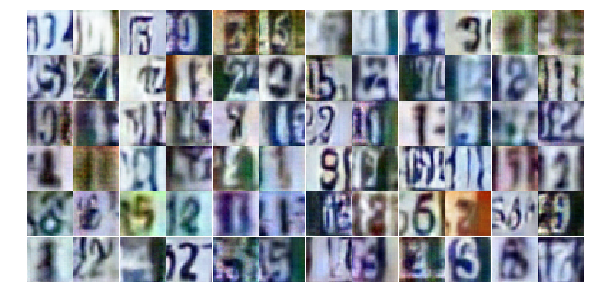

Epoch 14/15... Discriminator Loss: 1.0525... Generator Loss: 2.2868
Epoch 14/15... Discriminator Loss: 1.1220... Generator Loss: 0.5859
Epoch 15/15... Discriminator Loss: 0.7588... Generator Loss: 1.0068
Epoch 15/15... Discriminator Loss: 0.5447... Generator Loss: 1.3990
Epoch 15/15... Discriminator Loss: 0.6069... Generator Loss: 1.1347
Epoch 15/15... Discriminator Loss: 0.8252... Generator Loss: 0.7800
Epoch 15/15... Discriminator Loss: 0.7864... Generator Loss: 0.8290
Epoch 15/15... Discriminator Loss: 0.6000... Generator Loss: 1.1814
Epoch 15/15... Discriminator Loss: 1.1783... Generator Loss: 0.5448
Epoch 15/15... Discriminator Loss: 0.7584... Generator Loss: 0.8743


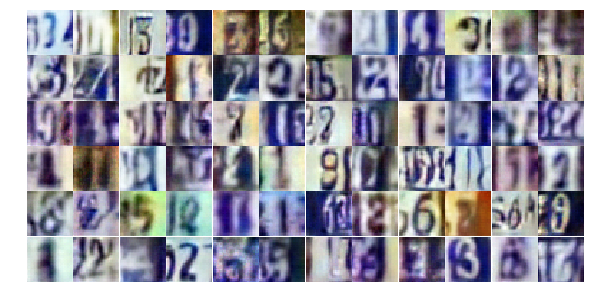

Epoch 15/15... Discriminator Loss: 0.8429... Generator Loss: 0.7507
Epoch 15/15... Discriminator Loss: 0.7643... Generator Loss: 1.6837
Epoch 15/15... Discriminator Loss: 0.8744... Generator Loss: 0.8427
Epoch 15/15... Discriminator Loss: 0.6422... Generator Loss: 1.1240
Epoch 15/15... Discriminator Loss: 0.9598... Generator Loss: 0.7733
Epoch 15/15... Discriminator Loss: 0.4974... Generator Loss: 1.7628
Epoch 15/15... Discriminator Loss: 0.9490... Generator Loss: 0.6483
Epoch 15/15... Discriminator Loss: 0.8265... Generator Loss: 0.9579
Epoch 15/15... Discriminator Loss: 0.5751... Generator Loss: 1.2230
Epoch 15/15... Discriminator Loss: 1.2306... Generator Loss: 0.4846


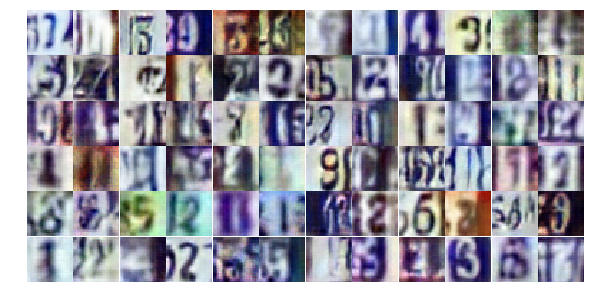

Epoch 15/15... Discriminator Loss: 0.8337... Generator Loss: 0.7978
Epoch 15/15... Discriminator Loss: 0.6672... Generator Loss: 0.9944
Epoch 15/15... Discriminator Loss: 0.5232... Generator Loss: 1.4446
Epoch 15/15... Discriminator Loss: 0.6592... Generator Loss: 0.9976
Epoch 15/15... Discriminator Loss: 1.0622... Generator Loss: 0.6275
Epoch 15/15... Discriminator Loss: 0.4984... Generator Loss: 1.5737
Epoch 15/15... Discriminator Loss: 0.9218... Generator Loss: 0.7814
Epoch 15/15... Discriminator Loss: 0.8655... Generator Loss: 0.7398
Epoch 15/15... Discriminator Loss: 0.5935... Generator Loss: 1.1310
Epoch 15/15... Discriminator Loss: 1.3980... Generator Loss: 0.3985


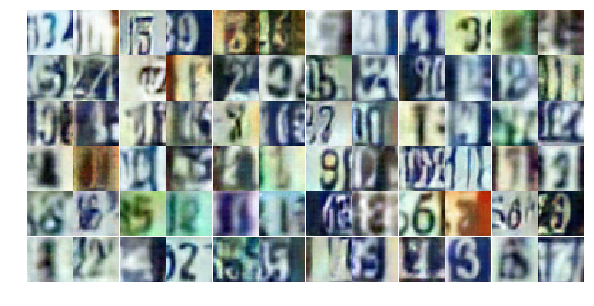

Epoch 15/15... Discriminator Loss: 0.8705... Generator Loss: 0.8190
Epoch 15/15... Discriminator Loss: 0.9682... Generator Loss: 0.7031
Epoch 15/15... Discriminator Loss: 0.4411... Generator Loss: 1.4781
Epoch 15/15... Discriminator Loss: 0.5869... Generator Loss: 1.5587
Epoch 15/15... Discriminator Loss: 0.5305... Generator Loss: 1.2886
Epoch 15/15... Discriminator Loss: 2.0114... Generator Loss: 3.8587
Epoch 15/15... Discriminator Loss: 0.7936... Generator Loss: 1.1088
Epoch 15/15... Discriminator Loss: 0.7677... Generator Loss: 0.9165
Epoch 15/15... Discriminator Loss: 0.6511... Generator Loss: 1.0083
Epoch 15/15... Discriminator Loss: 0.8774... Generator Loss: 0.8130


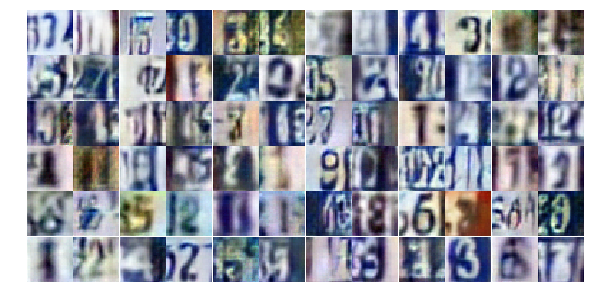

Epoch 15/15... Discriminator Loss: 0.9154... Generator Loss: 0.7492
Epoch 15/15... Discriminator Loss: 1.4737... Generator Loss: 0.3400
Epoch 15/15... Discriminator Loss: 0.5524... Generator Loss: 1.2218
Epoch 15/15... Discriminator Loss: 0.4835... Generator Loss: 1.3359
Epoch 15/15... Discriminator Loss: 0.4646... Generator Loss: 1.3735
Epoch 15/15... Discriminator Loss: 0.9872... Generator Loss: 1.1034
Epoch 15/15... Discriminator Loss: 0.6027... Generator Loss: 1.1682
Epoch 15/15... Discriminator Loss: 0.8279... Generator Loss: 1.0369
Epoch 15/15... Discriminator Loss: 0.5772... Generator Loss: 1.2921
Epoch 15/15... Discriminator Loss: 0.6370... Generator Loss: 1.2955


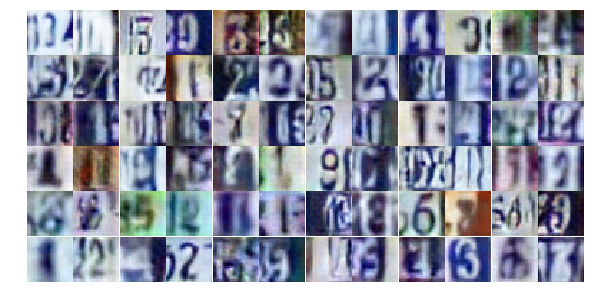

Epoch 15/15... Discriminator Loss: 0.8431... Generator Loss: 0.7697
Epoch 15/15... Discriminator Loss: 0.7514... Generator Loss: 0.9620
Epoch 15/15... Discriminator Loss: 0.4647... Generator Loss: 1.6730
Epoch 15/15... Discriminator Loss: 2.2697... Generator Loss: 0.1786
Epoch 15/15... Discriminator Loss: 1.3611... Generator Loss: 0.4821
Epoch 15/15... Discriminator Loss: 0.8762... Generator Loss: 0.8633
Epoch 15/15... Discriminator Loss: 0.9557... Generator Loss: 0.7120
Epoch 15/15... Discriminator Loss: 0.6386... Generator Loss: 1.1572
Epoch 15/15... Discriminator Loss: 1.9149... Generator Loss: 0.2192


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

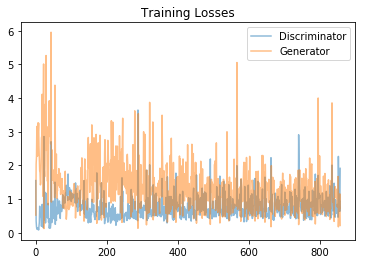

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

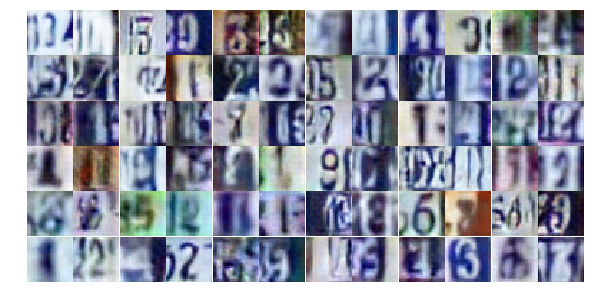

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

In [16]:
def re_train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        #sess.run(tf.global_variables_initializer())
        saver.restore(sess, './checkpoints/generator.ckpt')
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

Epoch 1/15... Discriminator Loss: 1.0855... Generator Loss: 1.9723
Epoch 1/15... Discriminator Loss: 1.1431... Generator Loss: 0.8004
Epoch 1/15... Discriminator Loss: 1.1648... Generator Loss: 0.5667
Epoch 1/15... Discriminator Loss: 1.1147... Generator Loss: 0.6759
Epoch 1/15... Discriminator Loss: 1.4933... Generator Loss: 0.3755
Epoch 1/15... Discriminator Loss: 0.8786... Generator Loss: 1.0992
Epoch 1/15... Discriminator Loss: 1.3489... Generator Loss: 0.4552
Epoch 1/15... Discriminator Loss: 1.4593... Generator Loss: 0.4234
Epoch 1/15... Discriminator Loss: 0.8710... Generator Loss: 0.8319
Epoch 1/15... Discriminator Loss: 1.3465... Generator Loss: 0.4638


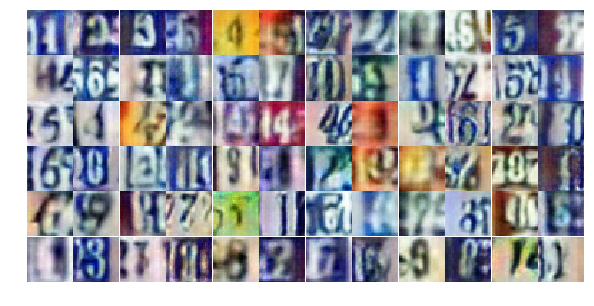

Epoch 1/15... Discriminator Loss: 1.3000... Generator Loss: 0.5302
Epoch 1/15... Discriminator Loss: 1.2496... Generator Loss: 0.6620
Epoch 1/15... Discriminator Loss: 0.9259... Generator Loss: 0.7812
Epoch 1/15... Discriminator Loss: 0.7568... Generator Loss: 1.4824
Epoch 1/15... Discriminator Loss: 1.3490... Generator Loss: 0.4202
Epoch 1/15... Discriminator Loss: 0.5870... Generator Loss: 1.3385
Epoch 1/15... Discriminator Loss: 1.0541... Generator Loss: 0.5709
Epoch 1/15... Discriminator Loss: 1.0447... Generator Loss: 0.6251
Epoch 1/15... Discriminator Loss: 0.7414... Generator Loss: 0.9429
Epoch 1/15... Discriminator Loss: 0.6992... Generator Loss: 0.9040


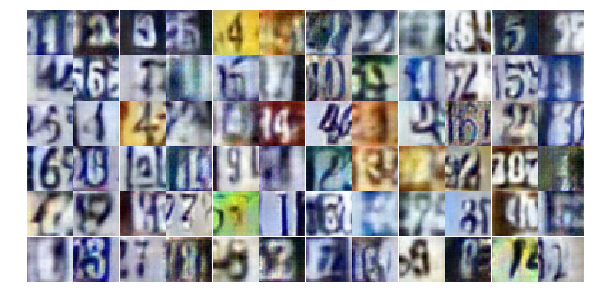

Epoch 1/15... Discriminator Loss: 0.9192... Generator Loss: 0.6969
Epoch 1/15... Discriminator Loss: 0.7058... Generator Loss: 1.0284
Epoch 1/15... Discriminator Loss: 0.8236... Generator Loss: 1.4052
Epoch 1/15... Discriminator Loss: 0.9417... Generator Loss: 1.1964
Epoch 1/15... Discriminator Loss: 0.9992... Generator Loss: 0.7848
Epoch 1/15... Discriminator Loss: 1.2874... Generator Loss: 0.5187
Epoch 1/15... Discriminator Loss: 0.8296... Generator Loss: 0.8746
Epoch 1/15... Discriminator Loss: 0.8307... Generator Loss: 0.9229
Epoch 1/15... Discriminator Loss: 1.1653... Generator Loss: 0.6212
Epoch 1/15... Discriminator Loss: 0.9623... Generator Loss: 0.8141


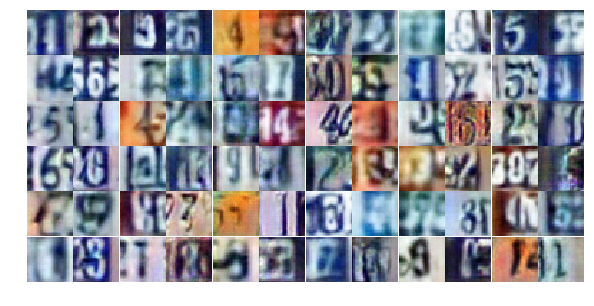

Epoch 1/15... Discriminator Loss: 1.3923... Generator Loss: 0.5295
Epoch 1/15... Discriminator Loss: 0.8588... Generator Loss: 0.8653
Epoch 1/15... Discriminator Loss: 1.1740... Generator Loss: 0.5375
Epoch 1/15... Discriminator Loss: 1.1878... Generator Loss: 0.5424
Epoch 1/15... Discriminator Loss: 1.5849... Generator Loss: 0.3814
Epoch 1/15... Discriminator Loss: 1.0541... Generator Loss: 0.6050
Epoch 1/15... Discriminator Loss: 0.6662... Generator Loss: 1.0567
Epoch 1/15... Discriminator Loss: 1.2628... Generator Loss: 0.4935
Epoch 1/15... Discriminator Loss: 0.4333... Generator Loss: 1.6426
Epoch 1/15... Discriminator Loss: 1.1680... Generator Loss: 0.5954


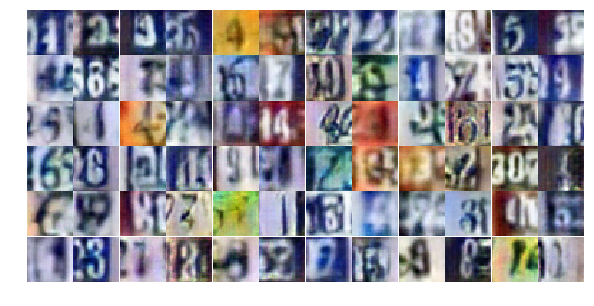

Epoch 1/15... Discriminator Loss: 1.5868... Generator Loss: 0.3534
Epoch 1/15... Discriminator Loss: 1.6089... Generator Loss: 0.4184
Epoch 1/15... Discriminator Loss: 1.5950... Generator Loss: 0.3001
Epoch 1/15... Discriminator Loss: 0.6617... Generator Loss: 0.9844
Epoch 1/15... Discriminator Loss: 1.1591... Generator Loss: 0.5099
Epoch 1/15... Discriminator Loss: 0.4778... Generator Loss: 1.4940
Epoch 1/15... Discriminator Loss: 1.0721... Generator Loss: 0.6472
Epoch 1/15... Discriminator Loss: 1.1087... Generator Loss: 0.5106
Epoch 1/15... Discriminator Loss: 1.1098... Generator Loss: 0.6526
Epoch 1/15... Discriminator Loss: 0.9722... Generator Loss: 0.8852


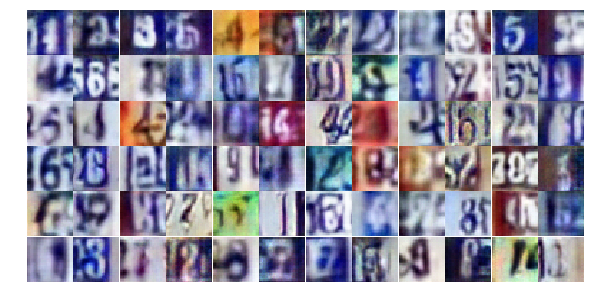

Epoch 1/15... Discriminator Loss: 0.8188... Generator Loss: 0.9148
Epoch 1/15... Discriminator Loss: 0.7253... Generator Loss: 0.8949
Epoch 1/15... Discriminator Loss: 1.5919... Generator Loss: 0.2929
Epoch 1/15... Discriminator Loss: 1.9509... Generator Loss: 0.1967
Epoch 1/15... Discriminator Loss: 0.8241... Generator Loss: 0.8828
Epoch 1/15... Discriminator Loss: 0.7701... Generator Loss: 1.7415
Epoch 1/15... Discriminator Loss: 0.9264... Generator Loss: 0.7198
Epoch 1/15... Discriminator Loss: 0.7753... Generator Loss: 1.2056
Epoch 1/15... Discriminator Loss: 0.8570... Generator Loss: 1.6644
Epoch 1/15... Discriminator Loss: 0.9947... Generator Loss: 0.6794


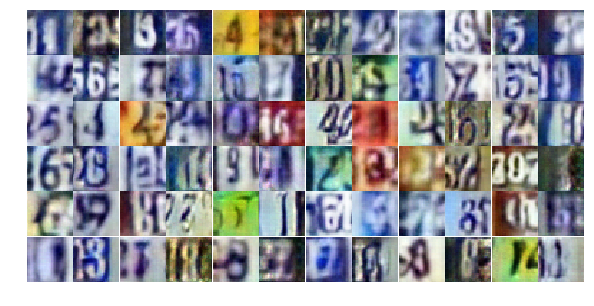

Epoch 1/15... Discriminator Loss: 1.3114... Generator Loss: 0.4288
Epoch 1/15... Discriminator Loss: 0.7561... Generator Loss: 0.9119
Epoch 1/15... Discriminator Loss: 0.8378... Generator Loss: 0.7807
Epoch 1/15... Discriminator Loss: 0.8887... Generator Loss: 1.0334
Epoch 1/15... Discriminator Loss: 0.5736... Generator Loss: 1.2105
Epoch 1/15... Discriminator Loss: 0.9065... Generator Loss: 2.0557
Epoch 1/15... Discriminator Loss: 1.4980... Generator Loss: 0.3724
Epoch 1/15... Discriminator Loss: 0.6274... Generator Loss: 1.3173
Epoch 1/15... Discriminator Loss: 0.6014... Generator Loss: 1.3764
Epoch 1/15... Discriminator Loss: 0.9311... Generator Loss: 0.6538


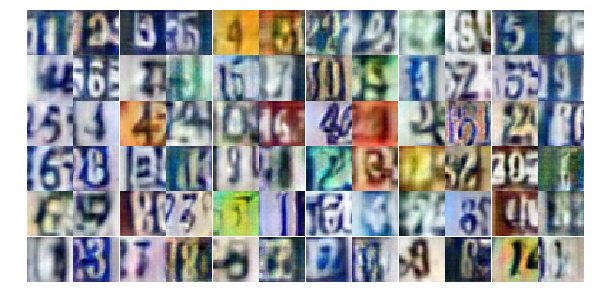

Epoch 1/15... Discriminator Loss: 1.5169... Generator Loss: 0.3556
Epoch 1/15... Discriminator Loss: 0.7734... Generator Loss: 0.8702
Epoch 1/15... Discriminator Loss: 1.7388... Generator Loss: 0.2984
Epoch 1/15... Discriminator Loss: 0.7943... Generator Loss: 1.0180
Epoch 1/15... Discriminator Loss: 1.9604... Generator Loss: 0.2222
Epoch 1/15... Discriminator Loss: 1.5753... Generator Loss: 0.3617
Epoch 1/15... Discriminator Loss: 1.9115... Generator Loss: 0.2553
Epoch 1/15... Discriminator Loss: 0.5881... Generator Loss: 1.6175
Epoch 1/15... Discriminator Loss: 1.3580... Generator Loss: 0.4340
Epoch 1/15... Discriminator Loss: 1.0934... Generator Loss: 0.6383


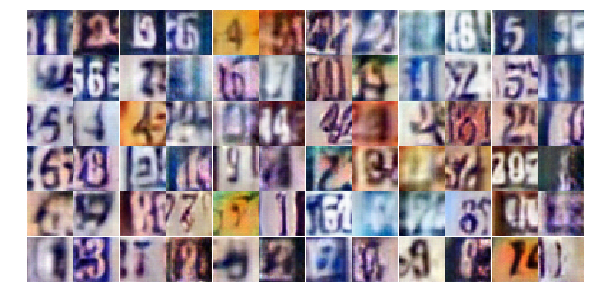

Epoch 1/15... Discriminator Loss: 0.5145... Generator Loss: 1.4710
Epoch 1/15... Discriminator Loss: 0.9547... Generator Loss: 0.7278
Epoch 1/15... Discriminator Loss: 0.6912... Generator Loss: 1.1698
Epoch 1/15... Discriminator Loss: 1.4849... Generator Loss: 0.4370
Epoch 1/15... Discriminator Loss: 0.9078... Generator Loss: 0.8222
Epoch 1/15... Discriminator Loss: 0.6792... Generator Loss: 0.9591
Epoch 1/15... Discriminator Loss: 1.5883... Generator Loss: 0.3652
Epoch 1/15... Discriminator Loss: 0.6448... Generator Loss: 0.9711
Epoch 1/15... Discriminator Loss: 1.8147... Generator Loss: 0.2484
Epoch 1/15... Discriminator Loss: 0.8064... Generator Loss: 0.8903


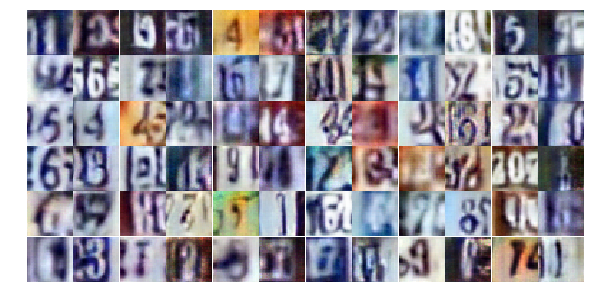

Epoch 1/15... Discriminator Loss: 1.4877... Generator Loss: 0.3949
Epoch 1/15... Discriminator Loss: 0.8205... Generator Loss: 0.9446
Epoch 1/15... Discriminator Loss: 1.8330... Generator Loss: 0.2340
Epoch 1/15... Discriminator Loss: 0.4955... Generator Loss: 1.4320
Epoch 1/15... Discriminator Loss: 0.9184... Generator Loss: 0.6635
Epoch 1/15... Discriminator Loss: 1.3980... Generator Loss: 0.4525
Epoch 1/15... Discriminator Loss: 0.8692... Generator Loss: 0.9840
Epoch 1/15... Discriminator Loss: 0.7146... Generator Loss: 0.9501
Epoch 1/15... Discriminator Loss: 0.7755... Generator Loss: 0.8365
Epoch 1/15... Discriminator Loss: 0.7091... Generator Loss: 0.9867


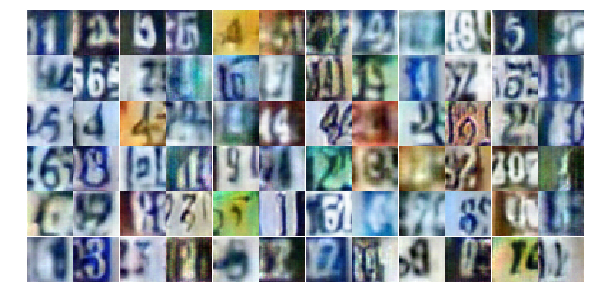

Epoch 1/15... Discriminator Loss: 0.6269... Generator Loss: 1.0346
Epoch 1/15... Discriminator Loss: 0.5591... Generator Loss: 1.6027
Epoch 1/15... Discriminator Loss: 1.2118... Generator Loss: 0.6072
Epoch 1/15... Discriminator Loss: 0.8167... Generator Loss: 0.9137
Epoch 1/15... Discriminator Loss: 0.6295... Generator Loss: 1.3289
Epoch 1/15... Discriminator Loss: 1.4145... Generator Loss: 0.3939
Epoch 1/15... Discriminator Loss: 2.0024... Generator Loss: 0.2331
Epoch 1/15... Discriminator Loss: 1.4937... Generator Loss: 0.3970
Epoch 1/15... Discriminator Loss: 0.6826... Generator Loss: 1.1254
Epoch 1/15... Discriminator Loss: 0.6715... Generator Loss: 1.0541


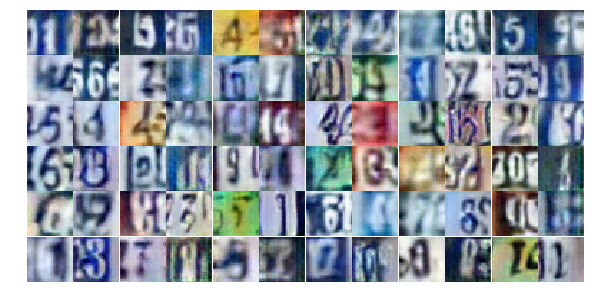

Epoch 1/15... Discriminator Loss: 0.6713... Generator Loss: 1.1825
Epoch 1/15... Discriminator Loss: 0.9585... Generator Loss: 0.6666
Epoch 1/15... Discriminator Loss: 0.7568... Generator Loss: 0.8792
Epoch 1/15... Discriminator Loss: 0.7249... Generator Loss: 0.9455
Epoch 2/15... Discriminator Loss: 0.8997... Generator Loss: 0.9607
Epoch 2/15... Discriminator Loss: 0.6794... Generator Loss: 1.0359
Epoch 2/15... Discriminator Loss: 0.5927... Generator Loss: 1.1880
Epoch 2/15... Discriminator Loss: 0.8431... Generator Loss: 0.7612
Epoch 2/15... Discriminator Loss: 0.7376... Generator Loss: 0.9730
Epoch 2/15... Discriminator Loss: 1.3727... Generator Loss: 0.4194


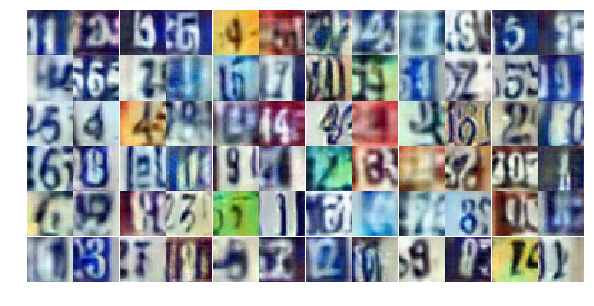

Epoch 2/15... Discriminator Loss: 1.0095... Generator Loss: 0.6190
Epoch 2/15... Discriminator Loss: 0.9806... Generator Loss: 0.7772
Epoch 2/15... Discriminator Loss: 1.0972... Generator Loss: 0.5475
Epoch 2/15... Discriminator Loss: 1.2733... Generator Loss: 0.4273
Epoch 2/15... Discriminator Loss: 2.2765... Generator Loss: 0.2209
Epoch 2/15... Discriminator Loss: 0.9334... Generator Loss: 0.6970
Epoch 2/15... Discriminator Loss: 0.8877... Generator Loss: 0.7793
Epoch 2/15... Discriminator Loss: 1.4585... Generator Loss: 0.3943
Epoch 2/15... Discriminator Loss: 0.7806... Generator Loss: 0.8827
Epoch 2/15... Discriminator Loss: 1.4491... Generator Loss: 0.4106


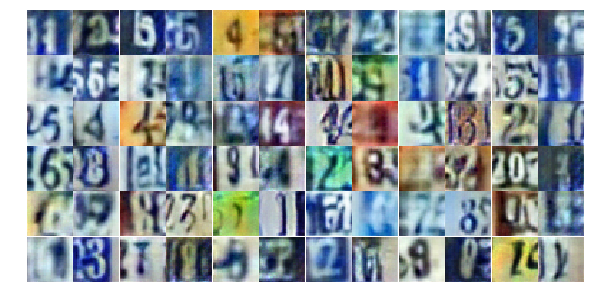

Epoch 2/15... Discriminator Loss: 0.7081... Generator Loss: 0.9383
Epoch 2/15... Discriminator Loss: 0.5514... Generator Loss: 1.3864
Epoch 2/15... Discriminator Loss: 0.8260... Generator Loss: 1.0343
Epoch 2/15... Discriminator Loss: 1.2137... Generator Loss: 0.5355
Epoch 2/15... Discriminator Loss: 0.9792... Generator Loss: 0.6803
Epoch 2/15... Discriminator Loss: 1.0839... Generator Loss: 0.5547
Epoch 2/15... Discriminator Loss: 0.7507... Generator Loss: 0.8767
Epoch 2/15... Discriminator Loss: 0.9031... Generator Loss: 0.7751
Epoch 2/15... Discriminator Loss: 1.7374... Generator Loss: 0.2669
Epoch 2/15... Discriminator Loss: 1.1056... Generator Loss: 0.5654


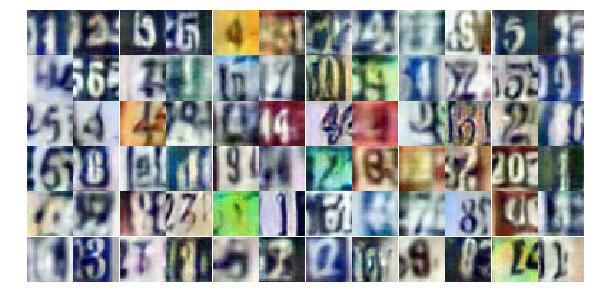

Epoch 2/15... Discriminator Loss: 1.0129... Generator Loss: 0.6282
Epoch 2/15... Discriminator Loss: 0.9491... Generator Loss: 0.7608
Epoch 2/15... Discriminator Loss: 0.8069... Generator Loss: 1.0158
Epoch 2/15... Discriminator Loss: 0.8076... Generator Loss: 0.8245
Epoch 2/15... Discriminator Loss: 1.7042... Generator Loss: 0.3104
Epoch 2/15... Discriminator Loss: 0.7743... Generator Loss: 0.8203
Epoch 2/15... Discriminator Loss: 0.7688... Generator Loss: 0.8288
Epoch 2/15... Discriminator Loss: 0.4038... Generator Loss: 1.4754
Epoch 2/15... Discriminator Loss: 0.5982... Generator Loss: 1.3340
Epoch 2/15... Discriminator Loss: 0.4996... Generator Loss: 1.3067


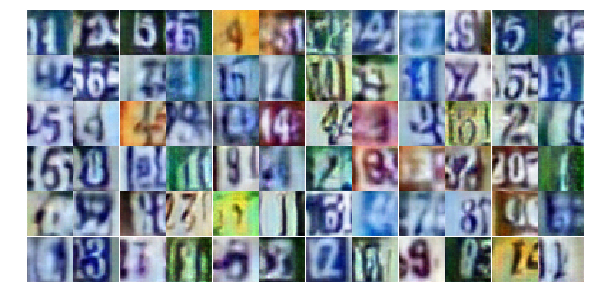

Epoch 2/15... Discriminator Loss: 1.5928... Generator Loss: 0.4214
Epoch 2/15... Discriminator Loss: 1.1821... Generator Loss: 0.5925
Epoch 2/15... Discriminator Loss: 1.0653... Generator Loss: 0.8544
Epoch 2/15... Discriminator Loss: 0.5598... Generator Loss: 1.2572
Epoch 2/15... Discriminator Loss: 0.8527... Generator Loss: 0.7674
Epoch 2/15... Discriminator Loss: 1.7236... Generator Loss: 0.2480
Epoch 2/15... Discriminator Loss: 1.5033... Generator Loss: 0.3588
Epoch 2/15... Discriminator Loss: 0.8794... Generator Loss: 0.8342
Epoch 2/15... Discriminator Loss: 0.7348... Generator Loss: 0.9571
Epoch 2/15... Discriminator Loss: 1.3662... Generator Loss: 0.4764


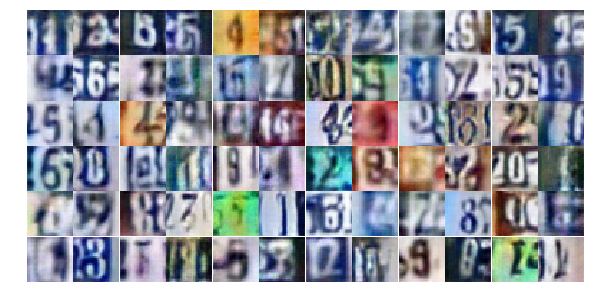

Epoch 2/15... Discriminator Loss: 0.7737... Generator Loss: 0.8185
Epoch 2/15... Discriminator Loss: 1.0626... Generator Loss: 0.5500
Epoch 2/15... Discriminator Loss: 0.3196... Generator Loss: 2.2740
Epoch 2/15... Discriminator Loss: 1.0643... Generator Loss: 0.6152
Epoch 2/15... Discriminator Loss: 1.3800... Generator Loss: 0.4521
Epoch 2/15... Discriminator Loss: 1.0291... Generator Loss: 0.6744
Epoch 2/15... Discriminator Loss: 0.9920... Generator Loss: 0.7016
Epoch 2/15... Discriminator Loss: 0.5714... Generator Loss: 1.6678
Epoch 2/15... Discriminator Loss: 0.3737... Generator Loss: 1.8258
Epoch 2/15... Discriminator Loss: 1.9390... Generator Loss: 0.2173


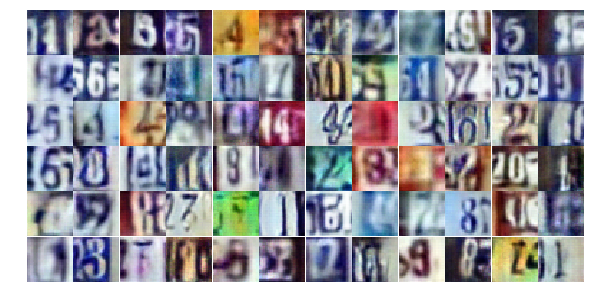

Epoch 2/15... Discriminator Loss: 0.7007... Generator Loss: 1.0798
Epoch 2/15... Discriminator Loss: 0.7380... Generator Loss: 0.8988
Epoch 2/15... Discriminator Loss: 1.8444... Generator Loss: 0.2812
Epoch 2/15... Discriminator Loss: 0.8950... Generator Loss: 0.9220
Epoch 2/15... Discriminator Loss: 0.7298... Generator Loss: 0.9248
Epoch 2/15... Discriminator Loss: 0.8330... Generator Loss: 0.8984
Epoch 2/15... Discriminator Loss: 1.1476... Generator Loss: 0.6682
Epoch 2/15... Discriminator Loss: 0.9683... Generator Loss: 0.7261
Epoch 2/15... Discriminator Loss: 0.7219... Generator Loss: 1.0217
Epoch 2/15... Discriminator Loss: 0.9637... Generator Loss: 0.7696


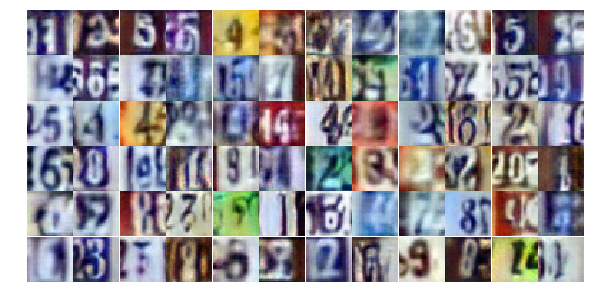

Epoch 2/15... Discriminator Loss: 0.5200... Generator Loss: 1.2661
Epoch 2/15... Discriminator Loss: 1.6211... Generator Loss: 0.4537
Epoch 2/15... Discriminator Loss: 1.4054... Generator Loss: 0.4685
Epoch 2/15... Discriminator Loss: 0.6100... Generator Loss: 0.9969
Epoch 2/15... Discriminator Loss: 0.9503... Generator Loss: 1.1911
Epoch 2/15... Discriminator Loss: 0.8489... Generator Loss: 1.5157
Epoch 2/15... Discriminator Loss: 0.8153... Generator Loss: 0.8589
Epoch 2/15... Discriminator Loss: 0.8145... Generator Loss: 1.0426
Epoch 2/15... Discriminator Loss: 0.9253... Generator Loss: 1.0110
Epoch 2/15... Discriminator Loss: 0.7542... Generator Loss: 1.3833


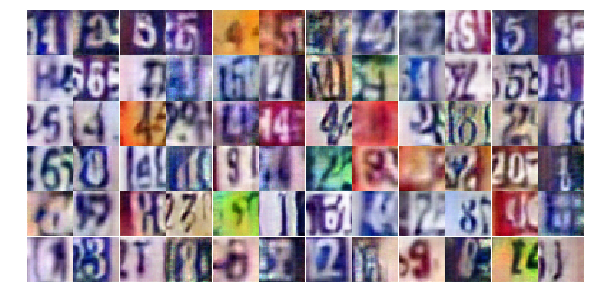

Epoch 2/15... Discriminator Loss: 0.7978... Generator Loss: 1.0408
Epoch 2/15... Discriminator Loss: 1.0306... Generator Loss: 0.6212
Epoch 2/15... Discriminator Loss: 0.8298... Generator Loss: 0.8565
Epoch 2/15... Discriminator Loss: 1.0312... Generator Loss: 0.6401
Epoch 2/15... Discriminator Loss: 1.2081... Generator Loss: 0.4938
Epoch 2/15... Discriminator Loss: 0.9237... Generator Loss: 0.7144
Epoch 2/15... Discriminator Loss: 0.9805... Generator Loss: 0.6896
Epoch 2/15... Discriminator Loss: 0.7707... Generator Loss: 0.8790
Epoch 2/15... Discriminator Loss: 1.7450... Generator Loss: 0.2785
Epoch 2/15... Discriminator Loss: 0.5576... Generator Loss: 1.4258


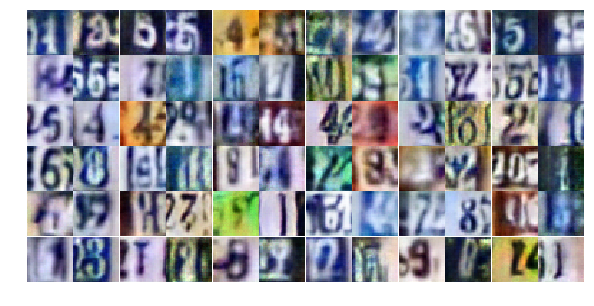

Epoch 2/15... Discriminator Loss: 0.6450... Generator Loss: 1.0570
Epoch 2/15... Discriminator Loss: 2.1121... Generator Loss: 0.1991
Epoch 2/15... Discriminator Loss: 1.0873... Generator Loss: 0.6068
Epoch 2/15... Discriminator Loss: 0.6563... Generator Loss: 0.8971
Epoch 2/15... Discriminator Loss: 1.5722... Generator Loss: 0.4274
Epoch 2/15... Discriminator Loss: 0.9631... Generator Loss: 0.7047
Epoch 2/15... Discriminator Loss: 1.3010... Generator Loss: 0.5159
Epoch 2/15... Discriminator Loss: 1.5602... Generator Loss: 0.3660
Epoch 2/15... Discriminator Loss: 1.3898... Generator Loss: 0.4164
Epoch 2/15... Discriminator Loss: 0.7227... Generator Loss: 0.9757


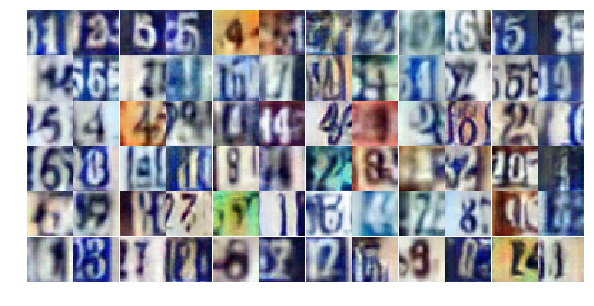

Epoch 2/15... Discriminator Loss: 0.9516... Generator Loss: 0.7264
Epoch 2/15... Discriminator Loss: 1.0249... Generator Loss: 0.6282
Epoch 2/15... Discriminator Loss: 0.8422... Generator Loss: 0.7831
Epoch 2/15... Discriminator Loss: 0.8294... Generator Loss: 0.9078
Epoch 2/15... Discriminator Loss: 0.8719... Generator Loss: 0.9170
Epoch 2/15... Discriminator Loss: 0.7464... Generator Loss: 0.8463
Epoch 2/15... Discriminator Loss: 1.3176... Generator Loss: 0.4944
Epoch 2/15... Discriminator Loss: 1.1909... Generator Loss: 0.5335
Epoch 2/15... Discriminator Loss: 0.6646... Generator Loss: 1.1259
Epoch 2/15... Discriminator Loss: 1.0014... Generator Loss: 0.6597


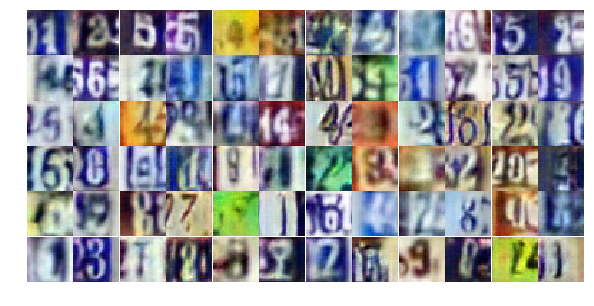

Epoch 2/15... Discriminator Loss: 0.7400... Generator Loss: 0.9347
Epoch 2/15... Discriminator Loss: 0.7723... Generator Loss: 0.9364
Epoch 2/15... Discriminator Loss: 0.7615... Generator Loss: 1.0364
Epoch 2/15... Discriminator Loss: 1.1810... Generator Loss: 0.4930
Epoch 2/15... Discriminator Loss: 1.1142... Generator Loss: 0.5832
Epoch 2/15... Discriminator Loss: 0.7466... Generator Loss: 1.0875
Epoch 2/15... Discriminator Loss: 0.6708... Generator Loss: 0.9727
Epoch 2/15... Discriminator Loss: 1.3098... Generator Loss: 0.4980
Epoch 2/15... Discriminator Loss: 0.8589... Generator Loss: 0.8157
Epoch 3/15... Discriminator Loss: 1.2280... Generator Loss: 0.5540


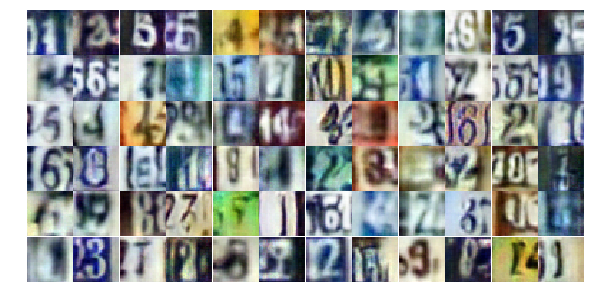

Epoch 3/15... Discriminator Loss: 0.9044... Generator Loss: 0.6921
Epoch 3/15... Discriminator Loss: 0.6463... Generator Loss: 0.9827
Epoch 3/15... Discriminator Loss: 0.5844... Generator Loss: 1.1614
Epoch 3/15... Discriminator Loss: 1.0689... Generator Loss: 0.5734
Epoch 3/15... Discriminator Loss: 1.2299... Generator Loss: 0.5122
Epoch 3/15... Discriminator Loss: 1.3334... Generator Loss: 0.4122
Epoch 3/15... Discriminator Loss: 1.1612... Generator Loss: 0.5787
Epoch 3/15... Discriminator Loss: 0.7894... Generator Loss: 0.8747
Epoch 3/15... Discriminator Loss: 1.0004... Generator Loss: 0.7032
Epoch 3/15... Discriminator Loss: 0.7967... Generator Loss: 0.8208


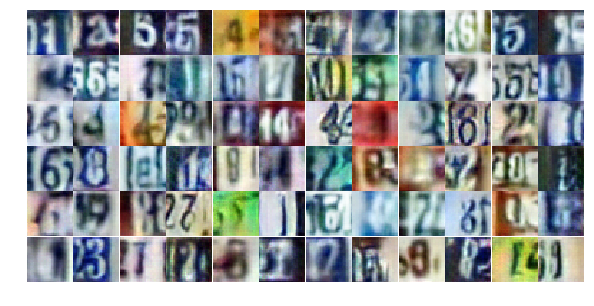

Epoch 3/15... Discriminator Loss: 1.3782... Generator Loss: 0.4290
Epoch 3/15... Discriminator Loss: 0.5391... Generator Loss: 1.2353
Epoch 3/15... Discriminator Loss: 0.6632... Generator Loss: 1.8159
Epoch 3/15... Discriminator Loss: 1.0076... Generator Loss: 1.6499
Epoch 3/15... Discriminator Loss: 0.5989... Generator Loss: 1.2271
Epoch 3/15... Discriminator Loss: 0.9033... Generator Loss: 0.7148
Epoch 3/15... Discriminator Loss: 0.6744... Generator Loss: 0.9098
Epoch 3/15... Discriminator Loss: 0.6502... Generator Loss: 1.0819
Epoch 3/15... Discriminator Loss: 0.8863... Generator Loss: 0.7692
Epoch 3/15... Discriminator Loss: 0.7864... Generator Loss: 0.8294


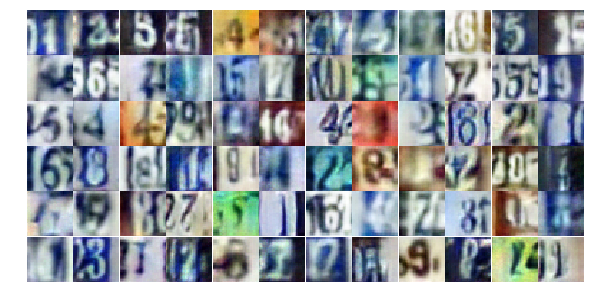

Epoch 3/15... Discriminator Loss: 0.9681... Generator Loss: 0.6560
Epoch 3/15... Discriminator Loss: 0.8439... Generator Loss: 0.9222
Epoch 3/15... Discriminator Loss: 0.7449... Generator Loss: 1.0978
Epoch 3/15... Discriminator Loss: 0.7797... Generator Loss: 0.8550
Epoch 3/15... Discriminator Loss: 0.9746... Generator Loss: 0.6812
Epoch 3/15... Discriminator Loss: 0.9442... Generator Loss: 0.7003
Epoch 3/15... Discriminator Loss: 1.4824... Generator Loss: 0.4065
Epoch 3/15... Discriminator Loss: 1.1880... Generator Loss: 0.4868
Epoch 3/15... Discriminator Loss: 0.6952... Generator Loss: 0.9774
Epoch 3/15... Discriminator Loss: 1.5036... Generator Loss: 0.3643


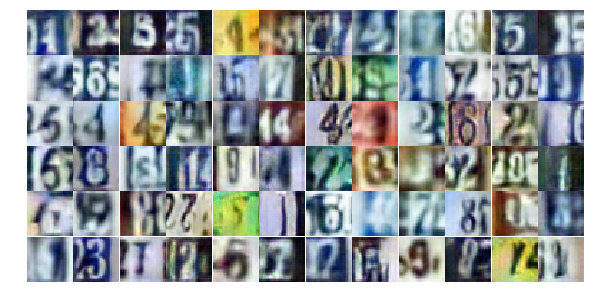

Epoch 3/15... Discriminator Loss: 0.6266... Generator Loss: 1.2254
Epoch 3/15... Discriminator Loss: 0.8949... Generator Loss: 0.8271
Epoch 3/15... Discriminator Loss: 1.4481... Generator Loss: 0.4150
Epoch 3/15... Discriminator Loss: 2.0875... Generator Loss: 0.2045
Epoch 3/15... Discriminator Loss: 0.9558... Generator Loss: 0.7083
Epoch 3/15... Discriminator Loss: 0.5120... Generator Loss: 1.3033
Epoch 3/15... Discriminator Loss: 1.0236... Generator Loss: 0.6716
Epoch 3/15... Discriminator Loss: 0.5934... Generator Loss: 1.2089
Epoch 3/15... Discriminator Loss: 1.2712... Generator Loss: 0.5083
Epoch 3/15... Discriminator Loss: 1.0706... Generator Loss: 0.6130


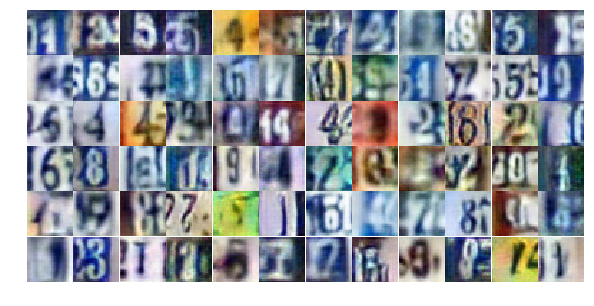

Epoch 3/15... Discriminator Loss: 1.2987... Generator Loss: 0.4600
Epoch 3/15... Discriminator Loss: 0.7098... Generator Loss: 0.9886
Epoch 3/15... Discriminator Loss: 0.6455... Generator Loss: 1.0825
Epoch 3/15... Discriminator Loss: 1.3143... Generator Loss: 0.4549
Epoch 3/15... Discriminator Loss: 0.5060... Generator Loss: 1.4811
Epoch 3/15... Discriminator Loss: 1.1285... Generator Loss: 0.5897
Epoch 3/15... Discriminator Loss: 1.1802... Generator Loss: 0.5229
Epoch 3/15... Discriminator Loss: 1.1767... Generator Loss: 0.5719
Epoch 3/15... Discriminator Loss: 0.9470... Generator Loss: 0.9321
Epoch 3/15... Discriminator Loss: 0.7626... Generator Loss: 0.9956


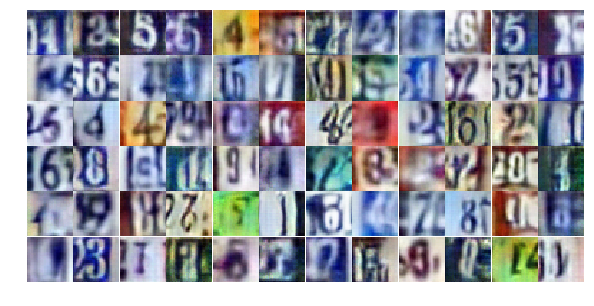

Epoch 3/15... Discriminator Loss: 0.9745... Generator Loss: 0.6974
Epoch 3/15... Discriminator Loss: 1.3652... Generator Loss: 0.3999
Epoch 3/15... Discriminator Loss: 0.8365... Generator Loss: 0.8319
Epoch 3/15... Discriminator Loss: 0.8356... Generator Loss: 0.7983
Epoch 3/15... Discriminator Loss: 0.6712... Generator Loss: 1.6551
Epoch 3/15... Discriminator Loss: 0.7362... Generator Loss: 1.3018
Epoch 3/15... Discriminator Loss: 0.8036... Generator Loss: 1.0114
Epoch 3/15... Discriminator Loss: 0.7864... Generator Loss: 0.9112
Epoch 3/15... Discriminator Loss: 1.1352... Generator Loss: 0.5912
Epoch 3/15... Discriminator Loss: 0.4887... Generator Loss: 1.9332


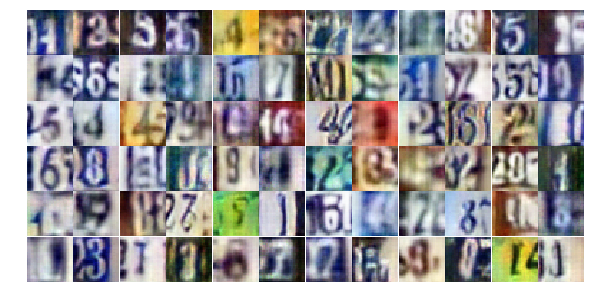

Epoch 3/15... Discriminator Loss: 0.4397... Generator Loss: 1.5241
Epoch 3/15... Discriminator Loss: 0.8857... Generator Loss: 0.7010
Epoch 3/15... Discriminator Loss: 0.8379... Generator Loss: 1.1777
Epoch 3/15... Discriminator Loss: 0.7809... Generator Loss: 0.9922
Epoch 3/15... Discriminator Loss: 0.7134... Generator Loss: 0.9997
Epoch 3/15... Discriminator Loss: 1.7641... Generator Loss: 0.2768
Epoch 3/15... Discriminator Loss: 0.6600... Generator Loss: 1.1919
Epoch 3/15... Discriminator Loss: 0.6122... Generator Loss: 1.2107
Epoch 3/15... Discriminator Loss: 0.9650... Generator Loss: 0.7177
Epoch 3/15... Discriminator Loss: 0.9659... Generator Loss: 0.7341


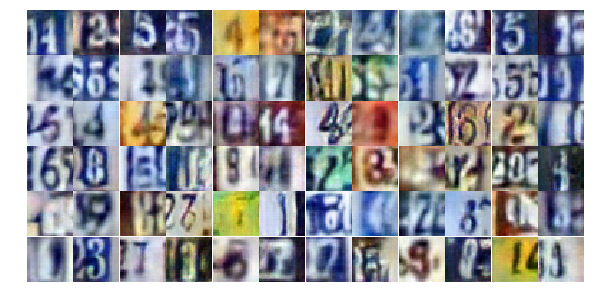

Epoch 3/15... Discriminator Loss: 0.6268... Generator Loss: 1.0709
Epoch 3/15... Discriminator Loss: 1.3734... Generator Loss: 0.4015
Epoch 3/15... Discriminator Loss: 0.7291... Generator Loss: 1.1402
Epoch 3/15... Discriminator Loss: 1.6912... Generator Loss: 0.3175
Epoch 3/15... Discriminator Loss: 0.6449... Generator Loss: 1.0957
Epoch 3/15... Discriminator Loss: 1.6205... Generator Loss: 0.3099
Epoch 3/15... Discriminator Loss: 0.3045... Generator Loss: 2.2483
Epoch 3/15... Discriminator Loss: 1.3313... Generator Loss: 0.4454
Epoch 3/15... Discriminator Loss: 0.6712... Generator Loss: 1.3315
Epoch 3/15... Discriminator Loss: 0.6714... Generator Loss: 1.1575


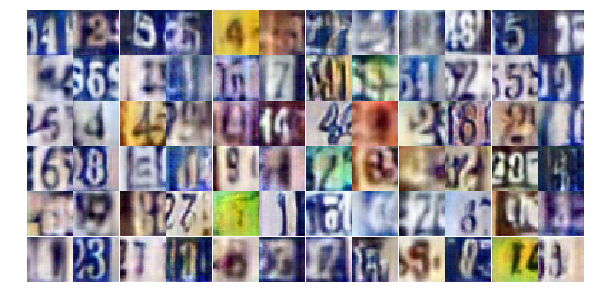

Epoch 3/15... Discriminator Loss: 1.0438... Generator Loss: 0.6345
Epoch 3/15... Discriminator Loss: 0.8029... Generator Loss: 1.0274
Epoch 3/15... Discriminator Loss: 0.8479... Generator Loss: 0.7383
Epoch 3/15... Discriminator Loss: 0.6751... Generator Loss: 1.1609
Epoch 3/15... Discriminator Loss: 0.3914... Generator Loss: 1.7486
Epoch 3/15... Discriminator Loss: 1.5221... Generator Loss: 0.3872
Epoch 3/15... Discriminator Loss: 0.3860... Generator Loss: 1.5136
Epoch 3/15... Discriminator Loss: 1.8252... Generator Loss: 0.2671
Epoch 3/15... Discriminator Loss: 0.6548... Generator Loss: 1.2250
Epoch 3/15... Discriminator Loss: 1.4002... Generator Loss: 0.5285


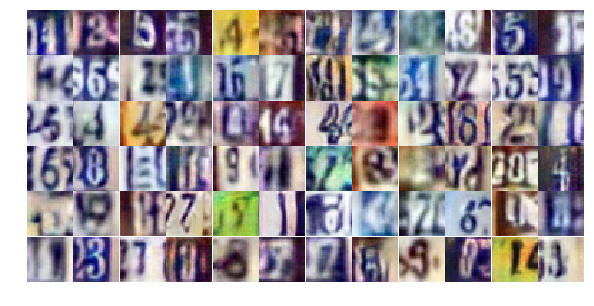

Epoch 3/15... Discriminator Loss: 0.8034... Generator Loss: 0.8497
Epoch 3/15... Discriminator Loss: 1.6888... Generator Loss: 0.3296
Epoch 3/15... Discriminator Loss: 1.0426... Generator Loss: 0.6212
Epoch 3/15... Discriminator Loss: 0.9005... Generator Loss: 0.7016
Epoch 3/15... Discriminator Loss: 1.3957... Generator Loss: 0.4186
Epoch 3/15... Discriminator Loss: 0.7678... Generator Loss: 1.1757
Epoch 3/15... Discriminator Loss: 0.6568... Generator Loss: 1.1892
Epoch 3/15... Discriminator Loss: 0.7067... Generator Loss: 0.8972
Epoch 3/15... Discriminator Loss: 0.6195... Generator Loss: 1.1832
Epoch 3/15... Discriminator Loss: 0.5011... Generator Loss: 1.2291


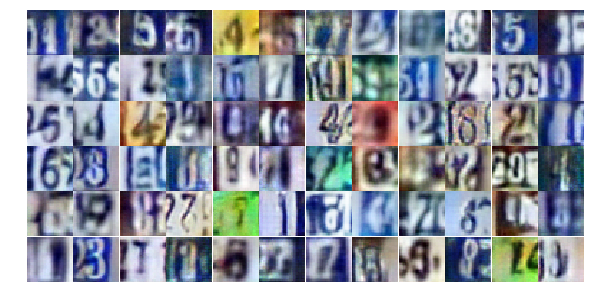

Epoch 3/15... Discriminator Loss: 0.6369... Generator Loss: 1.2207
Epoch 3/15... Discriminator Loss: 0.9952... Generator Loss: 1.2173
Epoch 3/15... Discriminator Loss: 0.7560... Generator Loss: 0.9826
Epoch 3/15... Discriminator Loss: 0.6326... Generator Loss: 1.2545
Epoch 3/15... Discriminator Loss: 1.0716... Generator Loss: 0.6129
Epoch 3/15... Discriminator Loss: 1.4361... Generator Loss: 0.4517
Epoch 3/15... Discriminator Loss: 1.1491... Generator Loss: 0.5733
Epoch 3/15... Discriminator Loss: 0.6606... Generator Loss: 1.1297
Epoch 3/15... Discriminator Loss: 0.7753... Generator Loss: 0.9354
Epoch 3/15... Discriminator Loss: 0.6663... Generator Loss: 0.9545


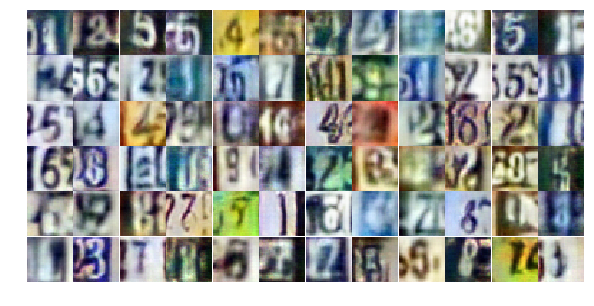

Epoch 3/15... Discriminator Loss: 0.7899... Generator Loss: 0.8946
Epoch 3/15... Discriminator Loss: 0.6967... Generator Loss: 1.0835
Epoch 3/15... Discriminator Loss: 0.8089... Generator Loss: 0.8143
Epoch 4/15... Discriminator Loss: 1.4878... Generator Loss: 0.3612
Epoch 4/15... Discriminator Loss: 0.8350... Generator Loss: 0.7635
Epoch 4/15... Discriminator Loss: 0.7883... Generator Loss: 0.8541
Epoch 4/15... Discriminator Loss: 0.3905... Generator Loss: 1.7190
Epoch 4/15... Discriminator Loss: 0.4298... Generator Loss: 1.4825
Epoch 4/15... Discriminator Loss: 0.8298... Generator Loss: 0.8402
Epoch 4/15... Discriminator Loss: 1.1204... Generator Loss: 0.5969


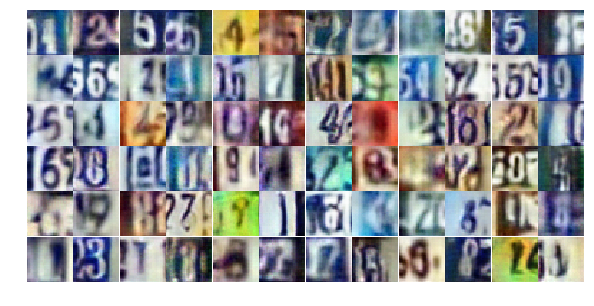

Epoch 4/15... Discriminator Loss: 1.1641... Generator Loss: 0.6356
Epoch 4/15... Discriminator Loss: 1.0784... Generator Loss: 0.5931
Epoch 4/15... Discriminator Loss: 0.9529... Generator Loss: 0.7377
Epoch 4/15... Discriminator Loss: 1.0160... Generator Loss: 0.7300
Epoch 4/15... Discriminator Loss: 0.5466... Generator Loss: 1.2368
Epoch 4/15... Discriminator Loss: 1.0311... Generator Loss: 2.1057
Epoch 4/15... Discriminator Loss: 1.5051... Generator Loss: 0.4225
Epoch 4/15... Discriminator Loss: 0.9231... Generator Loss: 0.7435
Epoch 4/15... Discriminator Loss: 0.9312... Generator Loss: 0.7138
Epoch 4/15... Discriminator Loss: 0.8933... Generator Loss: 0.7208


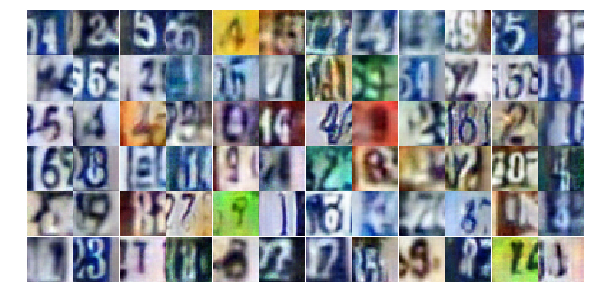

Epoch 4/15... Discriminator Loss: 0.6760... Generator Loss: 1.0060
Epoch 4/15... Discriminator Loss: 0.7647... Generator Loss: 1.0098
Epoch 4/15... Discriminator Loss: 0.7926... Generator Loss: 1.0062
Epoch 4/15... Discriminator Loss: 0.9587... Generator Loss: 0.6337
Epoch 4/15... Discriminator Loss: 0.9745... Generator Loss: 0.6461
Epoch 4/15... Discriminator Loss: 0.6168... Generator Loss: 1.0013
Epoch 4/15... Discriminator Loss: 0.9155... Generator Loss: 0.8554
Epoch 4/15... Discriminator Loss: 1.3385... Generator Loss: 0.4745
Epoch 4/15... Discriminator Loss: 0.9835... Generator Loss: 0.7394
Epoch 4/15... Discriminator Loss: 0.9276... Generator Loss: 1.2016


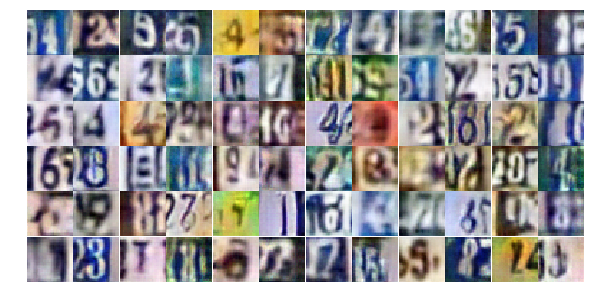

Epoch 4/15... Discriminator Loss: 0.9617... Generator Loss: 0.8370
Epoch 4/15... Discriminator Loss: 0.9670... Generator Loss: 0.7060
Epoch 4/15... Discriminator Loss: 1.0041... Generator Loss: 0.6325
Epoch 4/15... Discriminator Loss: 1.8654... Generator Loss: 0.2844
Epoch 4/15... Discriminator Loss: 0.7827... Generator Loss: 0.8602
Epoch 4/15... Discriminator Loss: 0.9328... Generator Loss: 0.7465
Epoch 4/15... Discriminator Loss: 0.8176... Generator Loss: 0.8646
Epoch 4/15... Discriminator Loss: 0.6590... Generator Loss: 1.0537
Epoch 4/15... Discriminator Loss: 0.8359... Generator Loss: 0.8799
Epoch 4/15... Discriminator Loss: 1.0868... Generator Loss: 0.5646


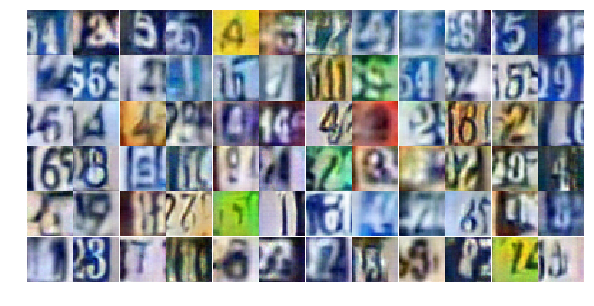

Epoch 4/15... Discriminator Loss: 1.3200... Generator Loss: 0.4802
Epoch 4/15... Discriminator Loss: 0.8138... Generator Loss: 1.3711
Epoch 4/15... Discriminator Loss: 0.7473... Generator Loss: 0.9713
Epoch 4/15... Discriminator Loss: 0.6227... Generator Loss: 1.0851
Epoch 4/15... Discriminator Loss: 1.7432... Generator Loss: 0.2885
Epoch 4/15... Discriminator Loss: 1.7096... Generator Loss: 0.3230
Epoch 4/15... Discriminator Loss: 1.2109... Generator Loss: 0.5601
Epoch 4/15... Discriminator Loss: 0.5109... Generator Loss: 1.3276
Epoch 4/15... Discriminator Loss: 1.9243... Generator Loss: 0.2476
Epoch 4/15... Discriminator Loss: 1.0765... Generator Loss: 0.5501


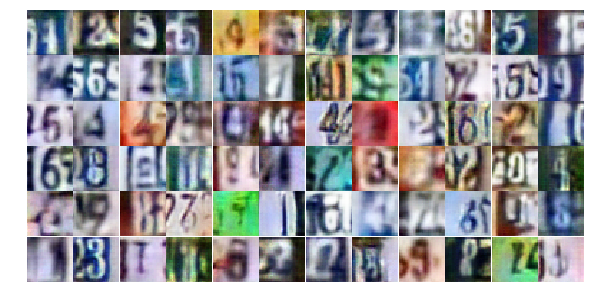

Epoch 4/15... Discriminator Loss: 0.9672... Generator Loss: 0.6783
Epoch 4/15... Discriminator Loss: 0.4344... Generator Loss: 1.5346
Epoch 4/15... Discriminator Loss: 0.7350... Generator Loss: 0.9671
Epoch 4/15... Discriminator Loss: 1.1115... Generator Loss: 0.6502
Epoch 4/15... Discriminator Loss: 0.9230... Generator Loss: 0.7244
Epoch 4/15... Discriminator Loss: 1.3362... Generator Loss: 0.4184
Epoch 4/15... Discriminator Loss: 0.5196... Generator Loss: 1.2755
Epoch 4/15... Discriminator Loss: 0.4825... Generator Loss: 1.5601
Epoch 4/15... Discriminator Loss: 2.2384... Generator Loss: 0.1925
Epoch 4/15... Discriminator Loss: 0.5087... Generator Loss: 1.6473


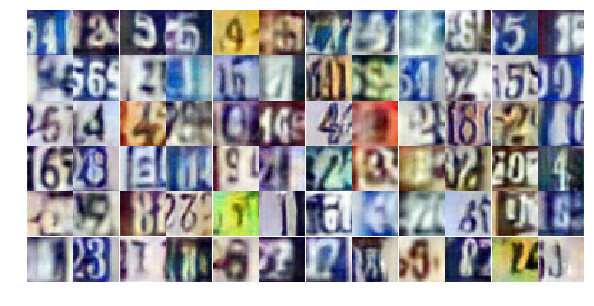

Epoch 4/15... Discriminator Loss: 0.6591... Generator Loss: 1.0449
Epoch 4/15... Discriminator Loss: 1.5132... Generator Loss: 0.3903
Epoch 4/15... Discriminator Loss: 0.6291... Generator Loss: 1.1452
Epoch 4/15... Discriminator Loss: 0.8767... Generator Loss: 0.7874
Epoch 4/15... Discriminator Loss: 0.9217... Generator Loss: 0.7619
Epoch 4/15... Discriminator Loss: 0.7657... Generator Loss: 1.1791
Epoch 4/15... Discriminator Loss: 1.0473... Generator Loss: 0.6633
Epoch 4/15... Discriminator Loss: 0.6590... Generator Loss: 1.1563
Epoch 4/15... Discriminator Loss: 0.4915... Generator Loss: 1.3532
Epoch 4/15... Discriminator Loss: 0.6696... Generator Loss: 1.0594


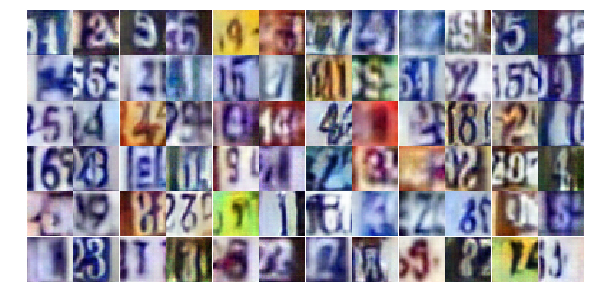

Epoch 4/15... Discriminator Loss: 1.2419... Generator Loss: 0.5866
Epoch 4/15... Discriminator Loss: 1.4685... Generator Loss: 0.3569
Epoch 4/15... Discriminator Loss: 0.6801... Generator Loss: 0.9695
Epoch 4/15... Discriminator Loss: 0.7512... Generator Loss: 1.1684
Epoch 4/15... Discriminator Loss: 0.8186... Generator Loss: 1.2488
Epoch 4/15... Discriminator Loss: 0.7403... Generator Loss: 0.9618
Epoch 4/15... Discriminator Loss: 0.6955... Generator Loss: 1.4488
Epoch 4/15... Discriminator Loss: 0.9682... Generator Loss: 0.6637
Epoch 4/15... Discriminator Loss: 0.8176... Generator Loss: 0.9379
Epoch 4/15... Discriminator Loss: 0.7883... Generator Loss: 1.0408


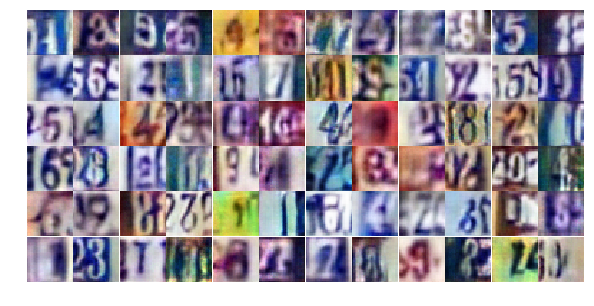

Epoch 4/15... Discriminator Loss: 0.5255... Generator Loss: 1.4133
Epoch 4/15... Discriminator Loss: 1.0415... Generator Loss: 0.6145
Epoch 4/15... Discriminator Loss: 1.0386... Generator Loss: 0.6453
Epoch 4/15... Discriminator Loss: 0.8091... Generator Loss: 0.9811
Epoch 4/15... Discriminator Loss: 0.6455... Generator Loss: 1.1003
Epoch 4/15... Discriminator Loss: 1.1338... Generator Loss: 0.5310
Epoch 4/15... Discriminator Loss: 0.5524... Generator Loss: 1.3630
Epoch 4/15... Discriminator Loss: 2.4845... Generator Loss: 0.1287
Epoch 4/15... Discriminator Loss: 0.7429... Generator Loss: 1.0674
Epoch 4/15... Discriminator Loss: 0.7395... Generator Loss: 1.1253


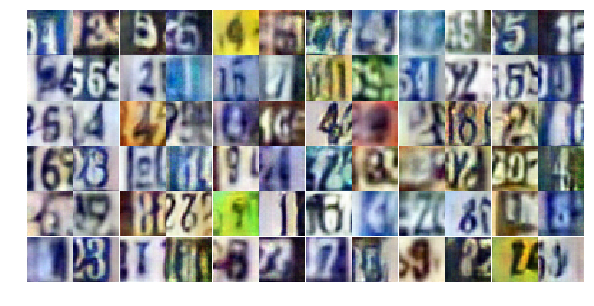

Epoch 4/15... Discriminator Loss: 1.7412... Generator Loss: 0.4060
Epoch 4/15... Discriminator Loss: 0.8218... Generator Loss: 0.9201
Epoch 4/15... Discriminator Loss: 0.6666... Generator Loss: 0.9956
Epoch 4/15... Discriminator Loss: 1.3075... Generator Loss: 0.4878
Epoch 4/15... Discriminator Loss: 0.7397... Generator Loss: 1.1495
Epoch 4/15... Discriminator Loss: 1.3887... Generator Loss: 0.5538
Epoch 4/15... Discriminator Loss: 1.1320... Generator Loss: 0.7471
Epoch 4/15... Discriminator Loss: 1.5554... Generator Loss: 0.3288
Epoch 4/15... Discriminator Loss: 0.9795... Generator Loss: 0.7096
Epoch 4/15... Discriminator Loss: 0.8994... Generator Loss: 0.8195


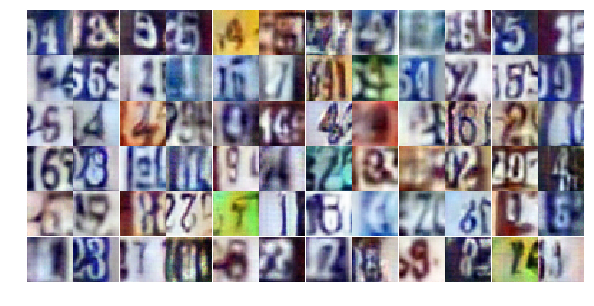

Epoch 4/15... Discriminator Loss: 0.7428... Generator Loss: 0.9224
Epoch 4/15... Discriminator Loss: 0.9716... Generator Loss: 0.6684
Epoch 4/15... Discriminator Loss: 0.7123... Generator Loss: 0.9785
Epoch 4/15... Discriminator Loss: 1.0071... Generator Loss: 0.6960
Epoch 4/15... Discriminator Loss: 0.6835... Generator Loss: 1.0640
Epoch 4/15... Discriminator Loss: 1.1104... Generator Loss: 2.6236
Epoch 4/15... Discriminator Loss: 1.2121... Generator Loss: 0.6011
Epoch 4/15... Discriminator Loss: 0.5603... Generator Loss: 1.3918
Epoch 4/15... Discriminator Loss: 0.8469... Generator Loss: 0.7602
Epoch 4/15... Discriminator Loss: 0.5985... Generator Loss: 2.3900


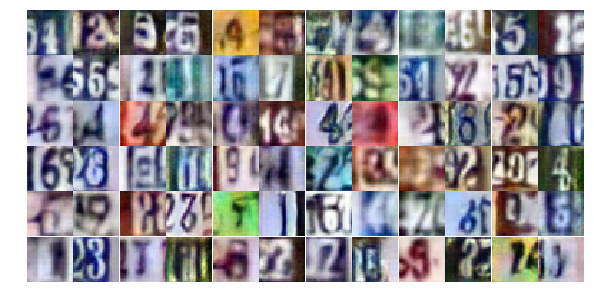

Epoch 4/15... Discriminator Loss: 0.8577... Generator Loss: 0.7693
Epoch 4/15... Discriminator Loss: 0.9681... Generator Loss: 0.7930
Epoch 4/15... Discriminator Loss: 1.3907... Generator Loss: 0.3978
Epoch 4/15... Discriminator Loss: 0.7631... Generator Loss: 1.0013
Epoch 4/15... Discriminator Loss: 0.7106... Generator Loss: 0.9831
Epoch 4/15... Discriminator Loss: 0.8163... Generator Loss: 0.7892
Epoch 4/15... Discriminator Loss: 1.1826... Generator Loss: 0.5313
Epoch 4/15... Discriminator Loss: 0.6154... Generator Loss: 1.2290
Epoch 5/15... Discriminator Loss: 1.4531... Generator Loss: 0.3614
Epoch 5/15... Discriminator Loss: 0.9151... Generator Loss: 0.7412


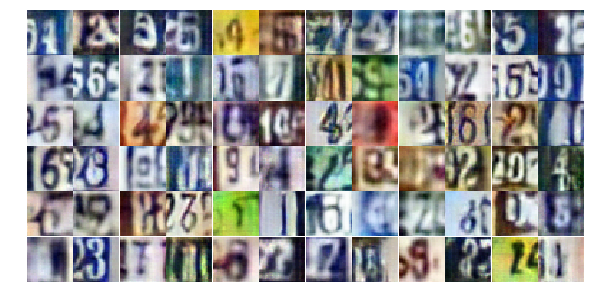

Epoch 5/15... Discriminator Loss: 0.6133... Generator Loss: 1.0475
Epoch 5/15... Discriminator Loss: 0.6111... Generator Loss: 1.2215
Epoch 5/15... Discriminator Loss: 0.7933... Generator Loss: 0.9225
Epoch 5/15... Discriminator Loss: 1.1630... Generator Loss: 0.5168
Epoch 5/15... Discriminator Loss: 1.1300... Generator Loss: 0.5224
Epoch 5/15... Discriminator Loss: 1.2814... Generator Loss: 0.4764
Epoch 5/15... Discriminator Loss: 1.0722... Generator Loss: 0.5513
Epoch 5/15... Discriminator Loss: 1.1519... Generator Loss: 0.5292
Epoch 5/15... Discriminator Loss: 1.1603... Generator Loss: 0.5813
Epoch 5/15... Discriminator Loss: 1.4720... Generator Loss: 2.1182


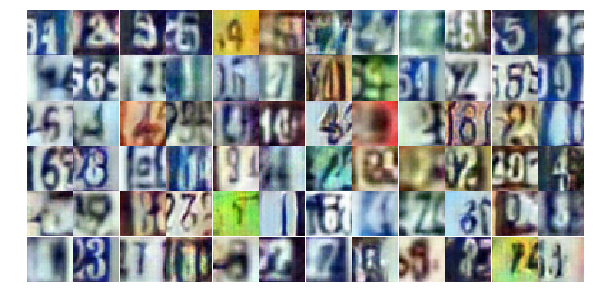

Epoch 5/15... Discriminator Loss: 0.6079... Generator Loss: 1.4228
Epoch 5/15... Discriminator Loss: 0.5274... Generator Loss: 1.4028
Epoch 5/15... Discriminator Loss: 1.5201... Generator Loss: 0.3723
Epoch 5/15... Discriminator Loss: 0.7005... Generator Loss: 0.9672
Epoch 5/15... Discriminator Loss: 0.5657... Generator Loss: 1.3889
Epoch 5/15... Discriminator Loss: 0.7205... Generator Loss: 0.9419
Epoch 5/15... Discriminator Loss: 0.6820... Generator Loss: 0.9916
Epoch 5/15... Discriminator Loss: 0.5132... Generator Loss: 1.3523
Epoch 5/15... Discriminator Loss: 0.6998... Generator Loss: 0.9225
Epoch 5/15... Discriminator Loss: 0.9784... Generator Loss: 0.6215


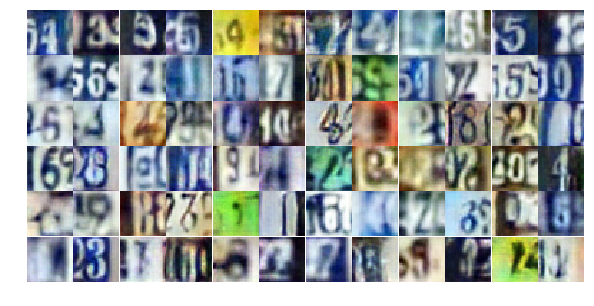

Epoch 5/15... Discriminator Loss: 0.9427... Generator Loss: 0.7801
Epoch 5/15... Discriminator Loss: 0.8413... Generator Loss: 0.8631
Epoch 5/15... Discriminator Loss: 0.9892... Generator Loss: 0.6662
Epoch 5/15... Discriminator Loss: 0.8868... Generator Loss: 0.7941
Epoch 5/15... Discriminator Loss: 0.9023... Generator Loss: 0.6926
Epoch 5/15... Discriminator Loss: 1.1427... Generator Loss: 0.5567
Epoch 5/15... Discriminator Loss: 1.3752... Generator Loss: 0.4629
Epoch 5/15... Discriminator Loss: 0.5969... Generator Loss: 1.3189
Epoch 5/15... Discriminator Loss: 0.7650... Generator Loss: 0.8461
Epoch 5/15... Discriminator Loss: 0.7668... Generator Loss: 0.9121


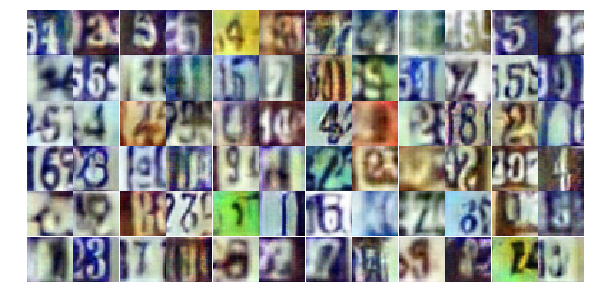

Epoch 5/15... Discriminator Loss: 1.4362... Generator Loss: 0.3891
Epoch 5/15... Discriminator Loss: 0.9271... Generator Loss: 1.0142
Epoch 5/15... Discriminator Loss: 1.5745... Generator Loss: 0.3626
Epoch 5/15... Discriminator Loss: 0.9582... Generator Loss: 0.7280
Epoch 5/15... Discriminator Loss: 0.9097... Generator Loss: 0.6436
Epoch 5/15... Discriminator Loss: 0.9464... Generator Loss: 0.8143
Epoch 5/15... Discriminator Loss: 0.6769... Generator Loss: 1.1709
Epoch 5/15... Discriminator Loss: 1.2684... Generator Loss: 0.5916
Epoch 5/15... Discriminator Loss: 0.9298... Generator Loss: 0.6943
Epoch 5/15... Discriminator Loss: 0.6686... Generator Loss: 1.0761


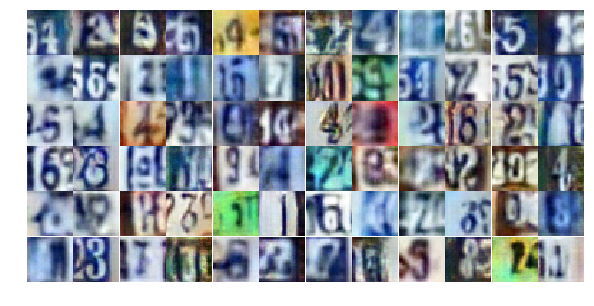

Epoch 5/15... Discriminator Loss: 1.0794... Generator Loss: 0.5656
Epoch 5/15... Discriminator Loss: 0.4601... Generator Loss: 1.5527
Epoch 5/15... Discriminator Loss: 0.9475... Generator Loss: 0.7383
Epoch 5/15... Discriminator Loss: 0.5518... Generator Loss: 1.2613
Epoch 5/15... Discriminator Loss: 1.7132... Generator Loss: 0.2871
Epoch 5/15... Discriminator Loss: 0.6808... Generator Loss: 1.1555
Epoch 5/15... Discriminator Loss: 0.5335... Generator Loss: 1.6235
Epoch 5/15... Discriminator Loss: 0.7557... Generator Loss: 1.0843
Epoch 5/15... Discriminator Loss: 0.8016... Generator Loss: 1.0315
Epoch 5/15... Discriminator Loss: 0.7903... Generator Loss: 0.8872


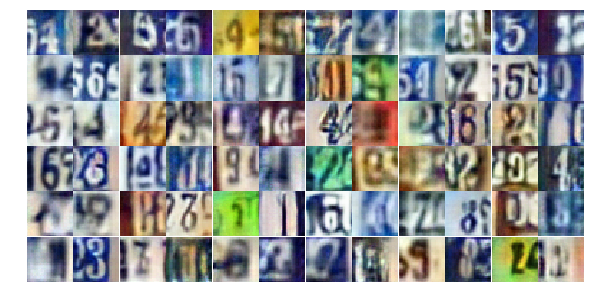

Epoch 5/15... Discriminator Loss: 1.7047... Generator Loss: 0.2833
Epoch 5/15... Discriminator Loss: 0.7544... Generator Loss: 0.9521
Epoch 5/15... Discriminator Loss: 0.5656... Generator Loss: 1.2381
Epoch 5/15... Discriminator Loss: 1.0164... Generator Loss: 2.0410
Epoch 5/15... Discriminator Loss: 0.5819... Generator Loss: 1.1896
Epoch 5/15... Discriminator Loss: 0.7947... Generator Loss: 1.0348
Epoch 5/15... Discriminator Loss: 0.8276... Generator Loss: 0.8033
Epoch 5/15... Discriminator Loss: 1.4336... Generator Loss: 0.4175
Epoch 5/15... Discriminator Loss: 0.7913... Generator Loss: 0.7923
Epoch 5/15... Discriminator Loss: 0.7119... Generator Loss: 0.9312


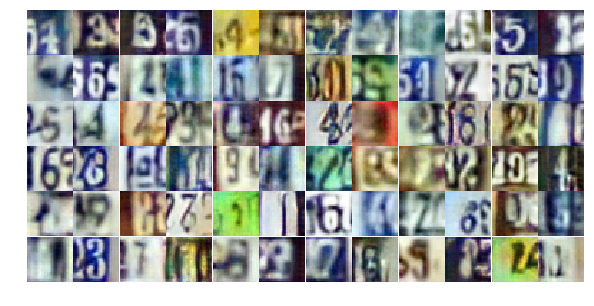

Epoch 5/15... Discriminator Loss: 0.9842... Generator Loss: 0.6483
Epoch 5/15... Discriminator Loss: 0.8298... Generator Loss: 1.4031
Epoch 5/15... Discriminator Loss: 0.6010... Generator Loss: 1.3084
Epoch 5/15... Discriminator Loss: 0.3753... Generator Loss: 2.0232
Epoch 5/15... Discriminator Loss: 1.7462... Generator Loss: 0.2784
Epoch 5/15... Discriminator Loss: 1.1011... Generator Loss: 0.7479
Epoch 5/15... Discriminator Loss: 0.6782... Generator Loss: 1.1474
Epoch 5/15... Discriminator Loss: 0.9761... Generator Loss: 0.6633
Epoch 5/15... Discriminator Loss: 0.8713... Generator Loss: 0.9255
Epoch 5/15... Discriminator Loss: 0.8334... Generator Loss: 0.9812


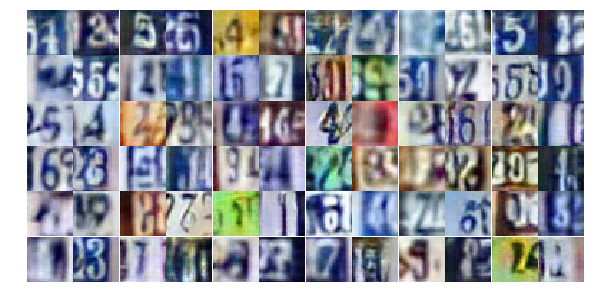

Epoch 5/15... Discriminator Loss: 1.4408... Generator Loss: 0.3592
Epoch 5/15... Discriminator Loss: 0.5596... Generator Loss: 1.4572
Epoch 5/15... Discriminator Loss: 1.6849... Generator Loss: 0.3319
Epoch 5/15... Discriminator Loss: 0.6295... Generator Loss: 1.1468
Epoch 5/15... Discriminator Loss: 1.8671... Generator Loss: 0.2498
Epoch 5/15... Discriminator Loss: 0.2702... Generator Loss: 2.7998
Epoch 5/15... Discriminator Loss: 1.0771... Generator Loss: 0.6466
Epoch 5/15... Discriminator Loss: 1.2271... Generator Loss: 0.5033
Epoch 5/15... Discriminator Loss: 0.6049... Generator Loss: 1.1727
Epoch 5/15... Discriminator Loss: 0.8824... Generator Loss: 0.8330


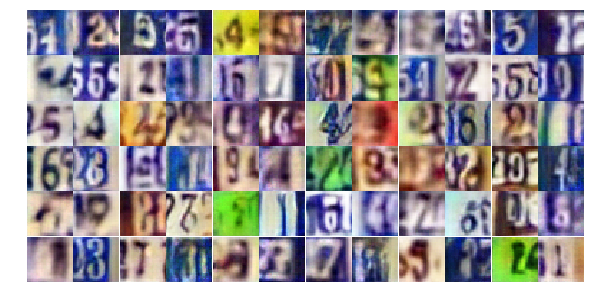

Epoch 5/15... Discriminator Loss: 0.6781... Generator Loss: 1.2925
Epoch 5/15... Discriminator Loss: 1.6431... Generator Loss: 0.3699
Epoch 5/15... Discriminator Loss: 0.6663... Generator Loss: 1.1611
Epoch 5/15... Discriminator Loss: 0.4473... Generator Loss: 1.3921
Epoch 5/15... Discriminator Loss: 1.6501... Generator Loss: 0.3253
Epoch 5/15... Discriminator Loss: 0.4519... Generator Loss: 1.3621
Epoch 5/15... Discriminator Loss: 1.9700... Generator Loss: 0.2490
Epoch 5/15... Discriminator Loss: 0.7875... Generator Loss: 0.8690
Epoch 5/15... Discriminator Loss: 1.0766... Generator Loss: 0.6319
Epoch 5/15... Discriminator Loss: 0.7601... Generator Loss: 0.8976


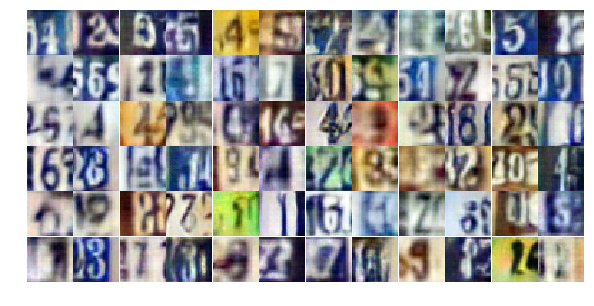

Epoch 5/15... Discriminator Loss: 1.6329... Generator Loss: 0.2895
Epoch 5/15... Discriminator Loss: 0.8611... Generator Loss: 0.7401
Epoch 5/15... Discriminator Loss: 0.9229... Generator Loss: 0.7176
Epoch 5/15... Discriminator Loss: 1.0495... Generator Loss: 0.7135
Epoch 5/15... Discriminator Loss: 0.8457... Generator Loss: 0.8359
Epoch 5/15... Discriminator Loss: 0.5601... Generator Loss: 1.0945
Epoch 5/15... Discriminator Loss: 1.0059... Generator Loss: 0.6613
Epoch 5/15... Discriminator Loss: 0.7852... Generator Loss: 0.9044
Epoch 5/15... Discriminator Loss: 0.5286... Generator Loss: 1.4176
Epoch 5/15... Discriminator Loss: 0.9267... Generator Loss: 0.7319


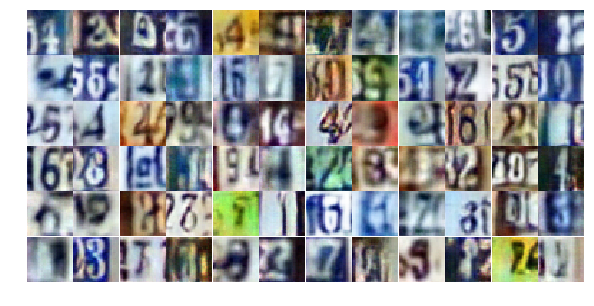

Epoch 5/15... Discriminator Loss: 0.7447... Generator Loss: 1.3763
Epoch 5/15... Discriminator Loss: 0.9211... Generator Loss: 0.7168
Epoch 5/15... Discriminator Loss: 0.6409... Generator Loss: 1.2516
Epoch 5/15... Discriminator Loss: 0.9394... Generator Loss: 0.7214
Epoch 5/15... Discriminator Loss: 1.4246... Generator Loss: 0.4221
Epoch 5/15... Discriminator Loss: 0.7036... Generator Loss: 1.0181
Epoch 5/15... Discriminator Loss: 0.6045... Generator Loss: 1.2451
Epoch 5/15... Discriminator Loss: 0.8528... Generator Loss: 0.8988
Epoch 5/15... Discriminator Loss: 0.6134... Generator Loss: 1.0762
Epoch 5/15... Discriminator Loss: 0.8177... Generator Loss: 0.8020


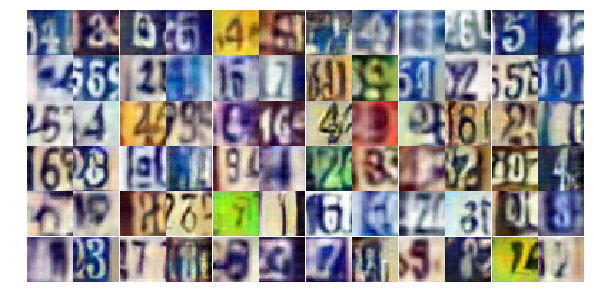

Epoch 5/15... Discriminator Loss: 0.5868... Generator Loss: 1.1826
Epoch 5/15... Discriminator Loss: 0.9574... Generator Loss: 0.6673
Epoch 6/15... Discriminator Loss: 0.7351... Generator Loss: 1.0004
Epoch 6/15... Discriminator Loss: 0.8184... Generator Loss: 0.8301
Epoch 6/15... Discriminator Loss: 0.7269... Generator Loss: 0.9571
Epoch 6/15... Discriminator Loss: 0.4631... Generator Loss: 1.7670
Epoch 6/15... Discriminator Loss: 0.8120... Generator Loss: 1.3642
Epoch 6/15... Discriminator Loss: 0.6534... Generator Loss: 2.0969
Epoch 6/15... Discriminator Loss: 0.9052... Generator Loss: 0.9115
Epoch 6/15... Discriminator Loss: 1.3243... Generator Loss: 0.5030


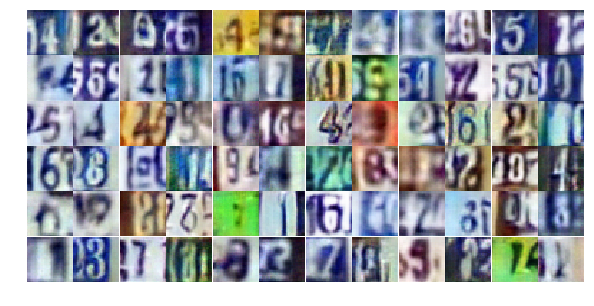

Epoch 6/15... Discriminator Loss: 0.6474... Generator Loss: 1.7619
Epoch 6/15... Discriminator Loss: 1.1839... Generator Loss: 0.4934
Epoch 6/15... Discriminator Loss: 0.9814... Generator Loss: 0.7491
Epoch 6/15... Discriminator Loss: 0.9102... Generator Loss: 0.7560
Epoch 6/15... Discriminator Loss: 0.5780... Generator Loss: 1.3320
Epoch 6/15... Discriminator Loss: 1.0151... Generator Loss: 0.6784
Epoch 6/15... Discriminator Loss: 0.9732... Generator Loss: 0.6291
Epoch 6/15... Discriminator Loss: 1.3384... Generator Loss: 0.4877
Epoch 6/15... Discriminator Loss: 0.6790... Generator Loss: 1.0133
Epoch 6/15... Discriminator Loss: 1.0510... Generator Loss: 0.7283


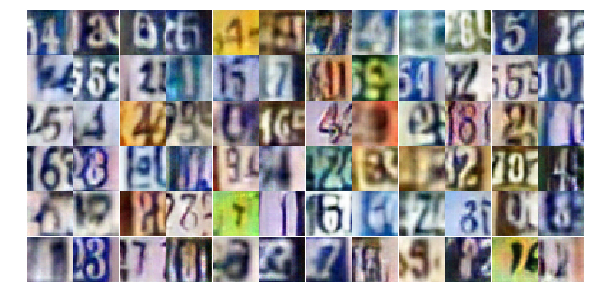

Epoch 6/15... Discriminator Loss: 0.7813... Generator Loss: 0.9675
Epoch 6/15... Discriminator Loss: 0.7536... Generator Loss: 1.0647
Epoch 6/15... Discriminator Loss: 0.9569... Generator Loss: 0.7810
Epoch 6/15... Discriminator Loss: 1.2165... Generator Loss: 0.5054
Epoch 6/15... Discriminator Loss: 0.9450... Generator Loss: 0.6745
Epoch 6/15... Discriminator Loss: 1.0505... Generator Loss: 0.7181
Epoch 6/15... Discriminator Loss: 2.2993... Generator Loss: 0.1750
Epoch 6/15... Discriminator Loss: 0.8647... Generator Loss: 0.8109
Epoch 6/15... Discriminator Loss: 1.3837... Generator Loss: 0.4252
Epoch 6/15... Discriminator Loss: 0.8734... Generator Loss: 0.8361


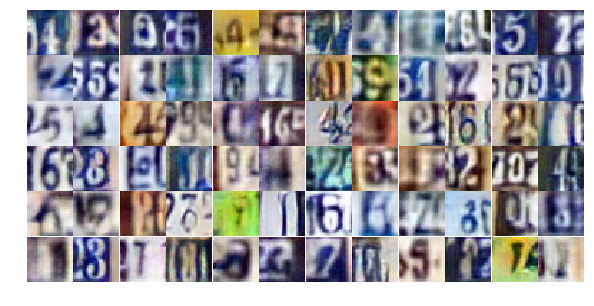

Epoch 6/15... Discriminator Loss: 1.3427... Generator Loss: 0.4756
Epoch 6/15... Discriminator Loss: 0.9101... Generator Loss: 0.8217
Epoch 6/15... Discriminator Loss: 1.8179... Generator Loss: 0.2751
Epoch 6/15... Discriminator Loss: 0.8837... Generator Loss: 0.7193
Epoch 6/15... Discriminator Loss: 1.1887... Generator Loss: 0.5980
Epoch 6/15... Discriminator Loss: 0.6518... Generator Loss: 1.0565
Epoch 6/15... Discriminator Loss: 0.5841... Generator Loss: 1.3167
Epoch 6/15... Discriminator Loss: 0.8289... Generator Loss: 0.8625
Epoch 6/15... Discriminator Loss: 0.9923... Generator Loss: 0.7177
Epoch 6/15... Discriminator Loss: 0.8724... Generator Loss: 0.8216


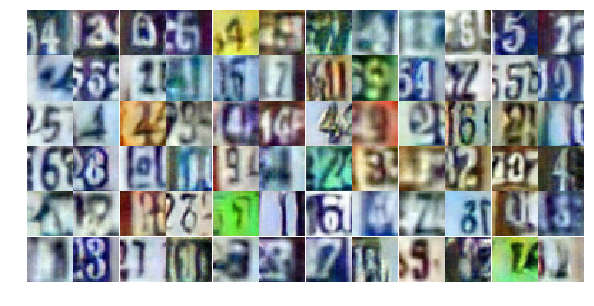

Epoch 6/15... Discriminator Loss: 0.6389... Generator Loss: 1.2908
Epoch 6/15... Discriminator Loss: 0.5519... Generator Loss: 1.2765
Epoch 6/15... Discriminator Loss: 0.6313... Generator Loss: 1.0125
Epoch 6/15... Discriminator Loss: 1.6462... Generator Loss: 0.3368
Epoch 6/15... Discriminator Loss: 1.1644... Generator Loss: 0.5668
Epoch 6/15... Discriminator Loss: 0.6602... Generator Loss: 1.1345
Epoch 6/15... Discriminator Loss: 0.4374... Generator Loss: 1.4473
Epoch 6/15... Discriminator Loss: 1.4642... Generator Loss: 0.3820
Epoch 6/15... Discriminator Loss: 0.8526... Generator Loss: 0.8004
Epoch 6/15... Discriminator Loss: 0.7693... Generator Loss: 0.8678


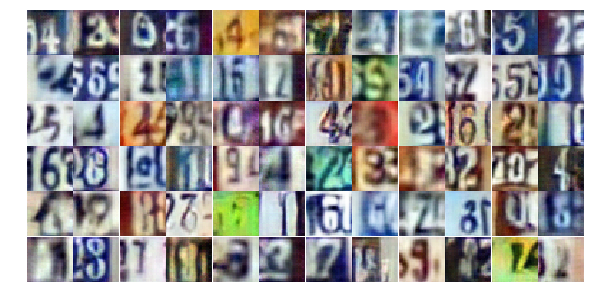

Epoch 6/15... Discriminator Loss: 0.4693... Generator Loss: 1.3783
Epoch 6/15... Discriminator Loss: 0.9055... Generator Loss: 0.7567
Epoch 6/15... Discriminator Loss: 0.6166... Generator Loss: 1.5356
Epoch 6/15... Discriminator Loss: 0.7561... Generator Loss: 1.2046
Epoch 6/15... Discriminator Loss: 0.9247... Generator Loss: 0.9109
Epoch 6/15... Discriminator Loss: 0.4338... Generator Loss: 1.8887
Epoch 6/15... Discriminator Loss: 0.5959... Generator Loss: 1.3340
Epoch 6/15... Discriminator Loss: 2.2358... Generator Loss: 0.2507
Epoch 6/15... Discriminator Loss: 0.8038... Generator Loss: 0.9890
Epoch 6/15... Discriminator Loss: 0.5260... Generator Loss: 1.3275


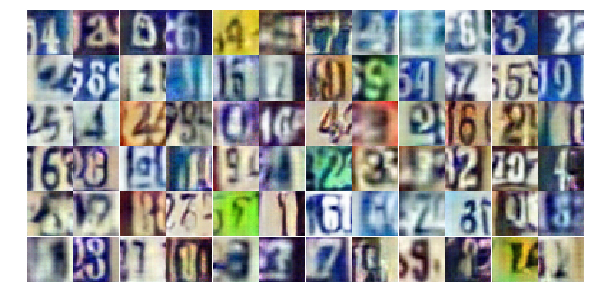

Epoch 6/15... Discriminator Loss: 1.6537... Generator Loss: 0.3424
Epoch 6/15... Discriminator Loss: 0.6563... Generator Loss: 1.1500
Epoch 6/15... Discriminator Loss: 0.7727... Generator Loss: 0.8710
Epoch 6/15... Discriminator Loss: 0.9324... Generator Loss: 0.6977
Epoch 6/15... Discriminator Loss: 1.1156... Generator Loss: 0.6459
Epoch 6/15... Discriminator Loss: 1.0143... Generator Loss: 0.6560
Epoch 6/15... Discriminator Loss: 0.5837... Generator Loss: 1.5498
Epoch 6/15... Discriminator Loss: 1.6010... Generator Loss: 0.3351
Epoch 6/15... Discriminator Loss: 0.6282... Generator Loss: 1.0925
Epoch 6/15... Discriminator Loss: 1.0181... Generator Loss: 0.7336


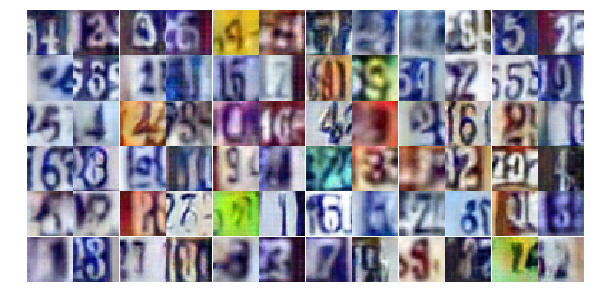

Epoch 6/15... Discriminator Loss: 0.8520... Generator Loss: 0.9606
Epoch 6/15... Discriminator Loss: 0.9372... Generator Loss: 0.7636
Epoch 6/15... Discriminator Loss: 0.8680... Generator Loss: 0.9696
Epoch 6/15... Discriminator Loss: 1.3085... Generator Loss: 0.4809
Epoch 6/15... Discriminator Loss: 0.8498... Generator Loss: 0.8914
Epoch 6/15... Discriminator Loss: 0.9022... Generator Loss: 0.7205
Epoch 6/15... Discriminator Loss: 0.8508... Generator Loss: 0.9113
Epoch 6/15... Discriminator Loss: 0.8682... Generator Loss: 0.7432
Epoch 6/15... Discriminator Loss: 0.8308... Generator Loss: 1.0826
Epoch 6/15... Discriminator Loss: 1.0332... Generator Loss: 0.5957


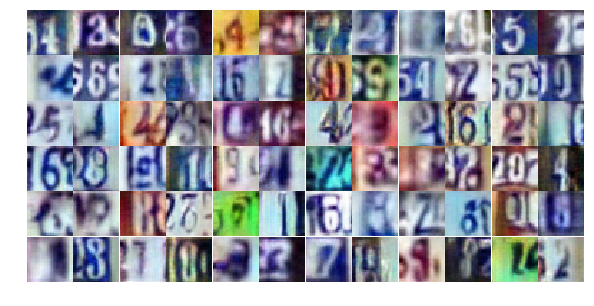

Epoch 6/15... Discriminator Loss: 0.7215... Generator Loss: 0.9463
Epoch 6/15... Discriminator Loss: 1.3810... Generator Loss: 0.3858
Epoch 6/15... Discriminator Loss: 0.7652... Generator Loss: 1.0890
Epoch 6/15... Discriminator Loss: 1.1557... Generator Loss: 0.5433
Epoch 6/15... Discriminator Loss: 0.8389... Generator Loss: 0.9263
Epoch 6/15... Discriminator Loss: 0.6772... Generator Loss: 1.0411
Epoch 6/15... Discriminator Loss: 1.1180... Generator Loss: 0.6532
Epoch 6/15... Discriminator Loss: 0.6025... Generator Loss: 1.5437
Epoch 6/15... Discriminator Loss: 0.8725... Generator Loss: 0.8135
Epoch 6/15... Discriminator Loss: 1.3647... Generator Loss: 2.1841


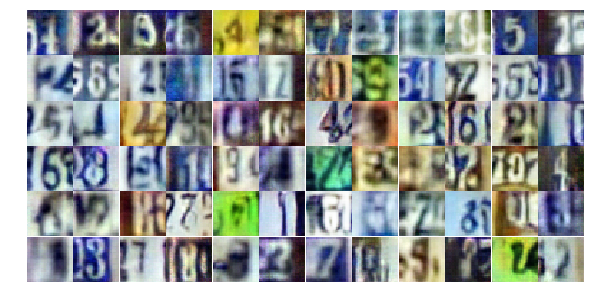

Epoch 6/15... Discriminator Loss: 1.8667... Generator Loss: 0.2647
Epoch 6/15... Discriminator Loss: 0.8179... Generator Loss: 0.7378
Epoch 6/15... Discriminator Loss: 1.4277... Generator Loss: 0.4802
Epoch 6/15... Discriminator Loss: 0.7419... Generator Loss: 1.1154
Epoch 6/15... Discriminator Loss: 1.4583... Generator Loss: 0.3810
Epoch 6/15... Discriminator Loss: 1.1494... Generator Loss: 0.5961
Epoch 6/15... Discriminator Loss: 1.6415... Generator Loss: 0.3409
Epoch 6/15... Discriminator Loss: 1.0194... Generator Loss: 0.8106
Epoch 6/15... Discriminator Loss: 0.9408... Generator Loss: 0.7837
Epoch 6/15... Discriminator Loss: 0.9216... Generator Loss: 0.7180


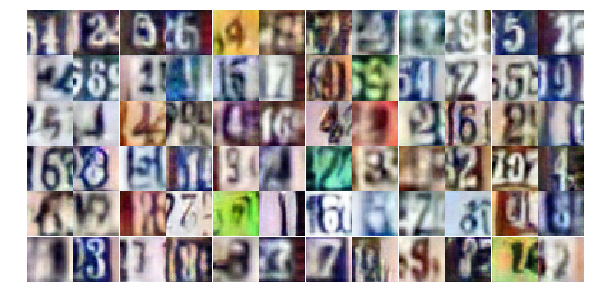

Epoch 6/15... Discriminator Loss: 0.7783... Generator Loss: 0.9359
Epoch 6/15... Discriminator Loss: 1.8659... Generator Loss: 0.2461
Epoch 6/15... Discriminator Loss: 1.2030... Generator Loss: 0.4523
Epoch 6/15... Discriminator Loss: 0.7446... Generator Loss: 0.8723
Epoch 6/15... Discriminator Loss: 1.0537... Generator Loss: 0.7355
Epoch 6/15... Discriminator Loss: 0.9441... Generator Loss: 0.6965
Epoch 6/15... Discriminator Loss: 0.5895... Generator Loss: 1.4882
Epoch 6/15... Discriminator Loss: 0.6016... Generator Loss: 1.1110
Epoch 6/15... Discriminator Loss: 0.6238... Generator Loss: 1.1310
Epoch 6/15... Discriminator Loss: 0.6393... Generator Loss: 1.3891


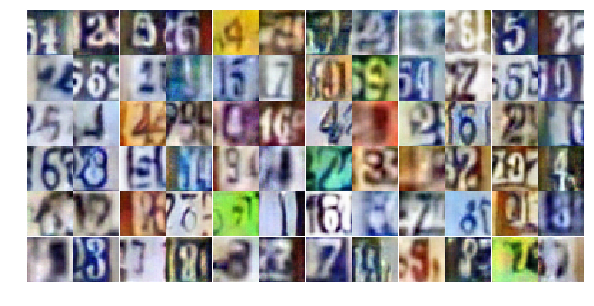

Epoch 6/15... Discriminator Loss: 1.0063... Generator Loss: 0.6582
Epoch 6/15... Discriminator Loss: 0.6928... Generator Loss: 1.0556
Epoch 6/15... Discriminator Loss: 1.3705... Generator Loss: 0.4529
Epoch 6/15... Discriminator Loss: 0.5633... Generator Loss: 1.2261
Epoch 6/15... Discriminator Loss: 0.8095... Generator Loss: 0.8960
Epoch 6/15... Discriminator Loss: 1.2204... Generator Loss: 0.4776


In [ ]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 64
epochs = 15
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)
dataset = Dataset(trainset, testset)
losses, samples = re_train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))